<a href="https://colab.research.google.com/github/DavidEmeryUofC/DavidEmeryUofC/blob/main/RockPhysicPlot.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Rocky Physics
Plot default rock physics solution for geophysical parameters

Written by [David Emery](https://www.linkedin.com/in/david-emery-54659a3a/)

In [1]:
# To supress warnings and deprecated messages
import warnings
warnings.filterwarnings("ignore")

# Core routines
import numpy as np
import pandas as pd
import math
import time

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt

## Load petrophysical files with mineral classes

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

# Setting up pointer to my google drive 
MYPATH = "/content/gdrive/MyDrive/MLPetrophysical/"
MODELPATH = "/content/gdrive/MyDrive/MLmodels/"

#filename = input('Enter the input.CSV file name ')
#if filename == '':
filename = MYPATH + 'NORTHSEAmergedData_LC_MC.csv'
filename2 = MYPATH + 'NZmergedData_MC.csv'

df1 = pd.read_csv(filename, delimiter=";")
df2 = pd.read_csv(filename2, delimiter=";")

frames = [df1, df2]

data = pd.concat(frames)

Mounted at /content/gdrive


In [3]:
data['DTC'][data.DTC >= 200] = np.nan

In [4]:
# Determine the number of well and display the result
Wells = data.WELL.unique()
print(f"There are {len(Wells)} wells in the file")

There are 256 wells in the file


In [5]:
data.RDEP = np.log(data.RDEP)
data.RMED = np.log(data.RMED)

In [6]:
Mineral = data.MINERAL_PRED.unique()
Mineral.sort()
Logs = ['GR_RES','RDEP_RES','RMED_RES','NPHI_RES','NPHI-DPHI','RHOB_RES','Vp_RES','Vs_RES','PEF_RES','SP']
for i in Mineral: 
  print(data[Logs][(data.TVD <= -1200) & (data.MINERAL_PRED == i)].describe())

             GR_RES      RDEP_RES      RMED_RES      NPHI_RES     NPHI-DPHI  \
count  23982.000000  23678.000000  22999.000000  23142.000000  22624.000000   
mean     -31.196365      0.374933      0.397561     -0.182393      0.074274   
std       13.481910      0.669353      0.606768      0.049828      0.104655   
min     -118.827199     -0.820623     -0.801353     -0.398775     -0.353872   
25%      -36.556877     -0.055397     -0.004755     -0.201796      0.011612   
50%      -29.941259      0.220803      0.261704     -0.178704      0.066764   
75%      -23.546058      0.610359      0.651788     -0.160184      0.126779   
max       64.726484      3.672233      3.675727      0.155517      0.591784   

           RHOB_RES        Vp_RES       Vs_RES       PEF_RES            SP  
count  23455.000000  23270.000000  3617.000000  10029.000000  19223.000000  
mean       0.006976    720.419522   490.493860      0.150987     -0.850566  
std        0.163728    647.355361   452.846128      1.020

## Default plot and colour properties

In [7]:
from matplotlib.colors import LinearSegmentedColormap
density_colors = ['white', 'lightgrey', 'skyblue', 'green', 'yellow', 'gold', 'darkorange', 'red', 'DarkRed', 'violet']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wbgr', density_colors))
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wbgr_trans', density_colors, gamma=np.linspace(1, 0, 256)))

# Colour map for displaying GR from yellow to grey 
gammaray_colors = ['salmon','yellow', 'lightgreen','lightgrey', 'silver','gray','slategrey']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('gr_color', gammaray_colors))

# Colour map for highlighting confusion matrix
confusion_colors = ['white', 'yellow', 'green', 'skyblue', 'blue']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('wygb', confusion_colors))

# Default figure size for use in Powerpoint
plt.rcParams['figure.figsize'] = (10, 7)
plt.rcParams['figure.dpi'] = 144

#from matplotlib.colors import ColorConverter
#color_with_alpha = ColorConverter.to_rgba('white', 0.5)
#fig.set_facecolor(color_with_alpha)

plt.tight_layout()

# Default font size
SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 14

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

<Figure size 1440x1008 with 0 Axes>

## Generic crossplot

In [8]:
def log_crossplot (x,y,nameX,nameY,cMap1='wbgr_trans',order=0, lplot=False, intercept=0.0, slope=1.0, pow=1, scaler=1, Title='',pline=False,lxaxis=[-1,0,1],lyaxis=[-1,0,1]):
    from sklearn.linear_model import LinearRegression
    from sklearn.preprocessing import PolynomialFeatures
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt   
    from sklearn.metrics import r2_score
    from sklearn.metrics import mean_squared_error

    # Remove nan point from input
    df = pd.DataFrame({nameX:x,nameY:y})
    df.dropna(axis=0,inplace=True)
    num_points = len(df)
    lineP = True
    
    # Create density plot
    heatmap, xedges, yedges = np.histogram2d(df[nameX], df[nameY], bins=250)
    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
    
    # Create trend line for data
    Xmin = np.percentile(df[nameX],2.5)
    Xmax = np.percentile(df[nameX],98.5)
    Xline = np.arange(Xmin,Xmax,(Xmax-Xmin)/100)
    Zline = intercept + slope*np.power((scaler * Xline),pow)
    
    model = LinearRegression()
    X = df[nameX].to_numpy()
    X = X.reshape(-1,1)
    Y = df[nameY].to_numpy()
    Y = Y.reshape(-1,1)
    
    # only will display relationships upto the 4th order 
    if order >= 2 :
        poly_reg = PolynomialFeatures(degree = order)
        X_poly = poly_reg.fit_transform(X,Y)
        model.fit(X_poly,Y)
        Yline = model.predict(poly_reg.fit_transform(Xline.reshape(-1,1)))
        r2 = model.score(X_poly,Y)
        intercept = model.intercept_
        parm = model.coef_
        if order == 2:
            ctext = str(str(round(float(intercept),2)) + ' + ' + str(round(float(parm[:,1]),3))
                    + '*X + ' +str(round(float(parm[:,2]),5)) + '*X2  r2=' + str(round(float(r2),2)))
        elif order == 3:
            ctext = str(str(round(float(intercept),2)) + ' + ' + str(round(float(parm[:,1]),3))
                    + '*X + ' +str(round(float(parm[:,2]),5)) + '*X2 + '
                    +  str(round(float(parm[:,3]),7)) + '*X3  r2=' + str(round(float(r2),2)))
        elif order == 4: 
            ctext = str(str(round(float(intercept),2)) + ' + ' + str(round(float(parm[:,1]),3))
                    + '*X + ' +str(round(float(parm[:,2]),5)) + '*X2 + '
                    + str(round(float(parm[:,3]),7)) + '*X3 + ' 
                    + str(round(float(parm[:,4]),9)) + '*X4  r2=' + str(round(float(r2),2)))
    elif order == 1:
        model.fit(X,Y)
        Yline = model.predict(Xline.reshape(-1,1))
        r2 = model.score(X,Y)
        intercept = model.intercept_
        parm = model.coef_
        ctext = str('intercept ' + str(round(float(intercept),2)) + ' slope ' +
                    str(round(float(parm),4)) + '  r2=' + str(round(float(r2),2)))
    else :
        lineP = False

    plt.figure(figsize = (10,7))        
    plt.title(Title +"Crossplot of " + nameX + ' and ' + nameY, fontsize=16)
    plt.grid(alpha=0.5)
    plt.xlim([np.percentile(df[nameX],0.01), np.percentile(df[nameX],99.9)])
    plt.ylim([np.percentile(df[nameY],0.01), np.percentile(df[nameY],99.9)])    
    plt.imshow(heatmap.T, extent=extent, origin='lower', cmap=cMap1, aspect='auto')
    if(pline):
        plt.scatter(lxaxis,lyaxis, c='grey', s =2) 
    if(lplot):
        plt.plot(Xline,Zline, c='blue', linestyle='dashed') 
    if(lineP):
        plt.plot(Xline,Yline, c='red')
#        plt.text(np.percentile(df[nameX],10),np.percentile(df[nameY],1),ctext)

    plt.xlabel(nameX)
    plt.ylabel(nameY)

    if nameX == "TVD": plt.xlim([-5500,0])
    if nameX == "Vp": plt.xlim([1500,5500])
    if nameX == "FAUST": plt.xlim([1500,5500])
    if nameX == "Vs": plt.xlim([500,3000])
    if nameX == "MUDROCK": plt.xlim([500,3000])
    if nameX == "DTC": plt.xlim([40,160])
    if nameX == "DTS": plt.xlim([100,500])
    if nameX == "VpVs": plt.xlim([1,5])
    if nameX == "RHOB": plt.xlim([1.8,3.0])
    if nameX == "GARDNER": plt.xlim([1.8,3.0])
    if nameX == "Ip": plt.xlim([3000,14000])
    if nameX == "DPHI": plt.xlim([0,0.50])
    if nameX == "NPHI": plt.xlim([0,0.60])
    if nameX == "RDEP": plt.xlim([-2,5])
    if nameX == "EPOR": plt.xlim([0,0.50])
    if nameX == "GR": plt.xlim([0,150])
    if nameX == "PEF": plt.xlim([0,6])
    if nameX == "LRho": plt.xlim([0,40])
    if nameX == "MuRho": plt.xlim([0,20])
    if nameX == "PR": plt.xlim([0.1,0.50])
    if nameX == "K": plt.xlim([0,70])
    if nameX == "SM": plt.xlim([0,35])
    if nameX == "INTERCEPT": plt.xlim([-0.1,0.1])
    if nameX == "GRADIENT": plt.xlim([-0.1,0.1])

    if nameY == "TVD": plt.ylim([-5500,0])
    if nameY == "Vp": plt.ylim([1500,5500])    
    if nameY == "FAUST": plt.ylim([1500,5500])
    if nameY == "Vs": plt.ylim([500,3000])
    if nameY == "DTC": plt.ylim([40,160])
    if nameY == "DTS": plt.ylim([100,500])
    if nameY == "MUDROCK": plt.ylim([500,3000])
    if nameY == "VpVs": plt.ylim([1,5])
    if nameY == "RHOB": plt.ylim([1.8,3.0])
    if nameY == "GARDNER": plt.ylim([1.8,3.0])
    if nameY == "Ip": plt.ylim([3000,14000])
    if nameY == "DPHI": plt.ylim([0,0.50])
    if nameY == "NPHI": plt.ylim([0,0.60])
    if nameY == "RDEP": plt.ylim([-2,5])
    if nameY == "EPOR": plt.ylim([0,0.50])
    if nameY == "GR": plt.ylim([0,150])
    if nameY == "PEF": plt.ylim([0,6])
    if nameY == "LRho": plt.ylim([0,40])
    if nameY == "MuRho": plt.ylim([0,20])
    if nameY == "PR": plt.ylim([0.1,0.50])
    if nameY == "K": plt.ylim([0,70])
    if nameY == "SM": plt.ylim([0,35])
    if nameY == "INTERCEPT": plt.ylim([-0.1,0.1])
    if nameY == "GRADIENT": plt.ylim([-0.1,0.1])
    plt.show()


##Create additional attributes

In [9]:
data['GARDNER'] = pow(data['Vp']/1000,0.25)*1.741
data['MUDROCK'] = (data['Vp'] - 1360)/1.16
data['Ip'] = data.Vp*data.RHOB
data['MuRho'] =np.power(data.Vs/1000,2)*data.RHOB
data['LRho'] = np.power(data.Vp/1000,2)*data.RHOB-2*np.power(data.Vs/1000,2)*data.RHOB

##Create additional attributes Bulk Modulus (K), Shear Modules (SM) & Poisson Ratio (PR)

In [10]:
data['K'] = data.RHOB * (np.power(data.Vp/1000,2) - 4/3*np.power(data.Vs/1000,2))
data['SM'] = data.RHOB*np.power(data.Vs/1000,2)
data['PR'] = (np.power(data.Vp/1000,2) - 2*np.power(data.Vs/1000,2))/(2*(np.power(data.Vp/1000,2) - np.power(data.Vs/1000,2)))
data['K_REL'] = data.GARDNER * (np.power(data.Vp/1000,2) - 4/3*np.power(data.MUDROCK/1000,2))
data['SM_REL'] = data.GARDNER*np.power(data.MUDROCK/1000,2)
data['Ip_REL'] = data.GARDNER * data.Vp
data['VpVs_REL'] = data.Vp / data.MUDROCK

In [11]:
from scipy.signal import medfilt

sampleRate = data.TVD.shift(1) - data.TVD
avgSR = np.nanmedian(sampleRate)
fm_size = 5
lfilter = np.int(fm_size/avgSR)
print("Filter length ",lfilter,' samples which represents ', fm_size,' meters')

data['VpAvg'] = medfilt(data.Vp,lfilter*4+1)
data['VpAvg2'] = medfilt(data.Vp,lfilter*2+1)
data['VpDiff'] = data.VpAvg2.shift(lfilter) - data.VpAvg2.shift(-lfilter)
data['VsAvg'] = medfilt(data.Vs,lfilter*4+1)
data['VsAvg2'] = medfilt(data.Vs,lfilter*2+1)
data['VsDiff'] = data.VsAvg2.shift(lfilter) - data.VsAvg2.shift(-lfilter)
data['RHOBAvg'] = medfilt(data.RHOB,lfilter*4+1)
data['RHOBAvg2'] = medfilt(data.RHOB,lfilter*2+1)
data['RHOBDiff'] = data.RHOBAvg2.shift(lfilter) - data.RHOBAvg2.shift(-lfilter)

data['INTERCEPT'] = 1/2*(data.VpDiff/data.VpAvg + data.RHOBDiff/data.RHOBAvg)
data.INTERCEPT[data.INTERCEPT >= 0.1] = np.nan
data.INTERCEPT[data.INTERCEPT <= -0.1] = np.nan
data['GRADIENT'] = np.nan
data['GRADIENT'][(data.Vp != np.nan) & (data.Vs != np.nan) & (data.RHOB != np.nan)] = 1/2*(data.VpDiff/data.VpAvg)-2*(np.power(data.VsAvg/1000,2)/np.power(data.VpAvg/1000,2))*(data.RHOBDiff/data.RHOBAvg + 2*data.VsDiff/data.VsAvg)
data.GRADIENT[data.GRADIENT >= 0.1] = np.nan
data.GRADIENT[data.GRADIENT <= -0.1] = np.nan

Filter length  33  samples which represents  5  meters


## Mineralogy Classes

In [12]:
# Create a new dictionary for the mineralogy lithology
mineral_numbers = {1: "Cal-SS", 2: "Sandstone", 3: "Silty-SS", 4: "Silty-Shale", 5: "Shale", 6: "Organic-Shale",
                   7: "Claystone", 8: "Marlstone", 9: "Calc-Shale",10: "Arg-Limestone", 11: "Limestone",12: "P-Limestone", 
                  13: "Dolomite", 14: "Anhydrite", 15: "Halite", 16: "Tuff", 17: "Coal", 18: "Basement" }
mineral_names = ["Cal-SS", "Sandstone", "Silty-SS", "Silty-Shale", "Shale", "Organic-Shale", 
                 "Claystone", "Marlstone", "Calc-Shale", "Arg-Limestone", "Limestone", "P-Limestone", 
                 "Dolomite", "Anhydrite", "Halite", "Tuff",  "Coal", "Basement","Unknown"]
mineral_colors = ['#EBEBAA','#FFFF64','#FFE17D','#D7C8B9','#C8C8C8','#A0B4A0',
                  '#e0dbd1','#D2D2EB','#96D2FF','#4BEBFF','#00FFEB','#C8FFEB',
                  '#C896FF','#FFEBFF','#96C850','#E1ACAC','#646464','#C84646','#C84646']
plt.register_cmap(cmap=LinearSegmentedColormap.from_list('mineral', mineral_colors))


In [13]:
data.MINERAL_PRED[(data.Facies >= 3) & (data.MINERAL_PRED <= 3)] = 18

In [14]:
mineral_legend = {1: {'lith':'Cal-SS',        'lith_num':1, 'hatch': '..', 'color':'#EBEBAA'},
                   2: {'lith':'Sandstone',    'lith_num':2, 'hatch': '.', 'color':'#FFFF64'},
                   3: {'lith':'Silty-SS',     'lith_num':3, 'hatch': '_.', 'color':'#FFE17D'},
                   4: {'lith':'Silty-Shale',  'lith_num':4, 'hatch':'-.',   'color':'#D7C8B9'},
                   5: {'lith':'Shale',        'lith_num':5, 'hatch':'-',   'color':'#C8C8C8'},
                   6: {'lith':'Organic-Shale','lith_num':6, 'hatch':'--',  'color':'#A0B4A0'},
                   7: {'lith':'Claystone',    'lith_num':7, 'hatch':'--',   'color':'#e0dbd1'},
                   8: {'lith':'Marlstone',    'lith_num':8,'hatch':'--',   'color':'#96D2FF'},
                   9: {'lith':'Calc-Shale',   'lith_num':9,'hatch':'-',   'color':'#D2D2EB'},
                  10: {'lith':'Arg-Limestone','lith_num':10,'hatch':'++',   'color':'#4BEBFF'},
                  11: {'lith':'Limestone',    'lith_num':11,'hatch':'+',   'color':'#00FFEB'},
                  12: {'lith':'P-Limestone',  'lith_num':12,'hatch':'+',   'color':'#C8FFEB'},
                  13: {'lith':'Dolomite',     'lith_num':13,'hatch':'-/',   'color':'#C896FF'},
                  14: {'lith':'Anhydrite',    'lith_num':14,'hatch':'*',   'color':'#FFEBFF'},
                  15: {'lith':'Halite',       'lith_num':15,'hatch':'X',   'color':'#96C850'},
                  16: {'lith':'Tuff',         'lith_num':16,'hatch':'\-',   'color':'#E1ACAC'},
                  17: {'lith':'Coal',         'lith_num':17, 'hatch':'--',   'color':'#646464'},
                  18: {'lith':'Basement',    'lith_num':18, 'hatch':'XX',    'color':'#C84646'}
}

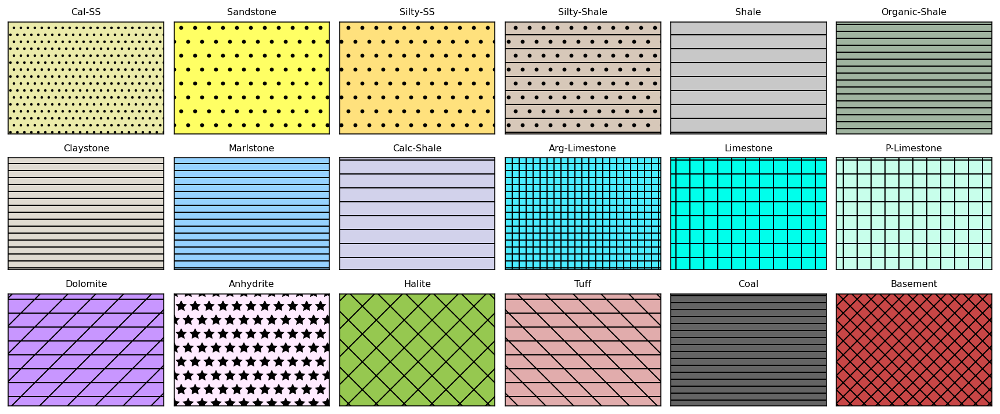

In [15]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=6,nrows=3, sharex=True, sharey=True,
                         figsize=(12,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, mineral_legend.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=mineral_legend[key]['color'], hatch=mineral_legend[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(mineral_legend[key]['lith']))

plt.tight_layout()

plt.show()

## Input Rock Properties

In [16]:
#Pvelocity = input('Enter the matrix P-velocity ')
#if Pvelocity == '': 
Pvelocity = 4300  
#else:
#  Pvelocity = float(Pvelocity)

#Svelocity = input('Enter the matrix shear velocity ')
#if Svelocity == '':
Svelocity = 2280
#else:
#  Svelocity = float(Svelocity)

#Density = input('Enter the matix density ')
#if Density == '':
Density = 2720
#else:
#  Density = float(Density)

#CriticalPorosity = input('Enter the Critical Porosity ')
#if CriticalPorosity == '':
CriticalPorosity = 0.5
#else:
#  CriticalPorosity = float(CriticalPorosity)

# Input lithology

In [17]:
Header = "Standard Mineralogy "
Lith1 = 1
Lith2 = 12
DPmin = -5500
DPmax = -0

In [18]:
Pvelocity = 4300
Svelocity = 2280
Density = 2720
CriticalPorosity = 0.5

In [19]:
print(Pvelocity,Svelocity,Pvelocity/Svelocity,Density,CriticalPorosity)

4300 2280 1.8859649122807018 2720 0.5


## background lines for plotting

Vp & RHOB Relationships

In [20]:
lineVp = np.arange(1500,5500,25)
lineGARDNER = pow(lineVp/1000,0.25)*1.741
lineMUDROCK = (lineVp - 1360)/1.16

lineMVpVs = lineVp/lineMUDROCK
lineMrhoE =np.power(lineMUDROCK/1000,2)*lineGARDNER
lineLrhoE = np.power(lineVp/1000,2)*lineGARDNER-2*np.power(lineMUDROCK/1000,2)*lineGARDNER

Create depth trends

In [21]:
lineDEPTH = -(lineVp-1500)/0.6625
lineGR = 63.16 - 0.0028 * lineDEPTH
lineRDEP = -0.25 - 0.0005 * lineDEPTH
lineNPHI = 0.6 + 0.00011 * lineDEPTH

##Determine the rock bulk modulus from input velocities

In [22]:
Kmineral = Density/1000*(math.pow(Pvelocity/1000,2)-4/3*math.pow(Svelocity/1000,2))
PoissonRatio = (math.pow(Pvelocity/1000,2)-2*math.pow(Svelocity/1000,2))/(2*(math.pow(Pvelocity/1000,2)-math.pow(Svelocity/1000,2)))
LambConstant = Density*math.pow(Svelocity/1000,2)/1000
LambKpoisson = 3*Kmineral/2*(1-2*PoissonRatio)/(1+PoissonRatio)
ShearModulus = (LambConstant + LambKpoisson)/2
print('Kma',np.round(Kmineral,1), 'PR', np.round(PoissonRatio,3),'\u03BC', np.round(ShearModulus,1))


Kma 31.4 PR 0.304 μ 14.1


Porosity Relationship

In [23]:
porosity = np.arange(0.005,1,0.005)
SLwaterDensity = 1.100
Kfluid = 1.64
Rdensity = (Density*(1-porosity) + SLwaterDensity*(porosity))
PRporosity = PoissonRatio*(1-porosity) + 0.5*(porosity)

## Default plots and relationhsip lines

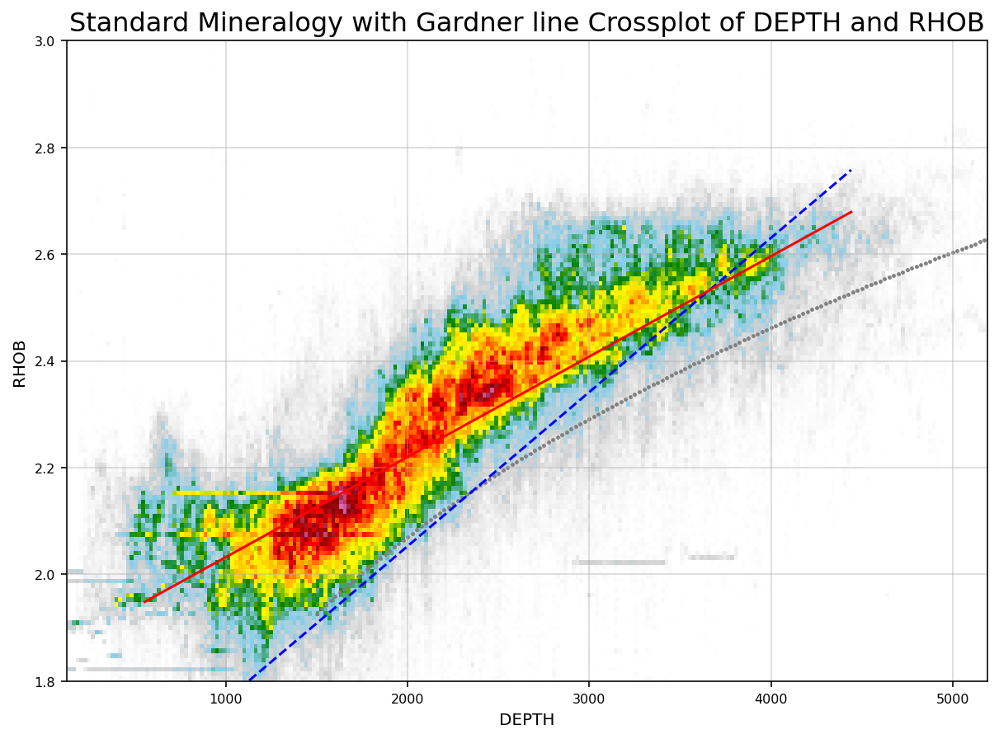

In [24]:
nameX = 'DEPTH'
nameY = 'RHOB'
pInt = 1.475
pSlope = 0.65/2250
shift = 0
lineRHOB = pInt + pSlope*lineVp
lineDPHI = (2.72 - lineRHOB)/(2.72-SLwaterDensity)
lineDPHIss = (2.65 - lineRHOB)/(2.65-SLwaterDensity)
lineIp = lineVp*lineRHOB
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=1,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Gardner line ',
                  pline=True,lxaxis=lineVp,lyaxis=lineGARDNER)

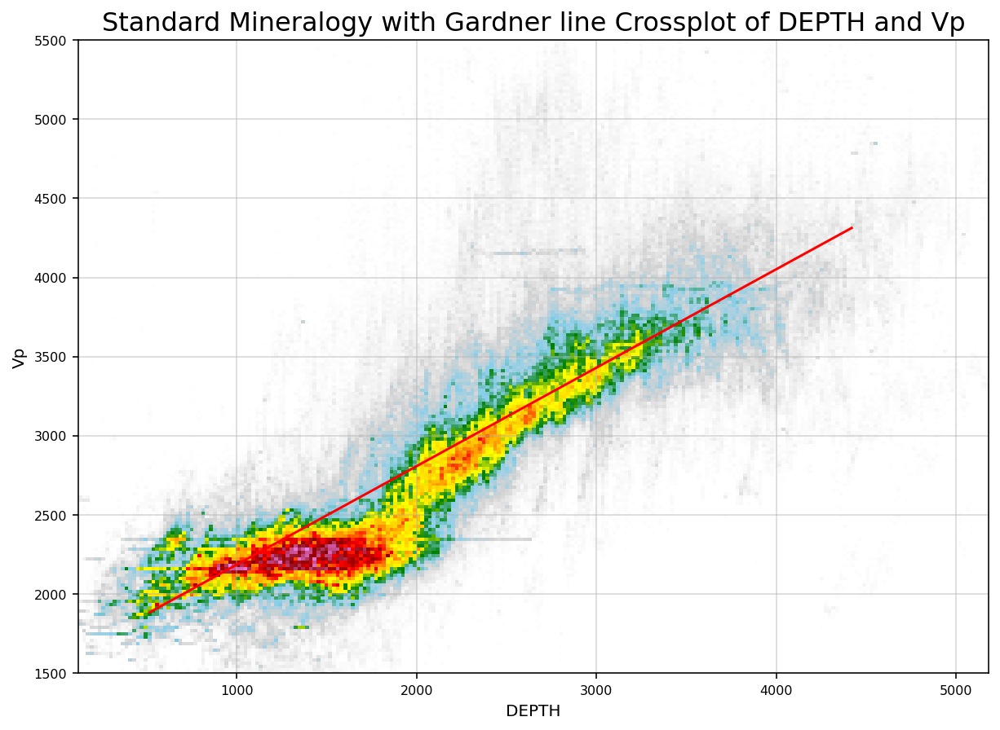

In [25]:
nameX = 'DEPTH'
nameY = 'Vp'
pInt = 1.475
pSlope = 0.65/2250
shift = 0
lineRHOB = pInt + pSlope*lineVp
lineDPHI = (2.72 - lineRHOB)/(2.72-SLwaterDensity)
lineDPHIss = (2.65 - lineRHOB)/(2.65-SLwaterDensity)
lineIp = lineVp*lineRHOB
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=1,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Gardner line ',
                  pline=True,lxaxis=lineVp,lyaxis=lineGARDNER)

###Create lineRHOB from Vp then lineIp & lineDPHI

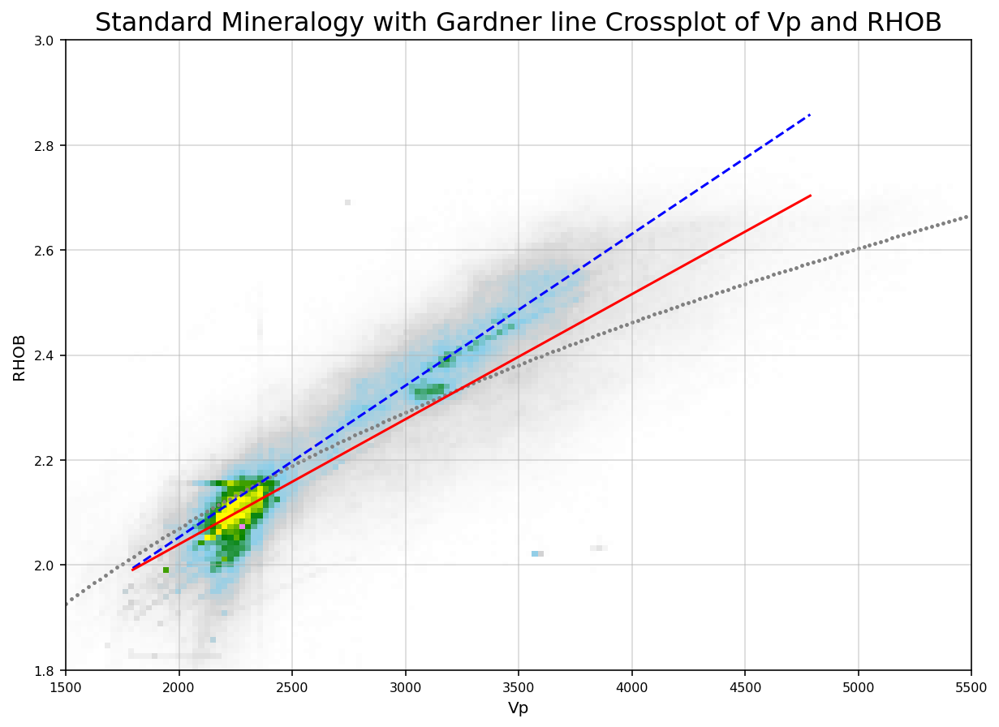

In [26]:
nameX = 'Vp'
nameY = 'RHOB'
pInt = 1.475
pSlope = 0.65/2250
shift = 0
lineRHOB = pInt + pSlope*lineVp
lineDPHI = (2.72 - lineRHOB)/(2.72-SLwaterDensity)
lineDPHIss = (2.65 - lineRHOB)/(2.65-SLwaterDensity)
lineIp = lineVp*lineRHOB
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)&  (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=1,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Gardner line ',
                  pline=True,lxaxis=lineVp,lyaxis=lineGARDNER)

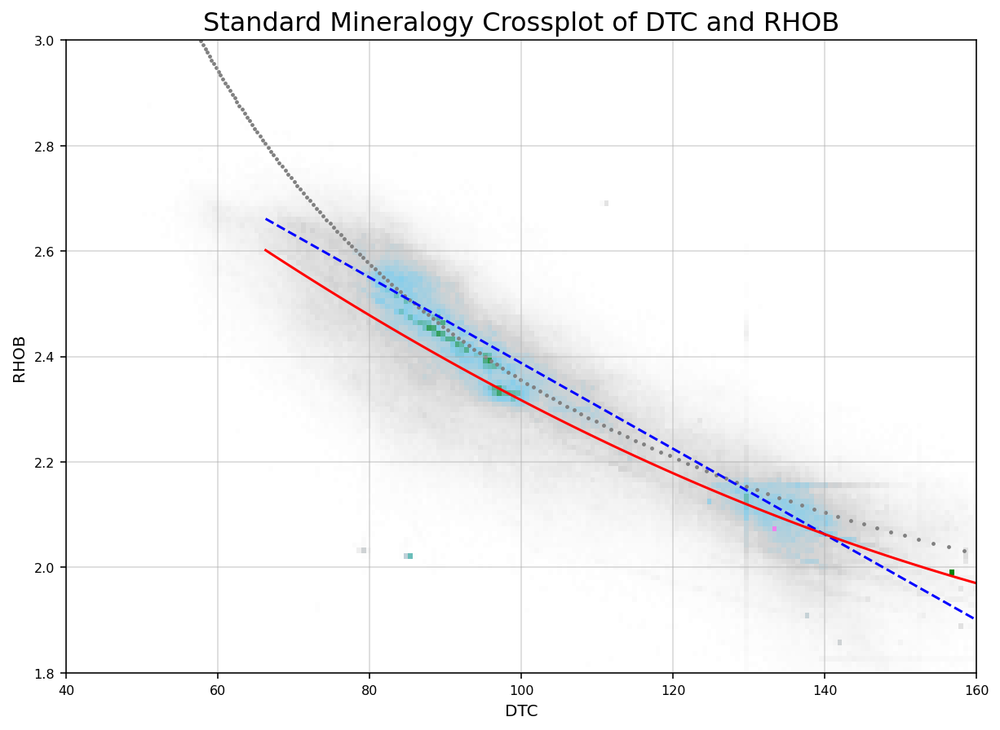

In [27]:
nameX = 'DTC'
nameY = 'RHOB'
pInt = 3.2
pSlope = -0.65/80
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)],
                  nameX,nameY,order=2,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=1000000/(3.2808*lineVp),lyaxis=lineRHOB)

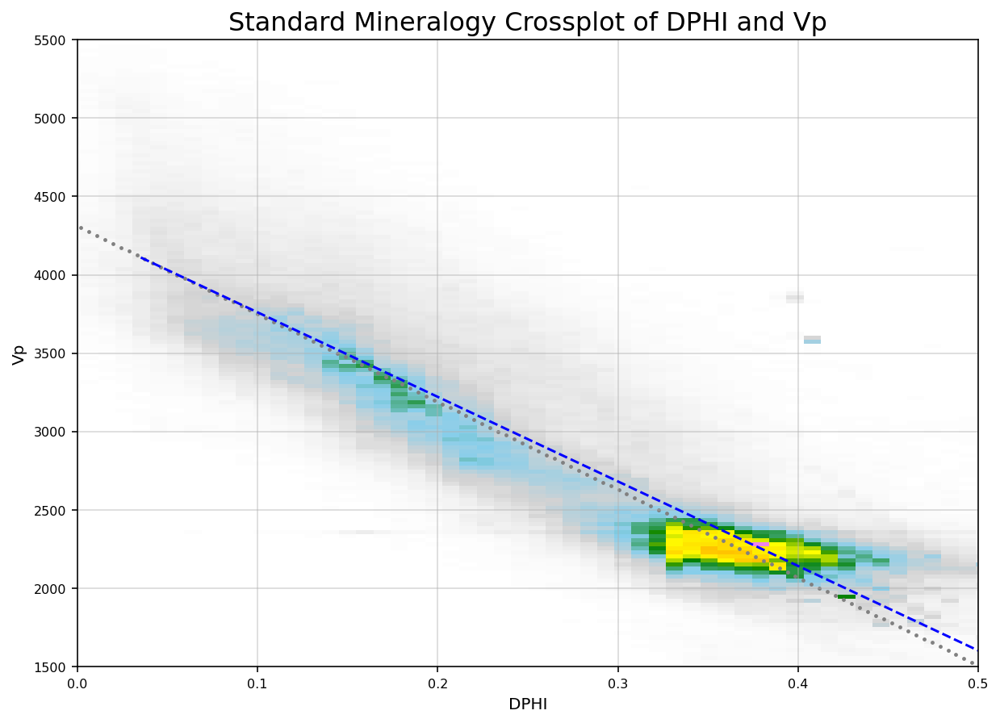

In [28]:
nameX = 'DPHI'
nameY = 'Vp'
pInt = Pvelocity
pSlope = (1600-Pvelocity)/CriticalPorosity
shift = 0
linePOR = (lineVp - pInt)/pSlope
VpPor = pInt + pSlope*porosity
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
               pline=True,lxaxis=lineDPHI,lyaxis=lineVp)

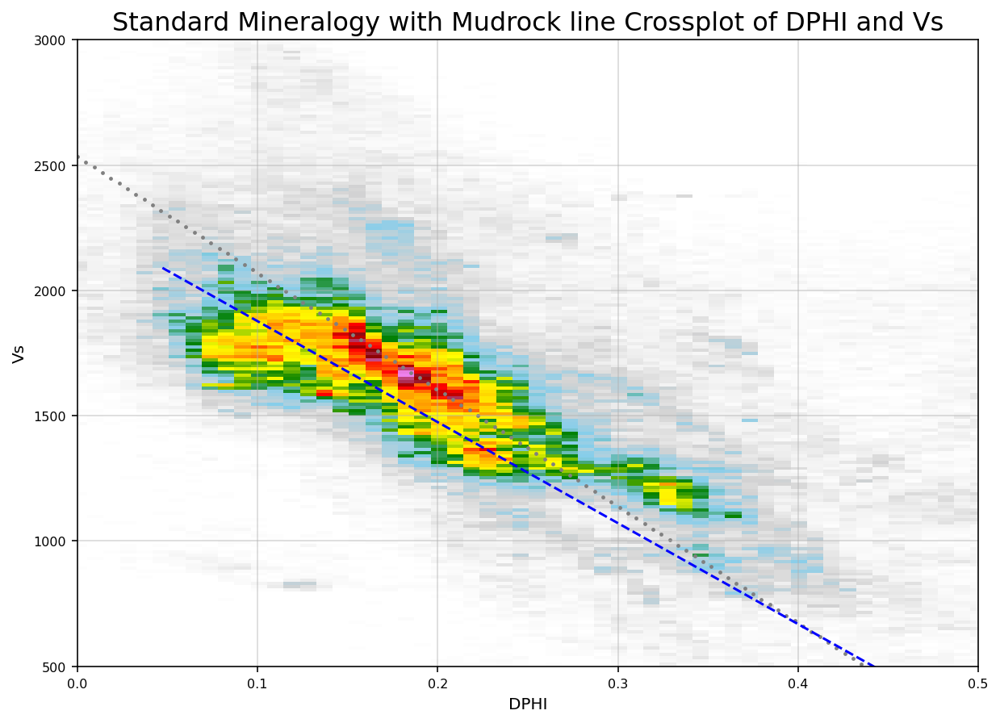

In [29]:
nameX = 'DPHI'
nameY = 'Vs'
pInt = Svelocity
pSlope = (265-Svelocity)/CriticalPorosity
shift = 0
VsPor = pInt + pSlope*porosity
log_crossplot(data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Mudrock line ',
                              pline=True,lxaxis=linePOR,lyaxis=lineMUDROCK)

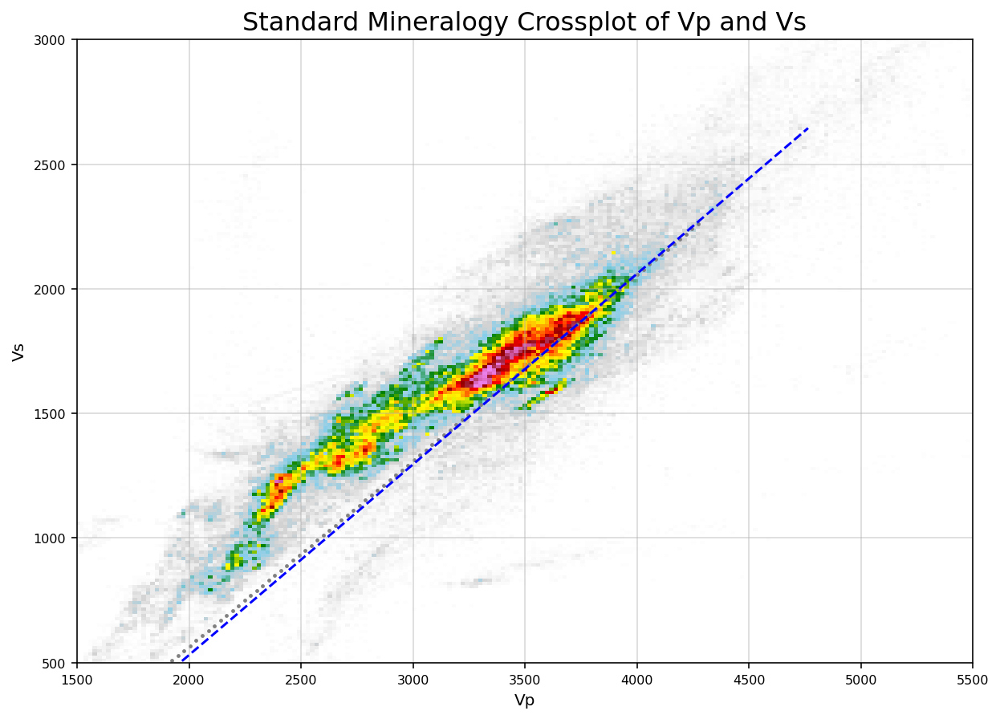

In [30]:
nameX = 'Vp'
nameY = 'Vs'
pInt = -1000
pSlope = 765/1000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=VpPor,lyaxis=VsPor)

###Create Vs line from Vp and then PR from Vp & Vs

In [31]:
lineVs = pInt + pSlope*lineVp
lineVpVs = lineVp/lineVs

###Create K, SM, PR lines from Vp, Vs & RHOB

In [32]:
lineK = lineRHOB * (np.power(lineVp/1000,2) - 4/3*np.power(lineVs/1000,2))
lineK_MG = lineGARDNER * (np.power(lineVp/1000,2) - 4/3*np.power(lineMUDROCK/1000,2))
lineSM = lineRHOB*np.power(lineVs/1000,2)
lineSM_MG = lineGARDNER*np.power(lineMUDROCK/1000,2)
linePR = (np.power(lineVp/1000,2) - 2*np.power(lineVs/1000,2))/(2*(np.power(lineVp/1000,2) - np.power(lineVs/1000,2)))
linePR_MG = (np.power(lineVp/1000,2) - 2*np.power(lineMUDROCK/1000,2))/(2*(np.power(lineVp/1000,2) - np.power(lineMUDROCK/1000,2)))

###Create Lrho & Mrho lines from Vp, Vs and RHOB

In [33]:
lineMrho =np.power(lineVs/1000,2)*lineRHOB
lineLrho = np.power(lineVp/1000,2)*lineRHOB-2*np.power(lineVs/1000,2)*lineRHOB


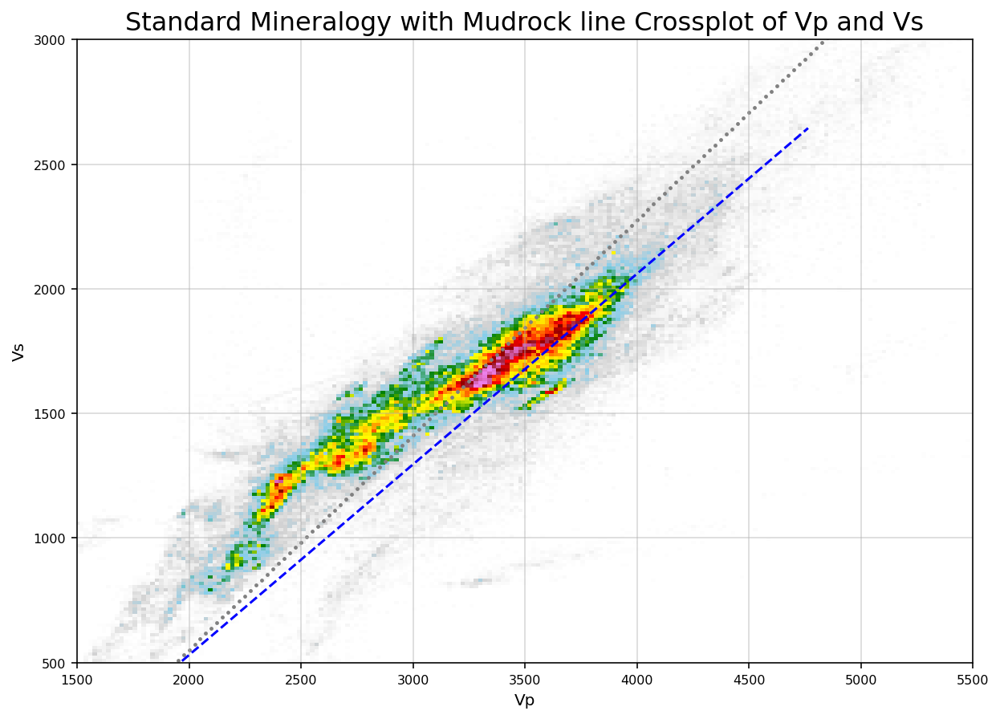

In [34]:
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Mudrock line ',
                  pline=True,lxaxis=lineVp,lyaxis=lineMUDROCK)

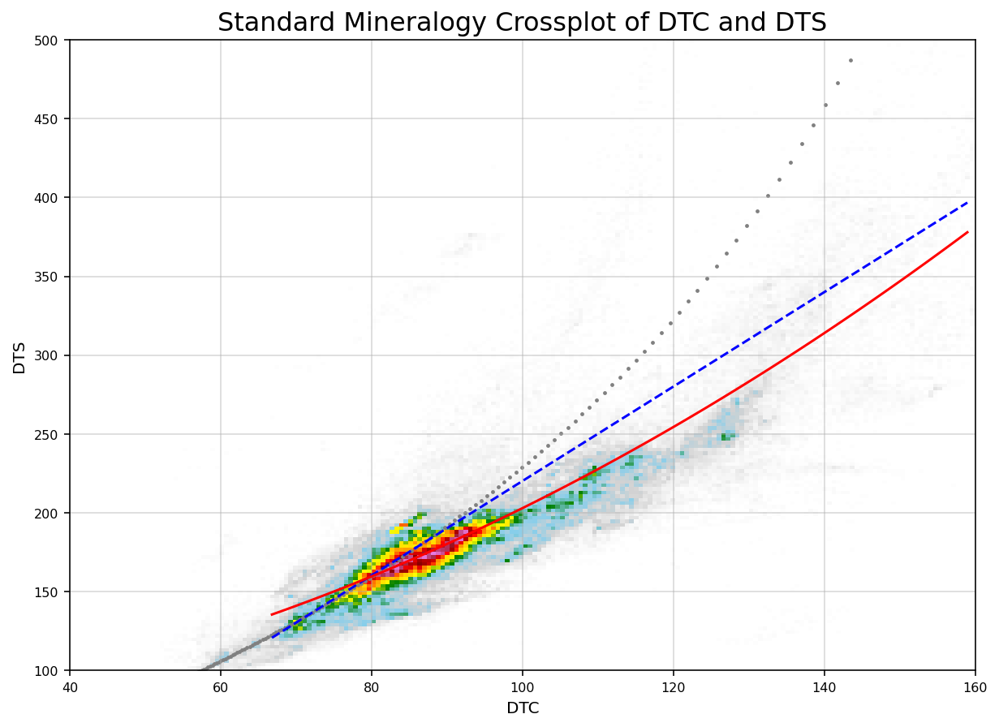

In [35]:
nameX = 'DTC'
nameY = 'DTS'
pInt = -80
pSlope = 60/20
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=2,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=1000000/(3.2808*lineVp),lyaxis=1000000/(3.2808*lineVs))

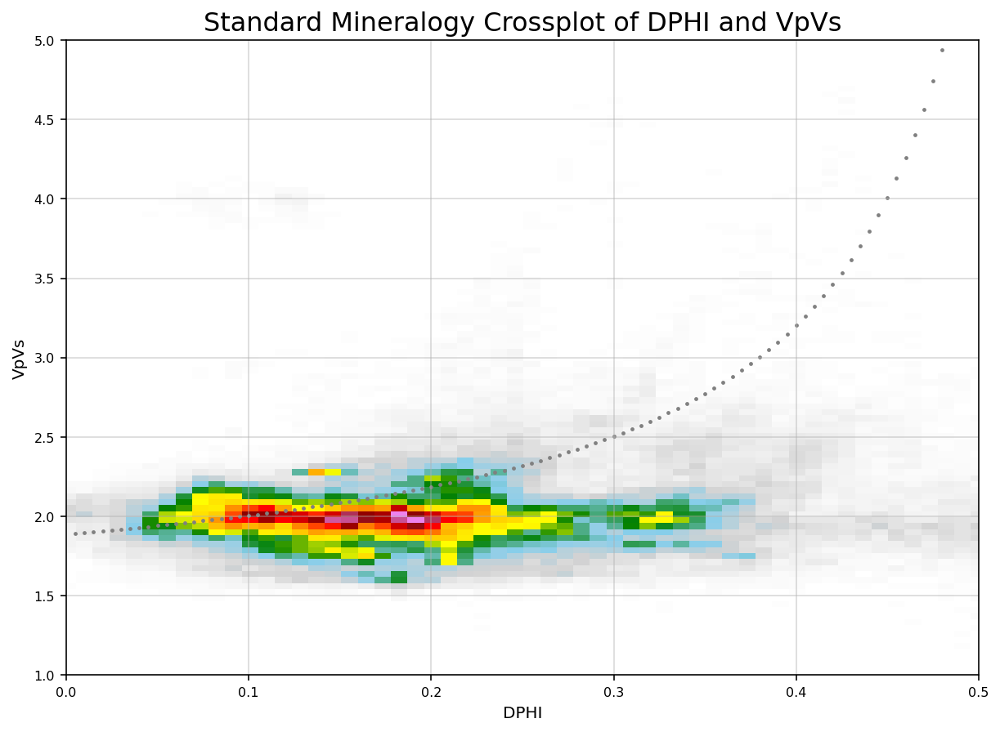

In [36]:
data.VpVs = data.Vp/data.Vs
nameX = 'DPHI'
nameY = 'VpVs'
pInt = Pvelocity/Svelocity
pSlope = (265-Svelocity)/CriticalPorosity
shift = 0
VpVsPor = VpPor/VsPor
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=porosity,lyaxis=VpVsPor)

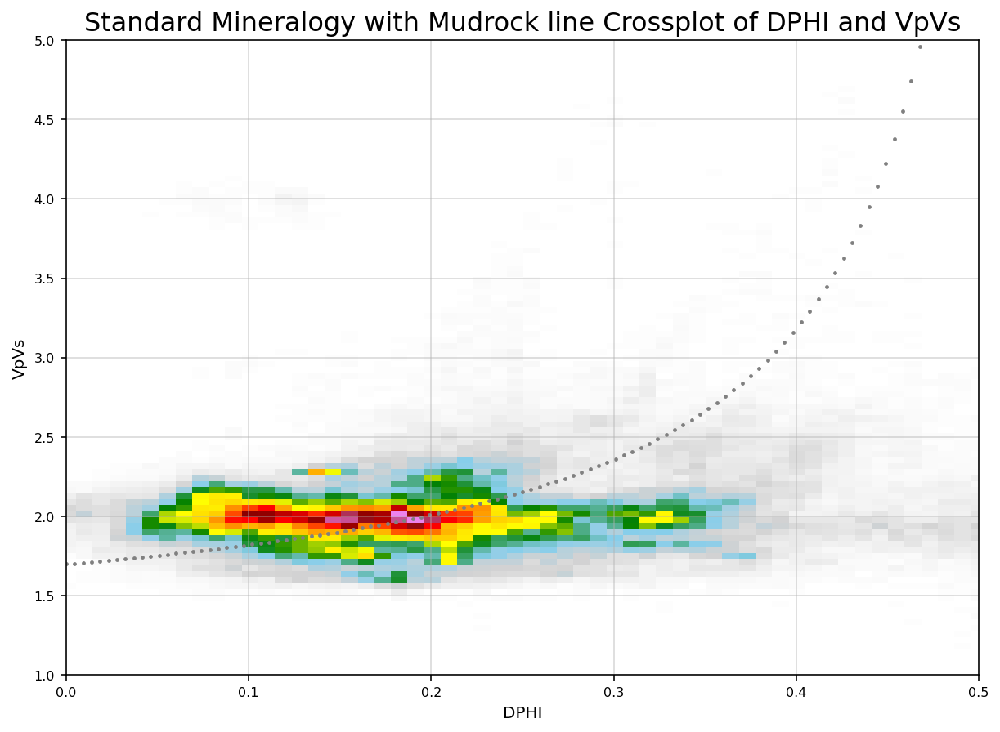

In [37]:
nameX = 'DPHI'
nameY = 'VpVs'
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Mudrock line ',
                  pline=True,lxaxis=linePOR,lyaxis=lineVp/lineMUDROCK)

###Petrophysical Crossplots

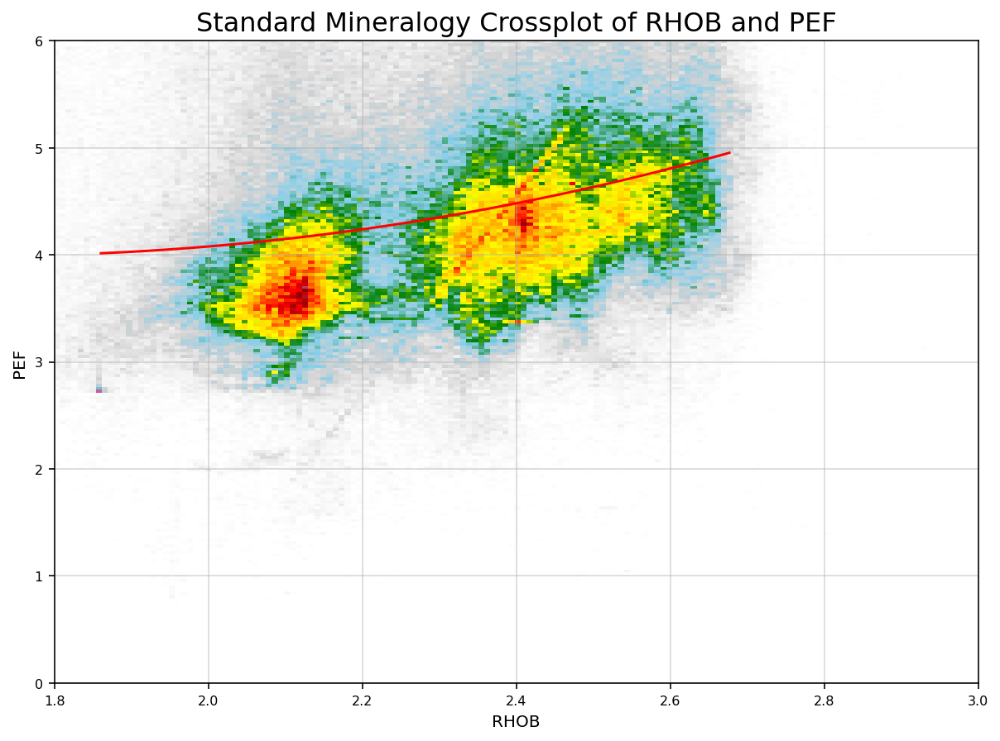

In [38]:
nameX = 'RHOB'
nameY = 'PEF'
pInt = -80
pSlope = 60/20
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=2,lplot=False,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=False,lxaxis=1000000/(3.2808*lineVp),lyaxis=1000000/(3.2808*lineVs))

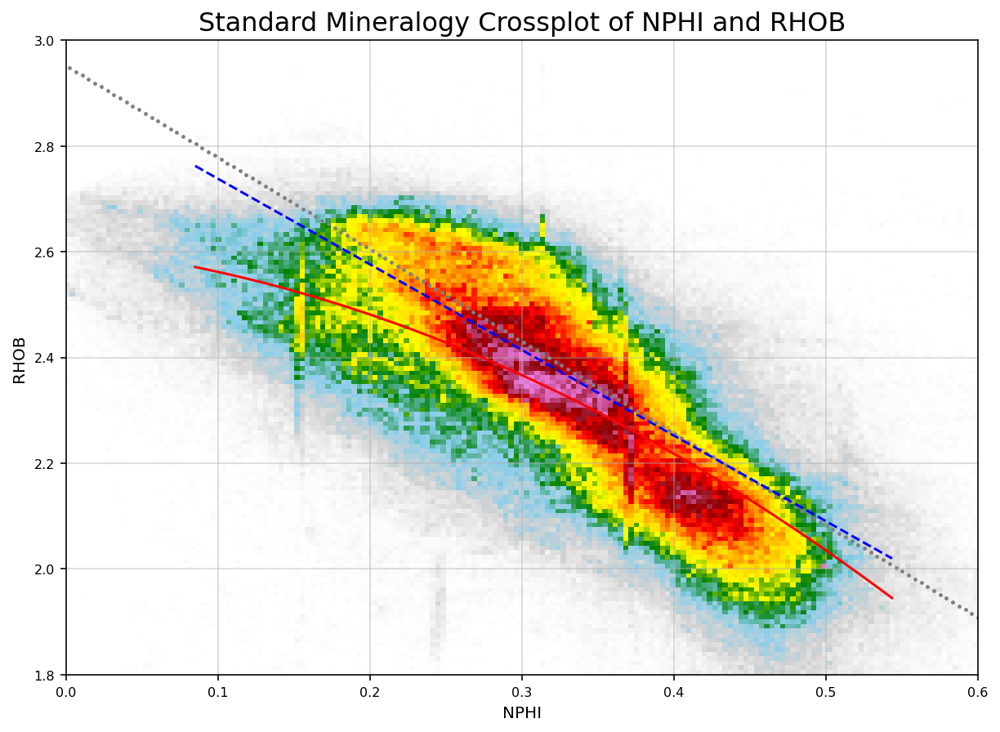

In [39]:
nameX = 'NPHI'
nameY = 'RHOB'
pInt = 2.9
pSlope = -(2.72-1.1)/1
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=2,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineNPHI,lyaxis=lineRHOB)

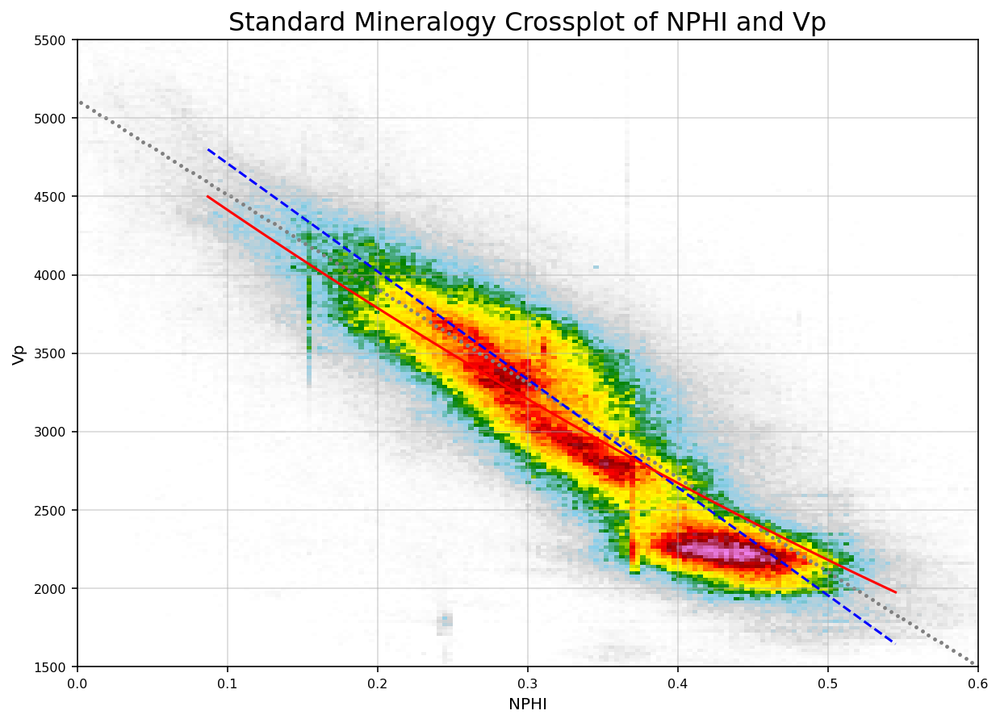

In [40]:
nameX = 'NPHI'
nameY = 'Vp'
pInt = 5400
pSlope = -1000/.145
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=2,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineNPHI,lyaxis=lineVp)

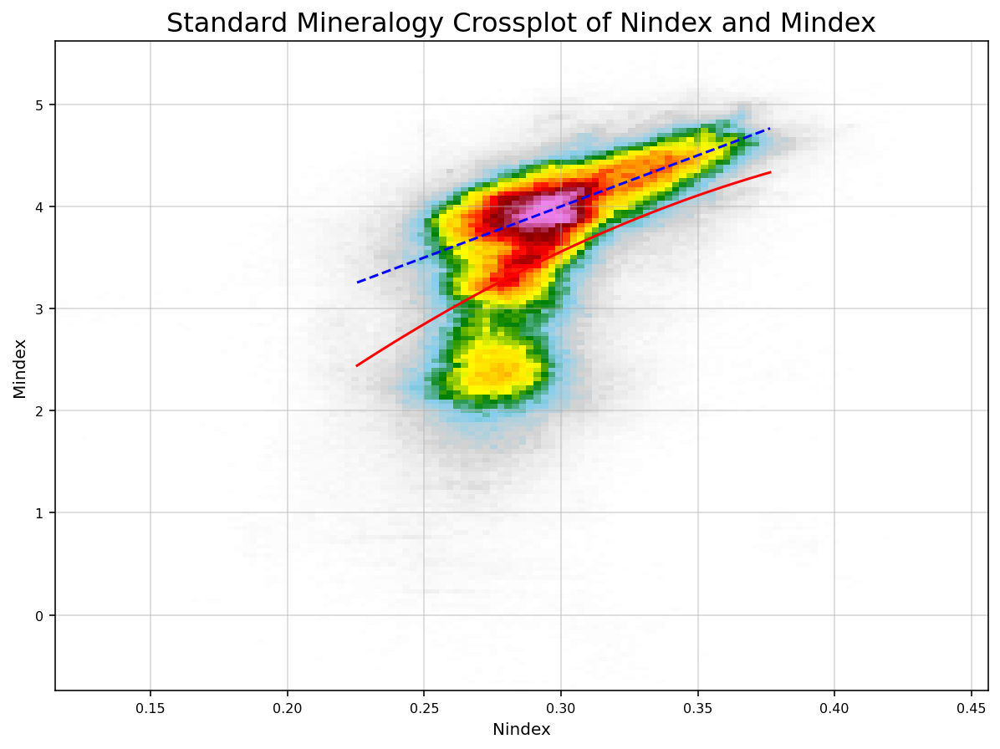

In [41]:
data['Mindex'] = (185-data.DTC)/(data.RHOB)*0.1
data['Nindex'] = (1-data.NPHI)/(data.RHOB)
nameX = 'Nindex'
nameY = 'Mindex'
pInt = 1
pSlope = 10
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=2,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=False,lxaxis=lineNPHI,lyaxis=lineVp)

In [42]:
data.Mindex.describe()

count    4.533573e+06
mean     3.279945e+00
std      1.037093e+00
min     -1.335086e+00
25%      2.532505e+00
50%      3.523889e+00
75%      4.044103e+00
max      1.253339e+01
Name: Mindex, dtype: float64

## Geophysical Crossplots

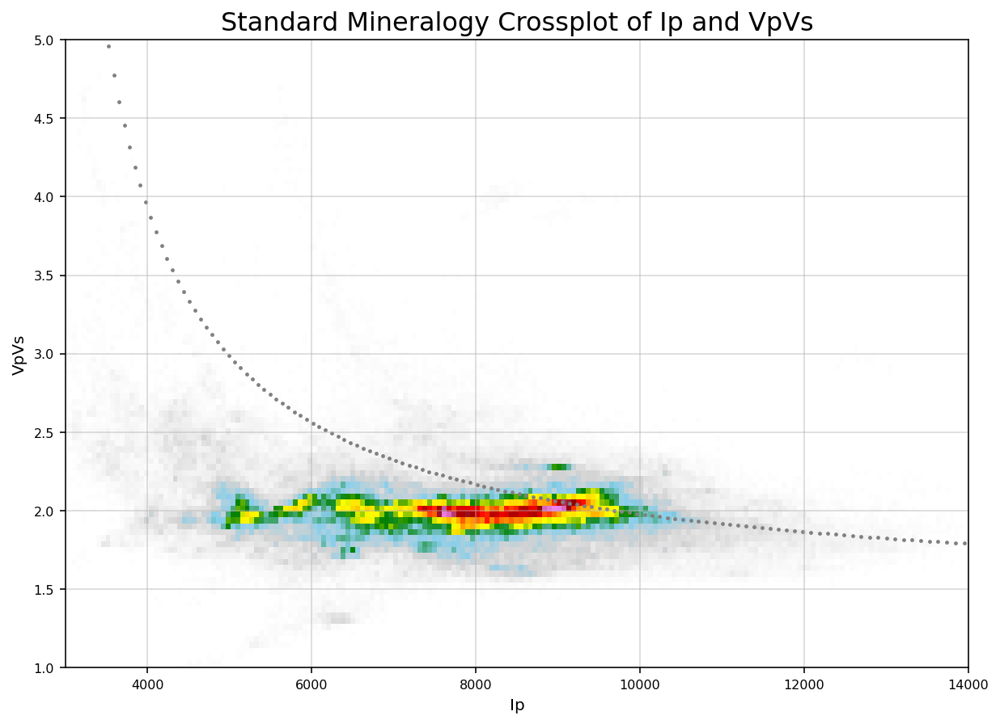

In [43]:

nameX = 'Ip'
nameY = 'VpVs'
pInt = 3
pSlope = -.5/5000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=False,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineVp*lineRHOB,lyaxis=lineVpVs)

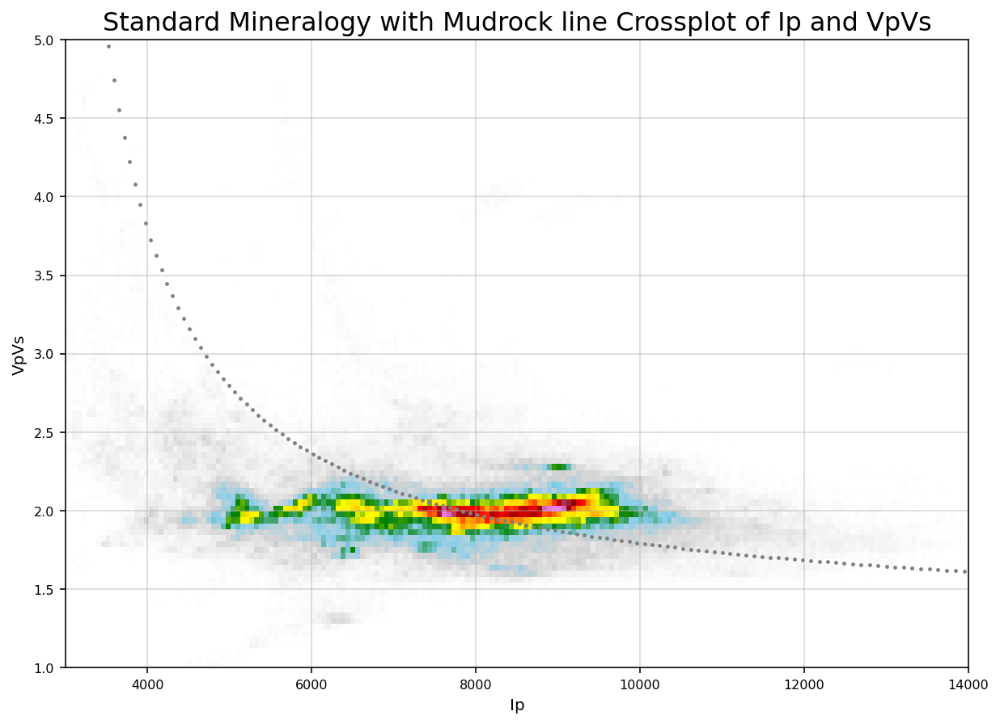

In [44]:
nameX = 'Ip'
nameY = 'VpVs'
pInt = 3
pSlope = -.5/5000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=False,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Mudrock line ',
                  pline=True,lxaxis=lineVp*lineRHOB,lyaxis=lineVp/lineMUDROCK)

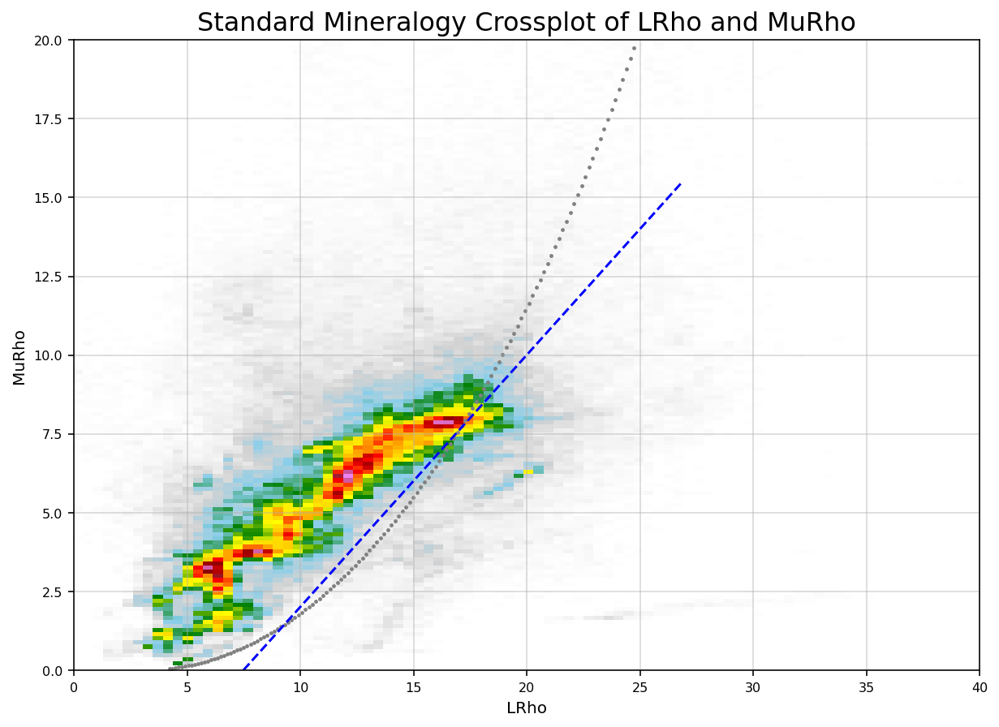

In [45]:
nameX = 'LRho'
nameY = 'MuRho'
pInt = -6
pSlope = 4/5
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineLrho,lyaxis=lineMrho)

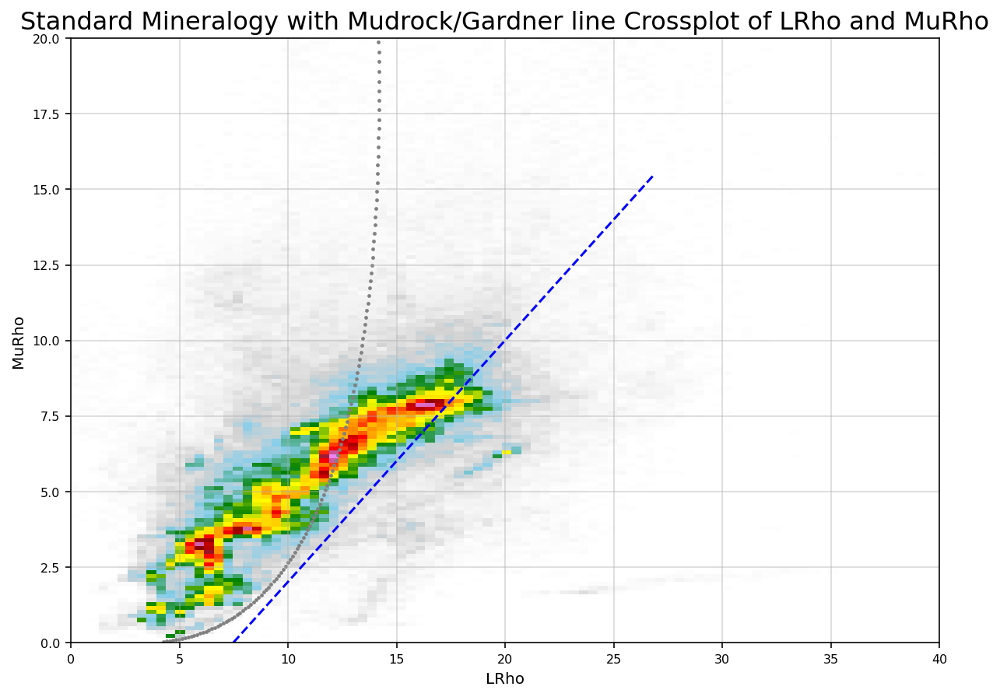

In [46]:
nameX = 'LRho'
nameY = 'MuRho'
pInt = -6
pSlope = 4/5
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Mudrock/Gardner line ',
                  pline=True,lxaxis=lineLrhoE,lyaxis=lineMrhoE)

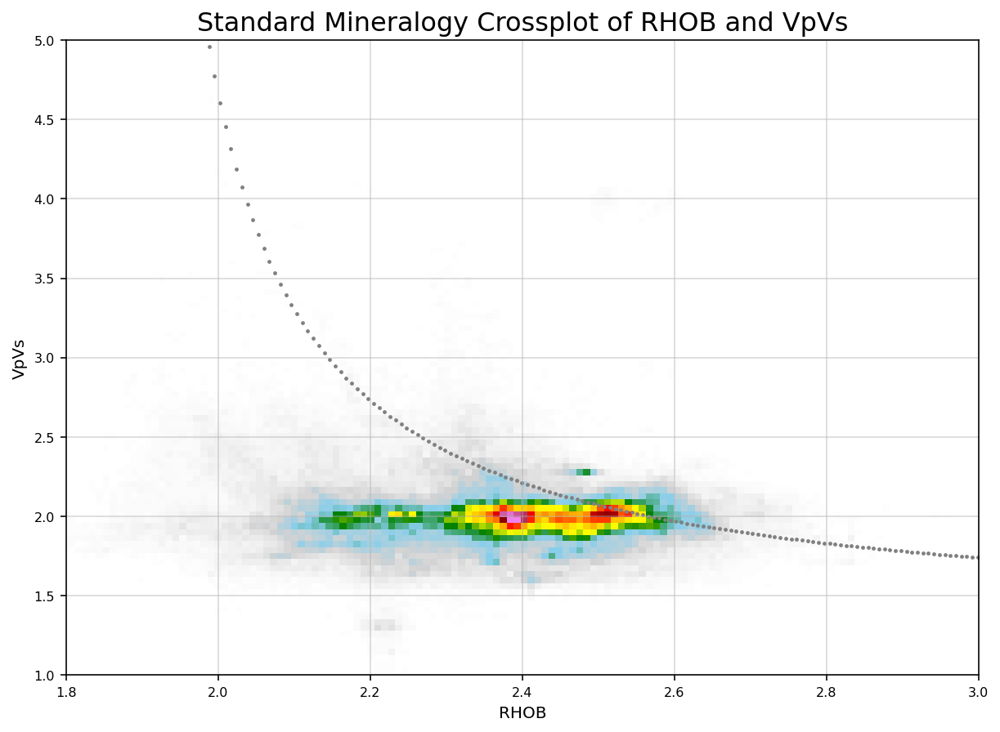

In [47]:
nameX = 'RHOB'
nameY = 'VpVs'
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineRHOB,lyaxis=lineVpVs)

##Vp, Vs & RHOB against Depth (TVD)

inf
-0.6625


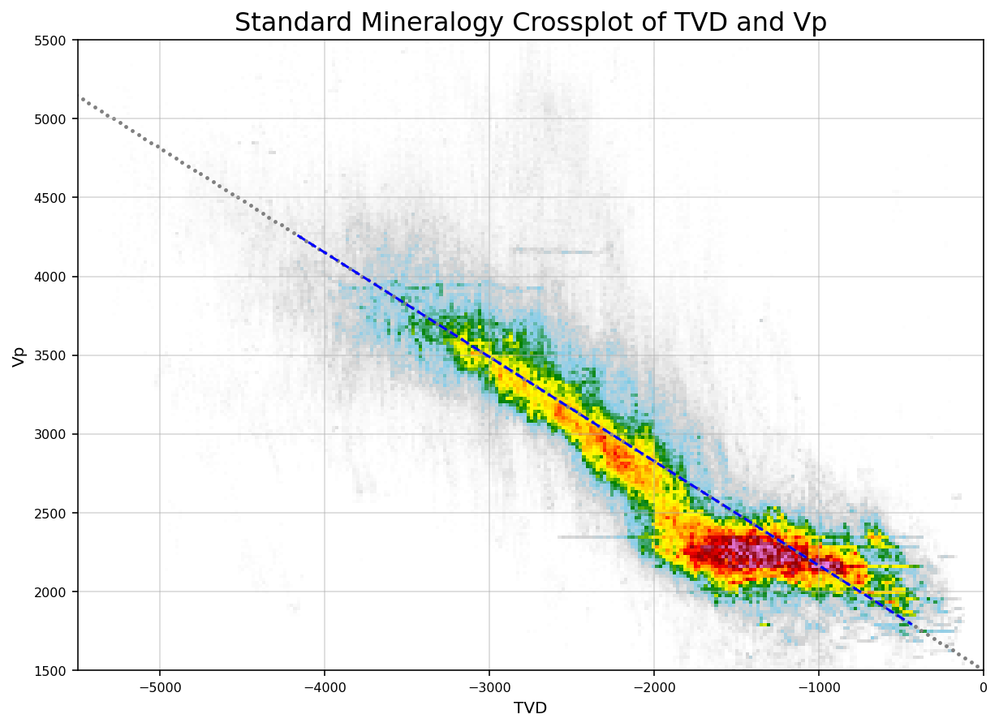

In [48]:
nameX = 'TVD'
nameY = 'Vp'
pInt = 1500
pSlope = np.average(lineVp/lineDEPTH)
print(pSlope)
pSlope = -(4150-pInt)/4000
print(pSlope)
shift = 0
#lineDEPTH2 = (lineVp - pInt)/pSlope
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=lineVp)

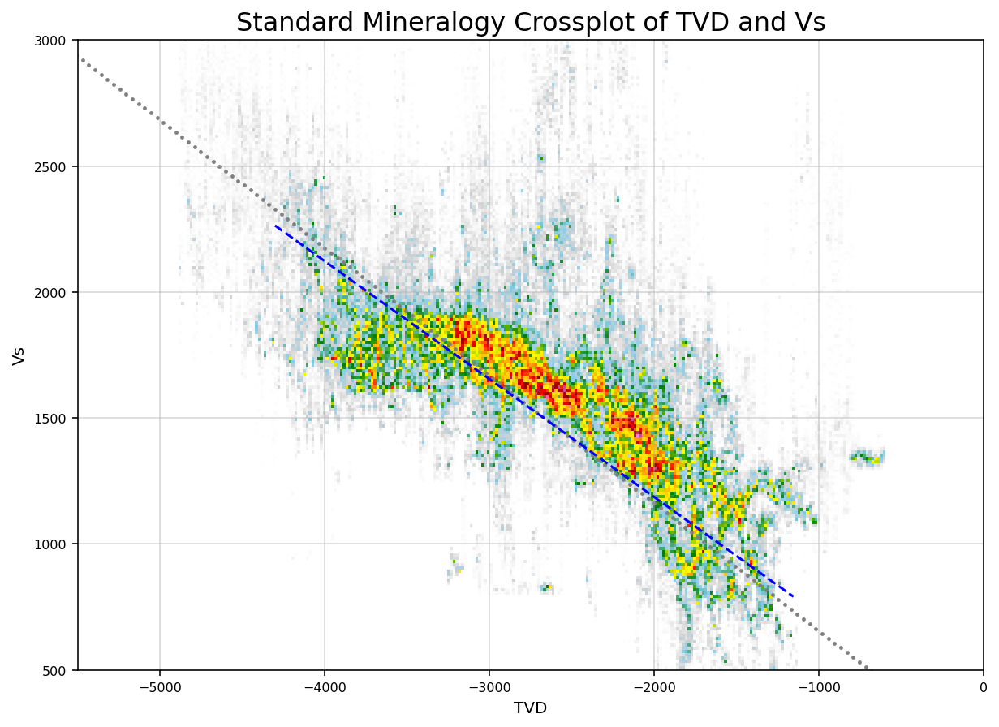

In [49]:
nameX = 'TVD'
nameY = 'Vs'
pInt = 250
pSlope = -.468
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=lineVs)

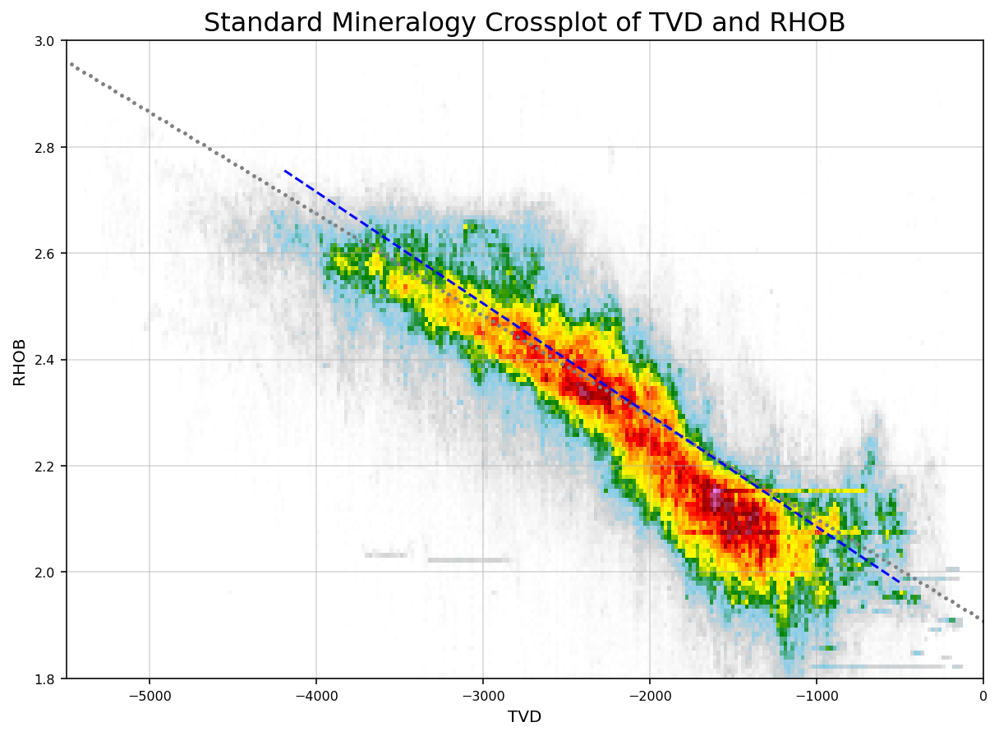

In [50]:
nameX = 'TVD'
nameY = 'RHOB'
pInt = 1.875
pSlope = -0.21/1000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=lineRHOB)

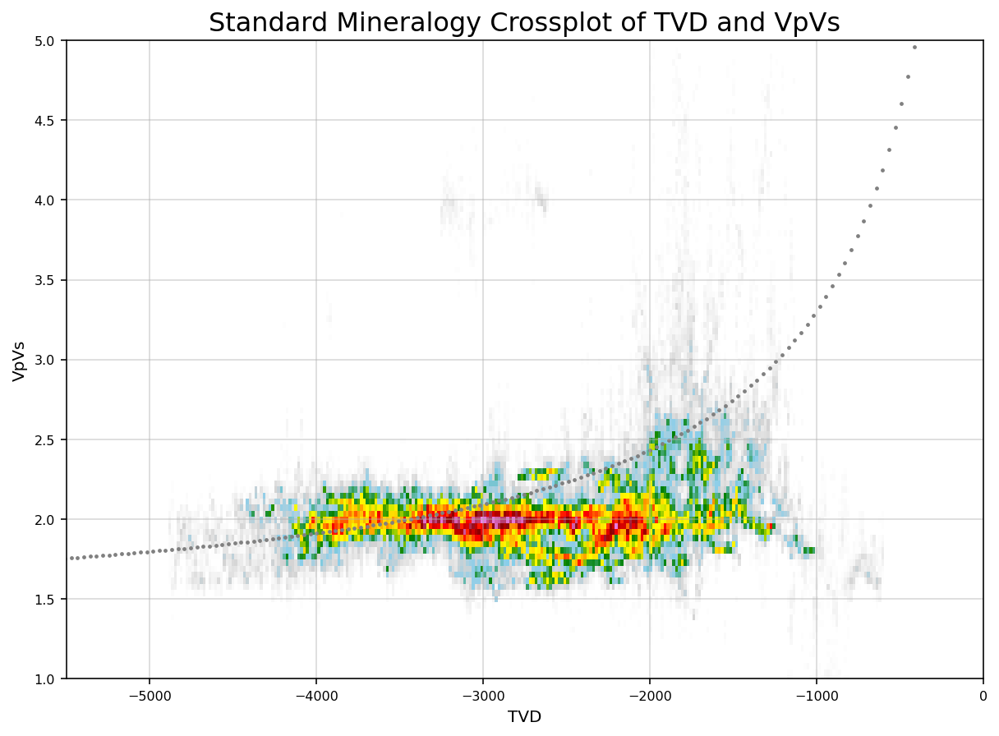

In [51]:
nameX = 'TVD'
nameY = 'VpVs'
pInt = Pvelocity/Svelocity
pSlope = 0.18/1000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=False,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=lineVpVs)

inf


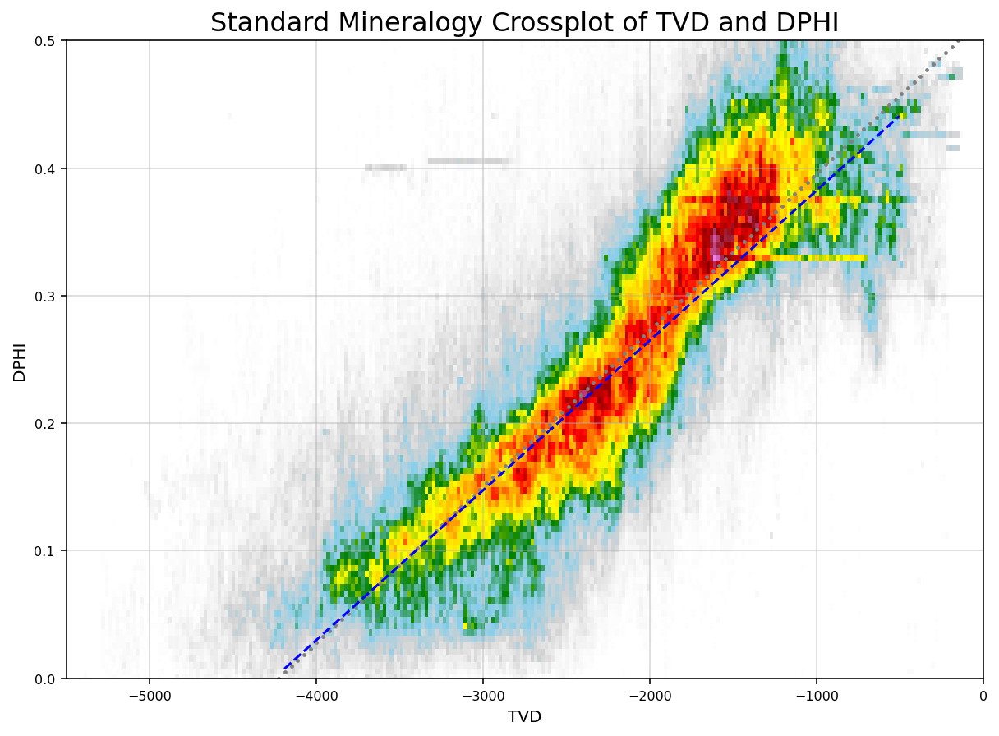

In [52]:
nameX = 'TVD'
nameY = 'DPHI'
pInt = CriticalPorosity
pSlope = 0.1175/1000
pSlope = np.average(lineDPHI/lineDEPTH)
print(pSlope)
pSlope = 0.0001175
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=linePOR)

inf


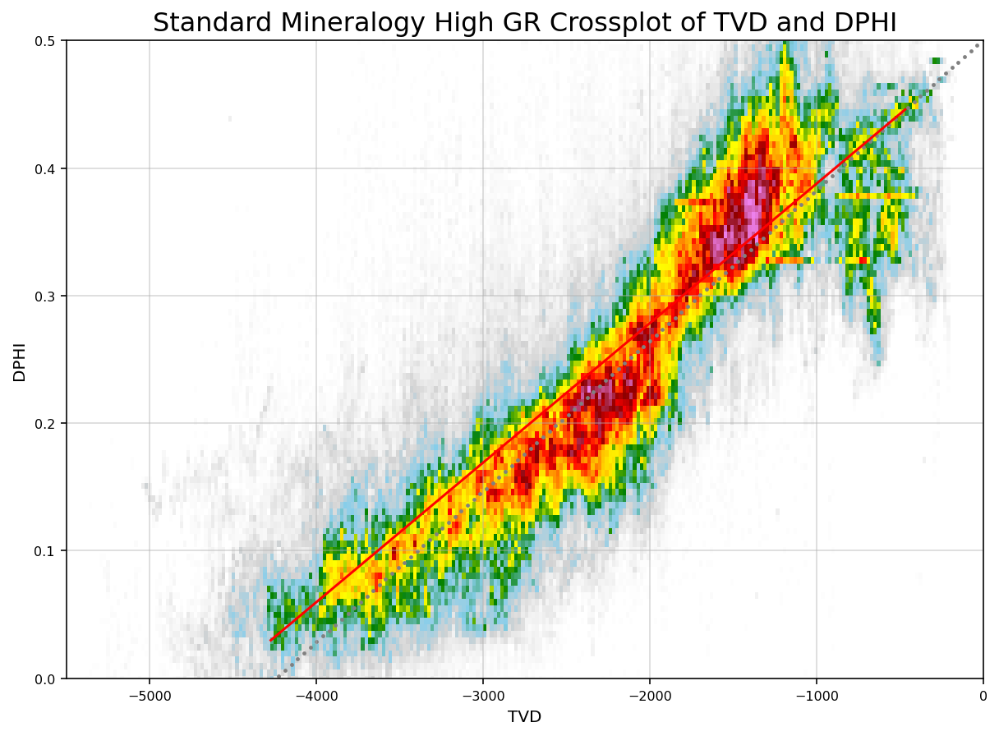

In [53]:
nameX = 'TVD'
nameY = 'DPHI'
pInt = 0.55
pSlope = np.average(lineDPHI/lineDEPTH)
print(pSlope)
pSlope = 0.0001375
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.GR_RES >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.GR_RES >= 0.005)],
                  nameX,nameY,order=1,lplot=True,intercept=pInt, slope=pSlope, pow=3, scaler=1, Title=Header + 'High GR ',
                  pline=True,lxaxis=lineDEPTH,lyaxis=lineDPHI)

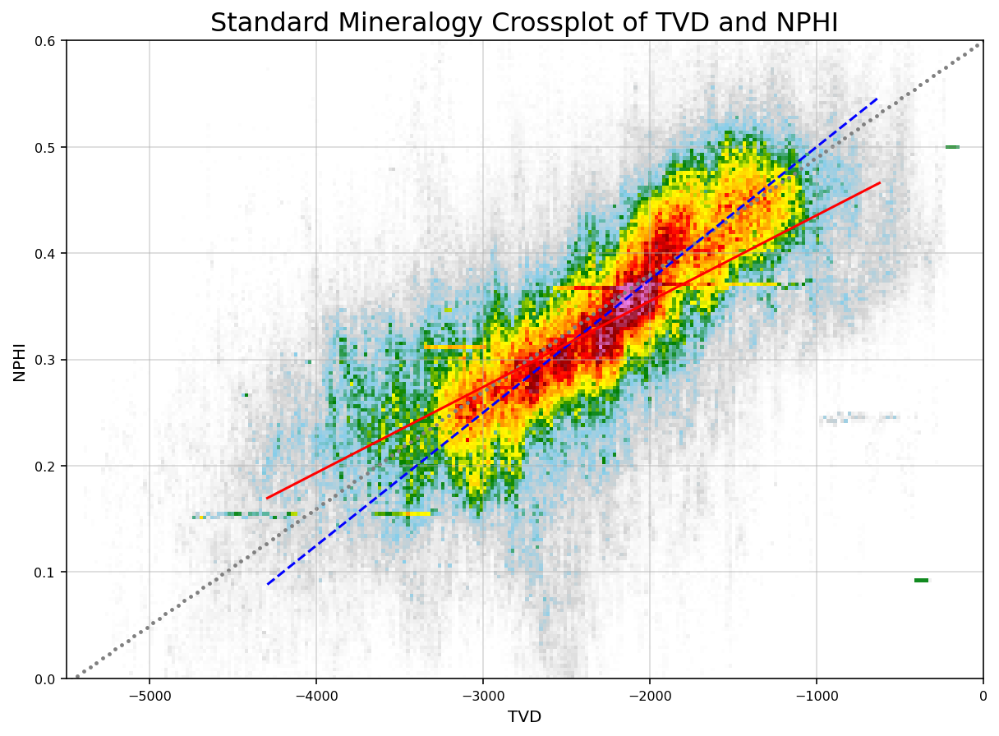

In [54]:
nameX = 'TVD'
nameY = 'NPHI'
pInt = 0.625
pSlope = 0.125/1000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=1,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=lineNPHI)

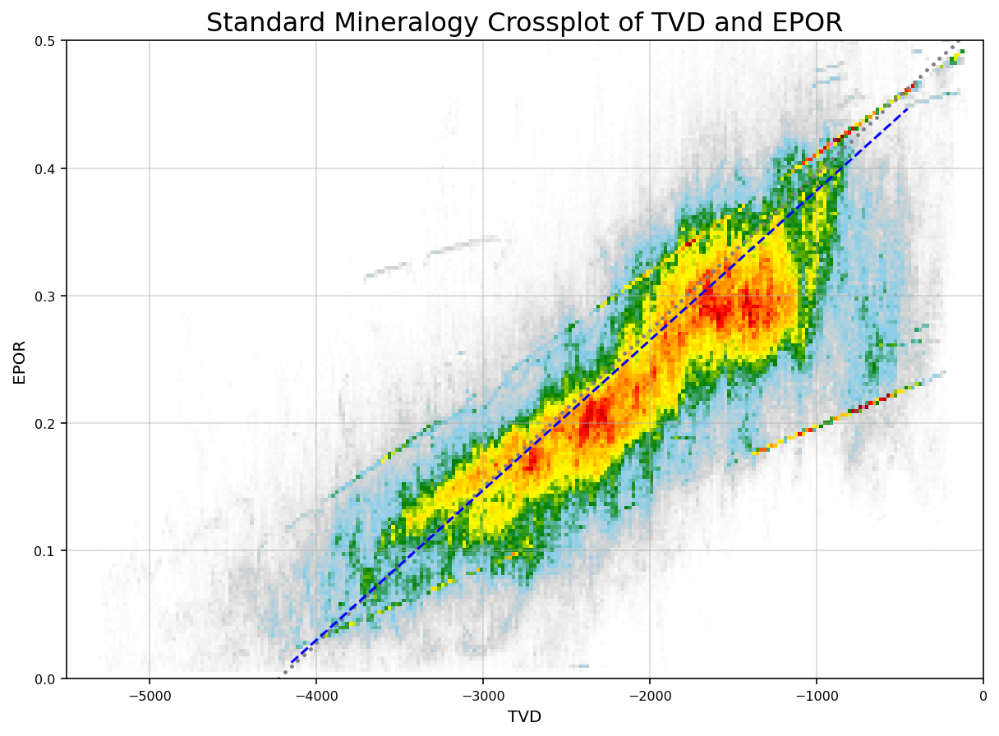

In [55]:
nameX = 'TVD'
nameY = 'EPOR'
pInt = 0.5
pSlope = 0.1175/1000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=linePOR)

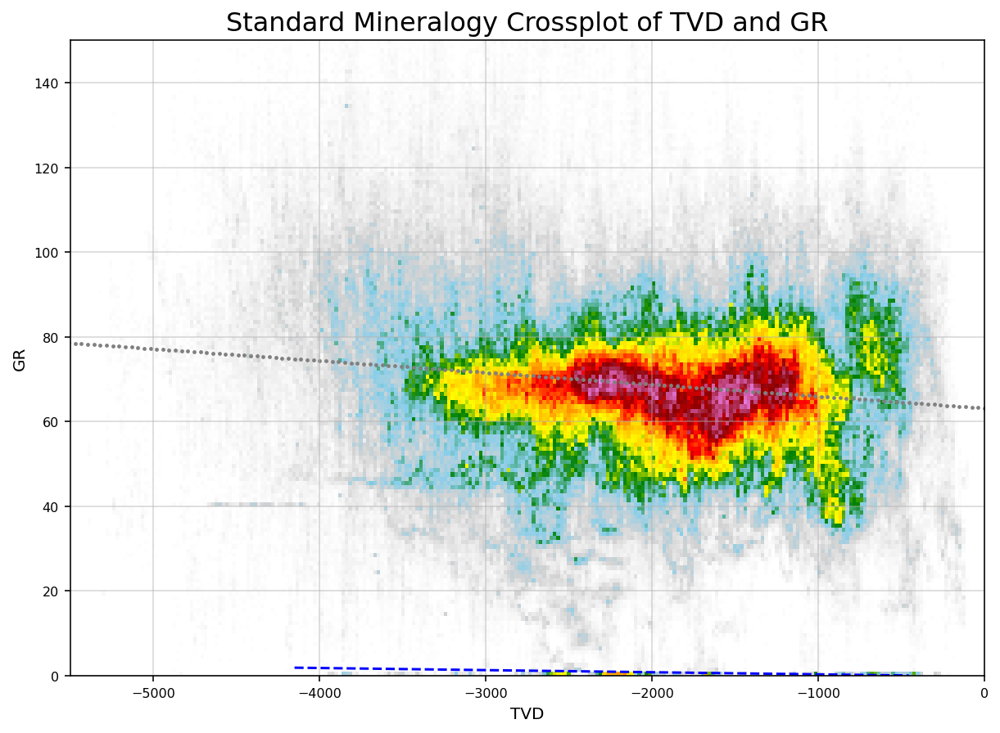

In [56]:
nameX = 'TVD'
nameY = 'GR'
pInt = -0.25
pSlope = -0.0005
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineDEPTH,lyaxis=lineGR)

## Petrophysical Plots

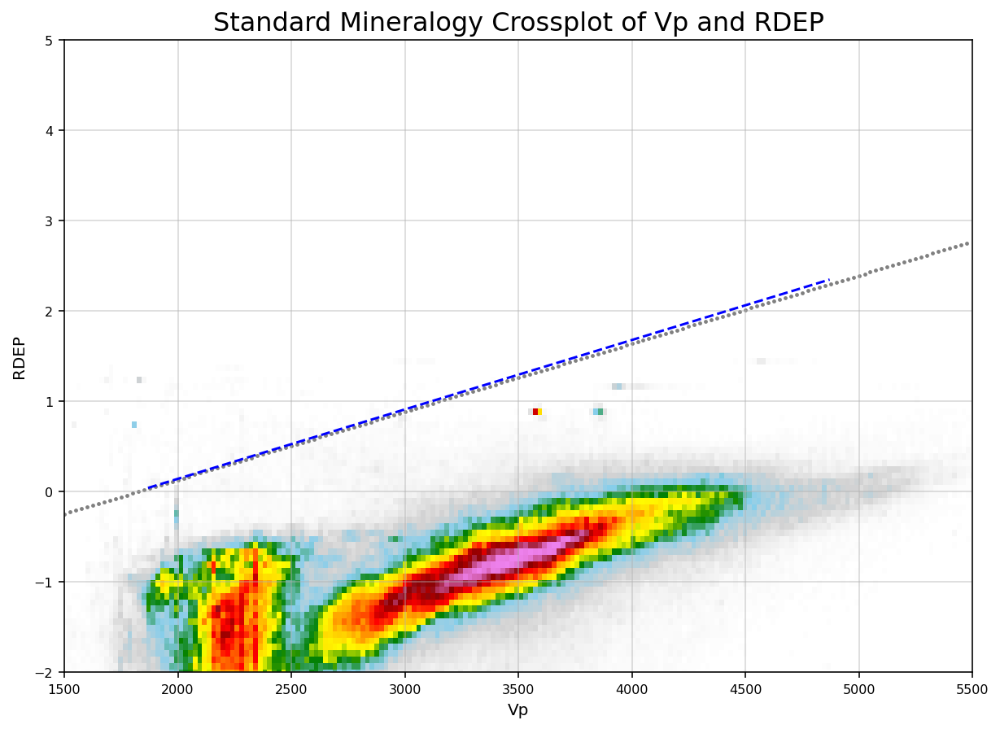

In [57]:
nameX = 'Vp'
nameY = 'RDEP'
pInt = -1.4
pSlope = 1/1300
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineVp,lyaxis=lineRDEP)

-0.00011104446092993187


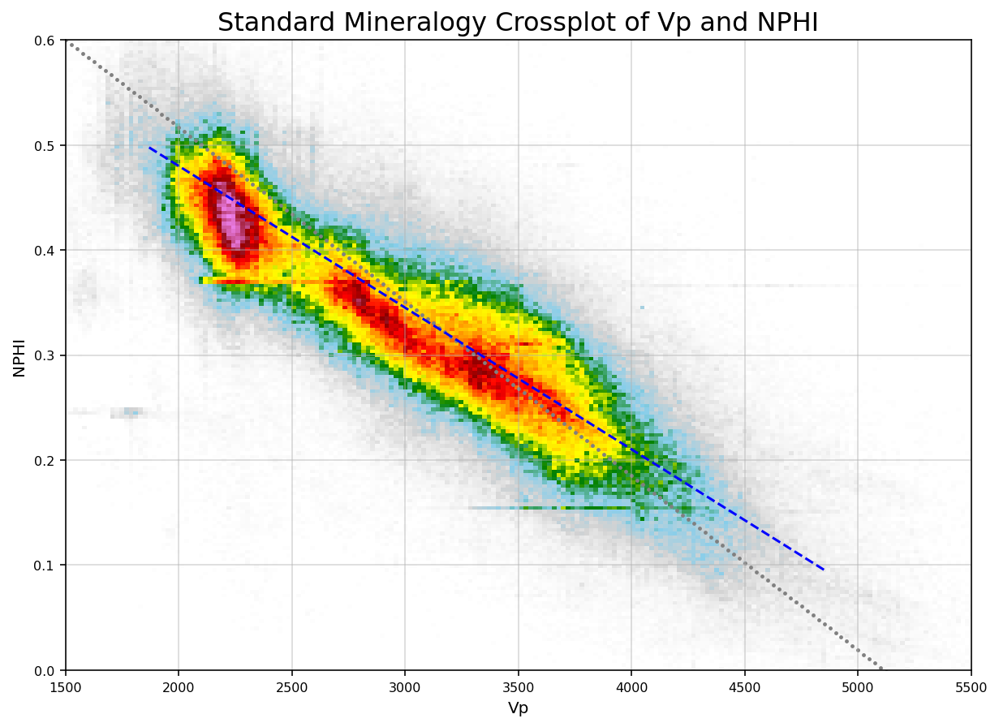

In [58]:
nameX = 'Vp'
nameY = 'NPHI'
pInt = 0.75
pSlope = -np.average(lineNPHI/lineVp)
print(pSlope)
pSlope = -0.000135
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineVp,lyaxis=lineNPHI)

0.022769248293361577


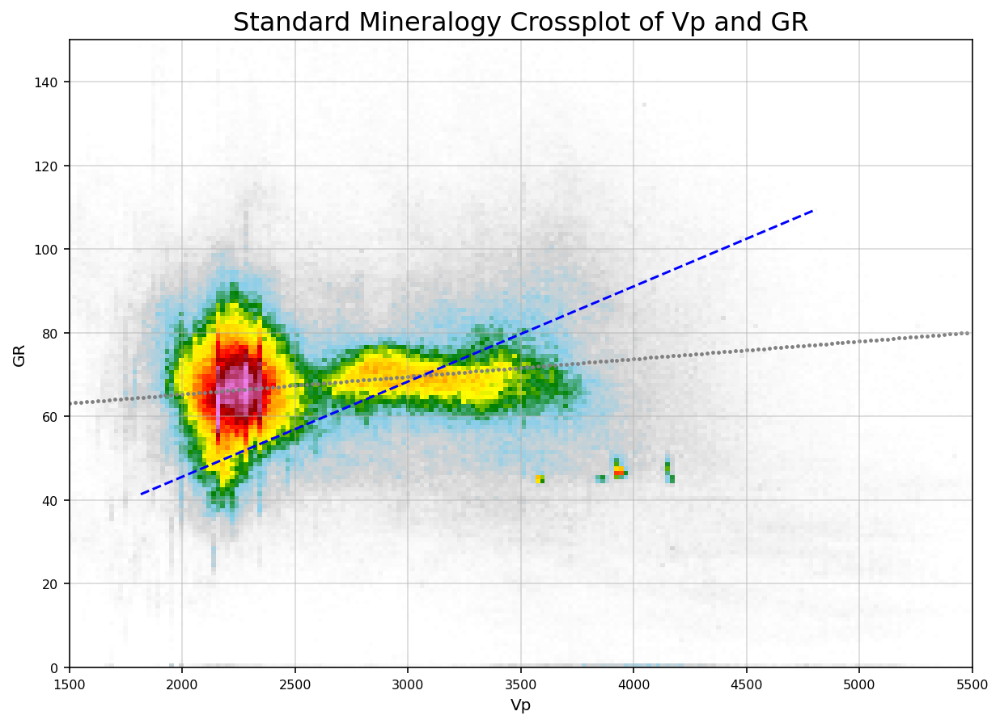

In [59]:
nameX = 'Vp'
nameY = 'GR'
pInt = 0
pSlope = np.average(lineGR/lineVp)
print(pSlope)
#pSlope = 0.0022
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineVp,lyaxis=lineGR)

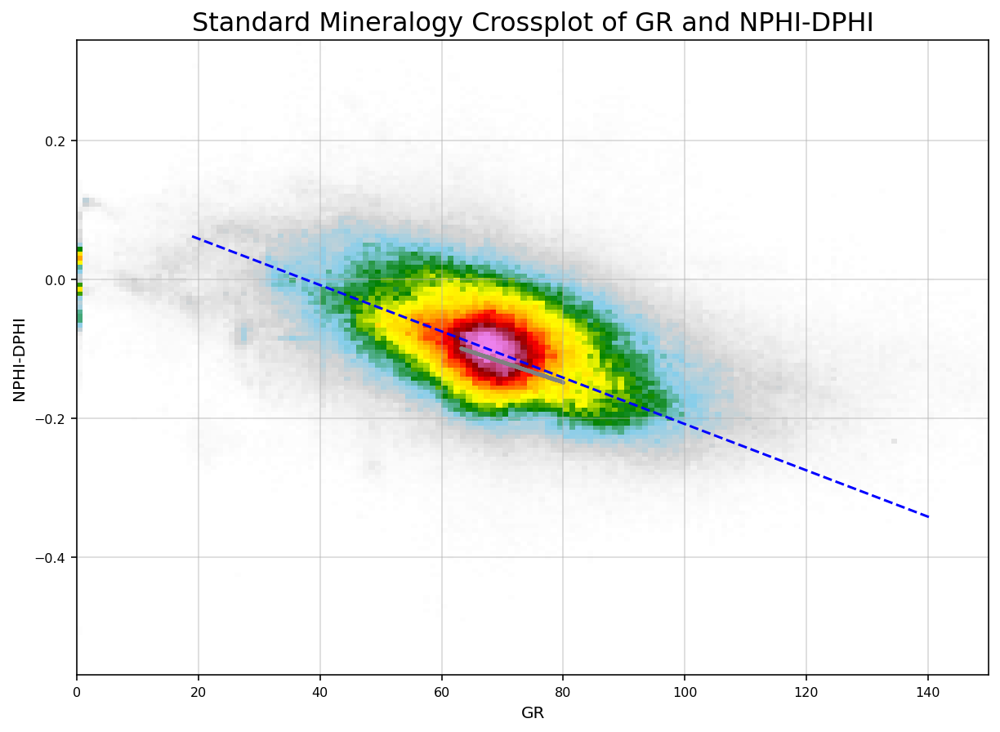

In [60]:
nameX = 'GR'
nameY = 'NPHI-DPHI'
pInt = .125
pSlope = -0.1/30
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineGR,lyaxis=lineDPHI-lineNPHI)

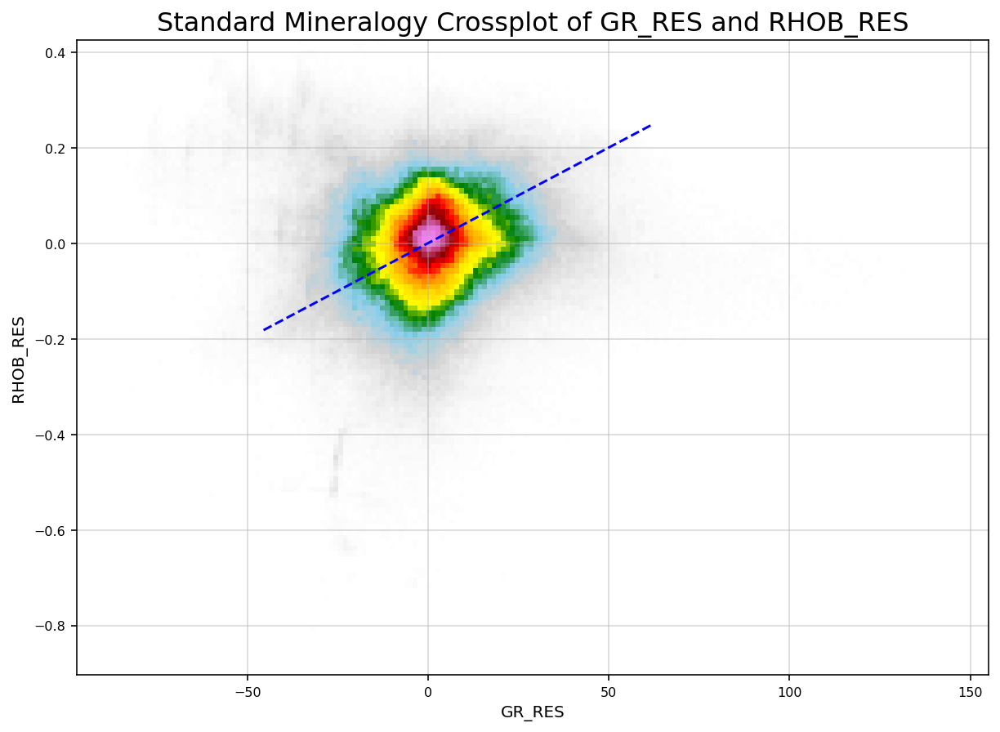

In [61]:
nameX = 'GR_RES'
nameY = 'RHOB_RES'
pInt =0
pSlope = 0.2/50
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=False,lxaxis=lineGR,lyaxis=lineNPHI-lineDPHI)

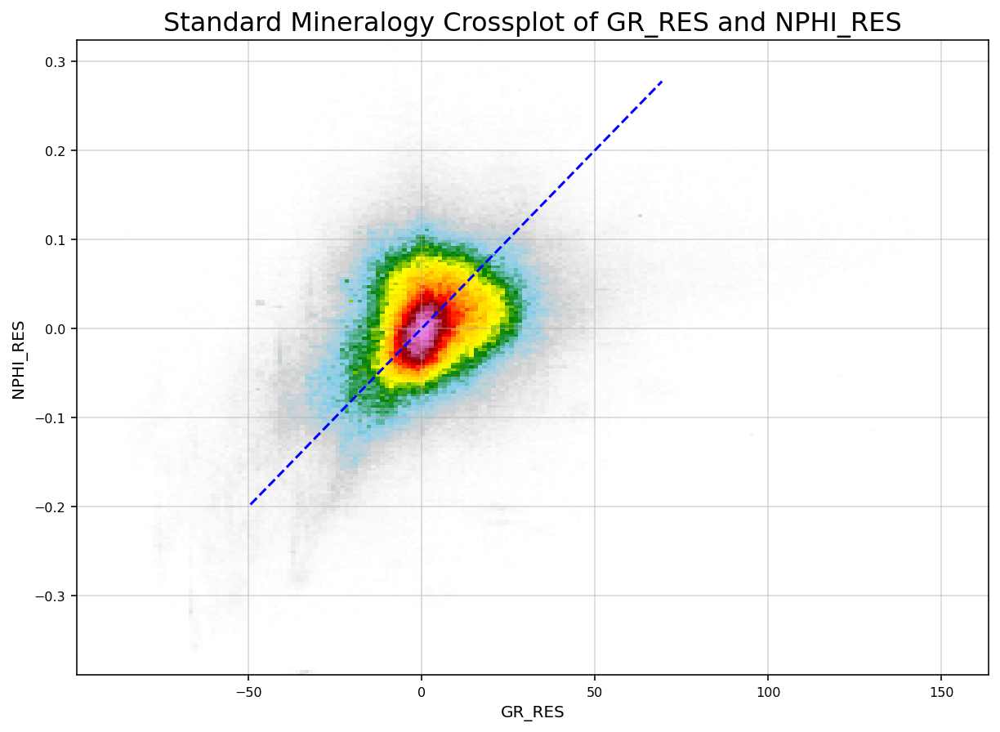

In [62]:
nameX = 'GR_RES'
nameY = 'NPHI_RES'
pInt =0
pSlope = 0.2/50
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=False,lxaxis=lineGR,lyaxis=lineNPHI-lineDPHI)

-2.243694865046373


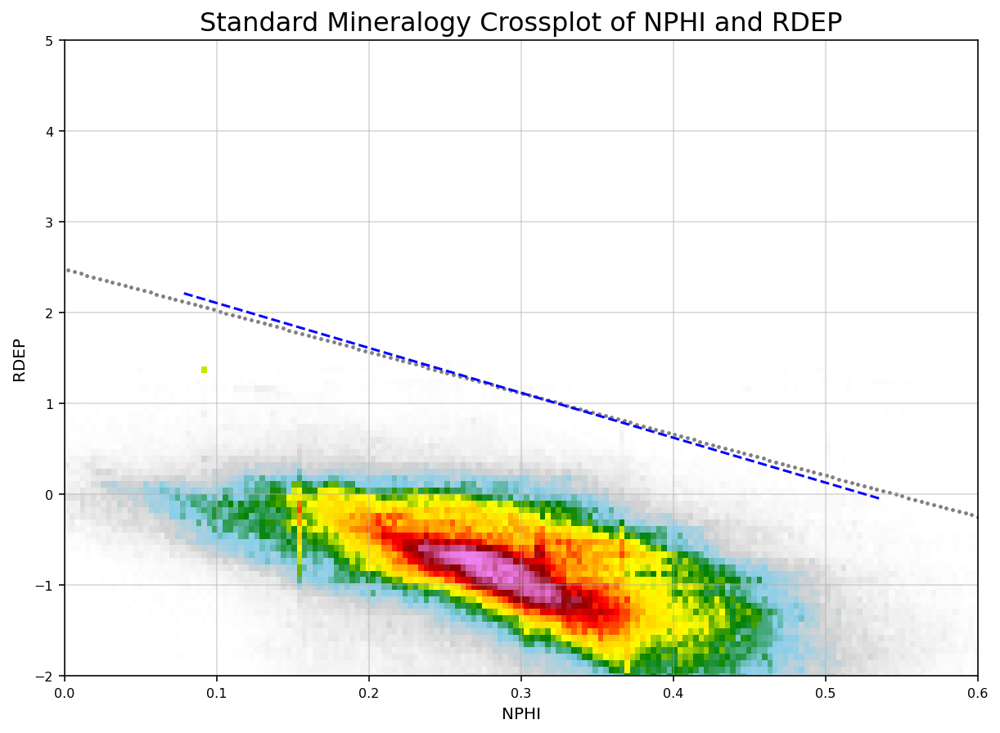

In [63]:
nameX = 'NPHI'
nameY = 'RDEP'
pInt = 2.6
pSlope = -np.average(lineRDEP/lineNPHI)
print(pSlope)
pSlope = -4.95
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineNPHI,lyaxis=lineRDEP)

-6.351023105734676


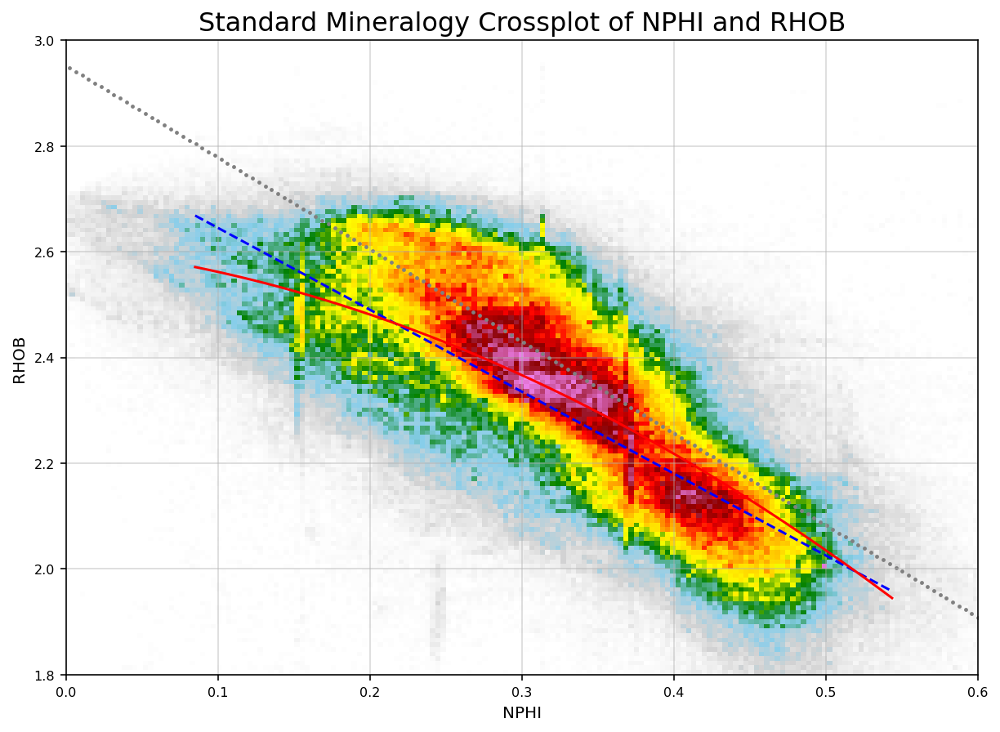

In [64]:
nameX = 'NPHI'
nameY = 'RHOB'
pInt = 2.8
pSlope = -np.average(lineRHOB/lineNPHI)
print(pSlope)
pSlope = (2.025-pInt)/0.5
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=2,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineNPHI,lyaxis=lineRHOB)

0.6810730712632838


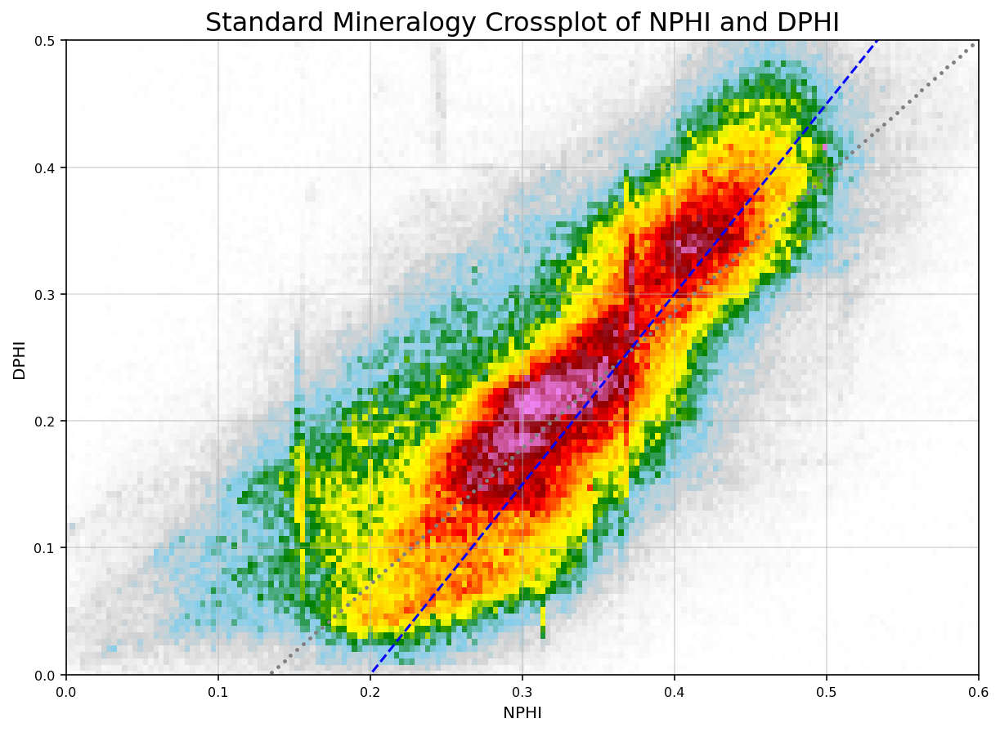

In [65]:
nameX = 'NPHI'
nameY = 'DPHI'
pInt = -0.3
pSlope = np.average(lineDPHI/lineNPHI)
print(pSlope)
pSlope = 1.5
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineNPHI,lyaxis=lineDPHI)

## Intercept Gradient

In [66]:
data['IGtest'] = np.abs(data.INTERCEPT) + np.abs(data.GRADIENT)

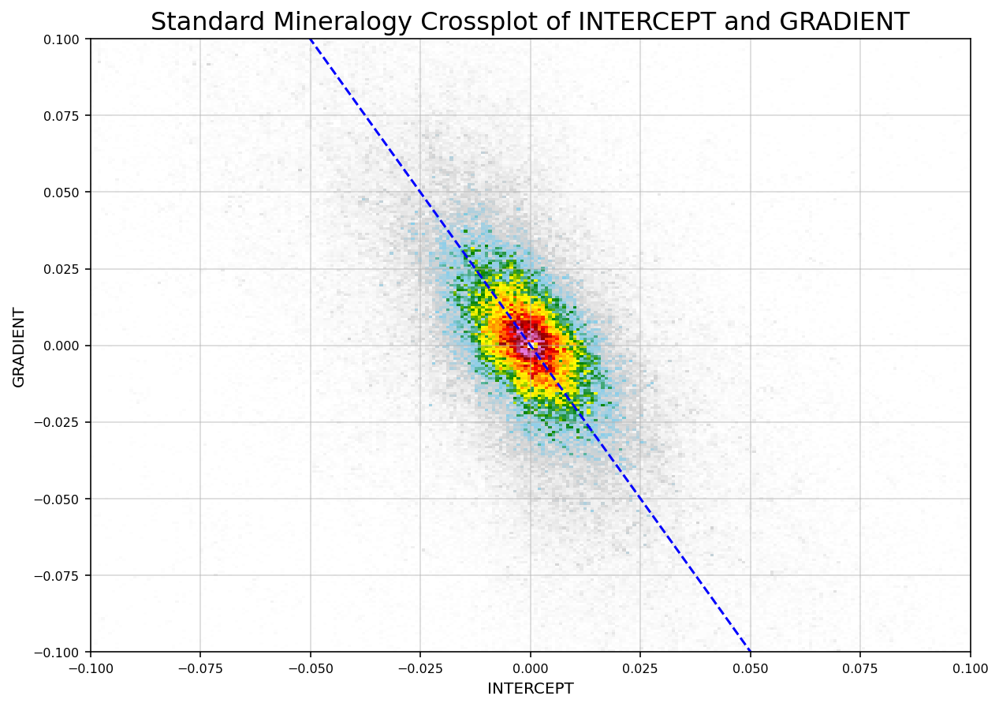

In [67]:
nameX = 'INTERCEPT'
nameY = 'GRADIENT'
pInt = 0
pSlope = -2

log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.IGtest >= 0.0015)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.IGtest >= 0.0015)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header)

26.56505117707799
-0.4636476090008061


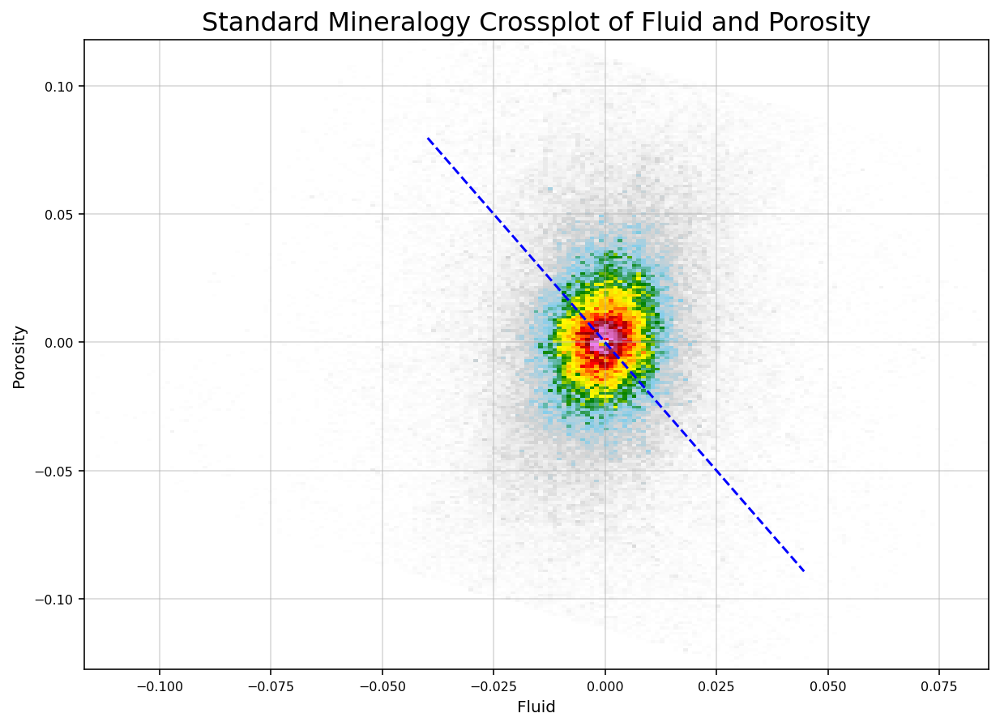

In [68]:
angle = np.arctan(-pSlope) * (180/math.pi) 
print(90-angle)
angle = -((90 - angle)/1)/(180/math.pi)
print(angle)

data['Fluid'] = data.INTERCEPT * np.cos(angle) - data.GRADIENT * np.sin(angle)
data['Porosity'] = data.INTERCEPT * np.sin(angle) + data.GRADIENT * np.cos(angle)

nameX = 'Fluid'
nameY = 'Porosity'
pInt = 0
pSlope = -2
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.IGtest >= 0.0015)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.IGtest >= 0.0015)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header)

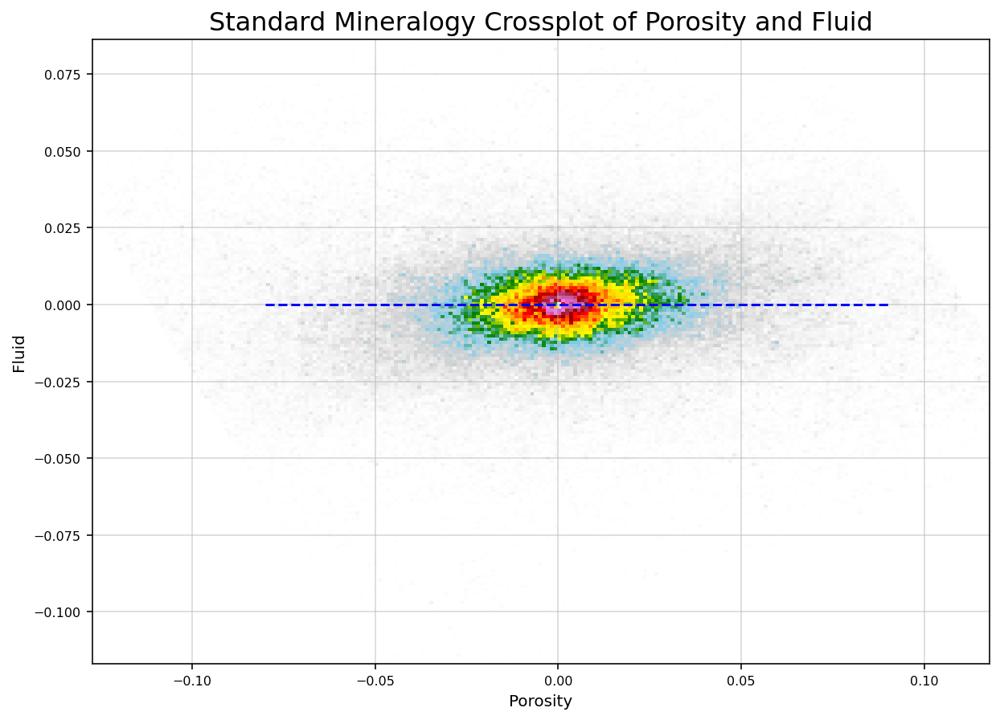

In [69]:
nameY = 'Fluid'
nameX = 'Porosity'
pInt = 0
pSlope = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.IGtest >= 0.0015)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data['CONFIDENCE'] <= 1)& (data.EPOR >= 0.005) & (data.IGtest >= 0.0015)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header)

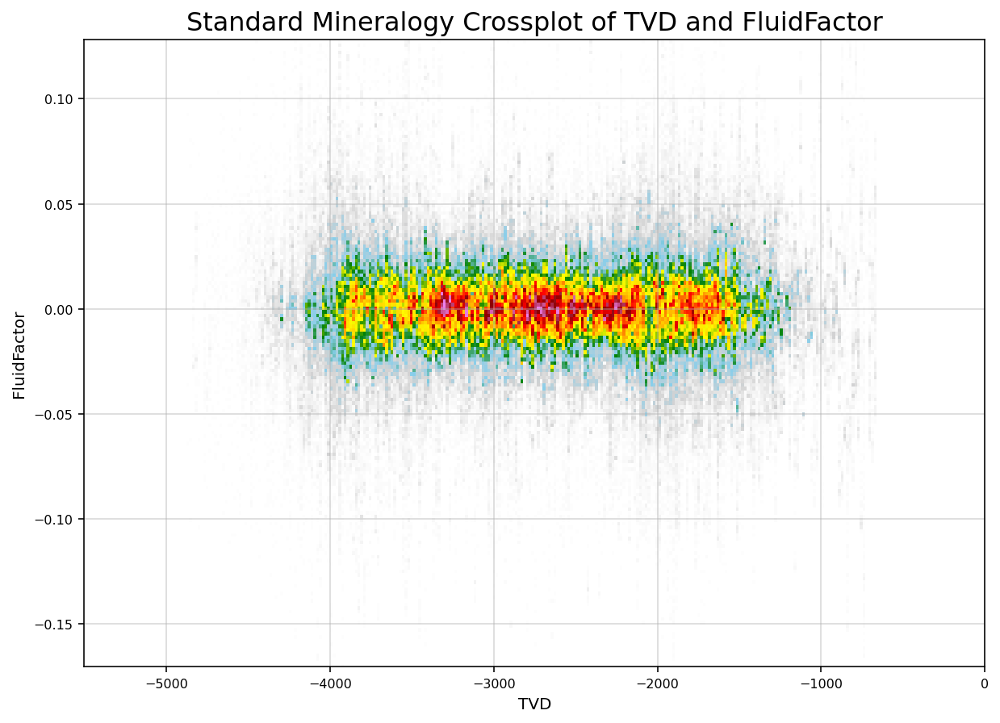

In [70]:
data['FluidFactor'] = data.Fluid.shift(lfilter*2) - data.Fluid.shift(-lfilter*2)

nameX = 'TVD'
nameY = 'FluidFactor'
pInt = 0
pSlope = 1700/2000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header)

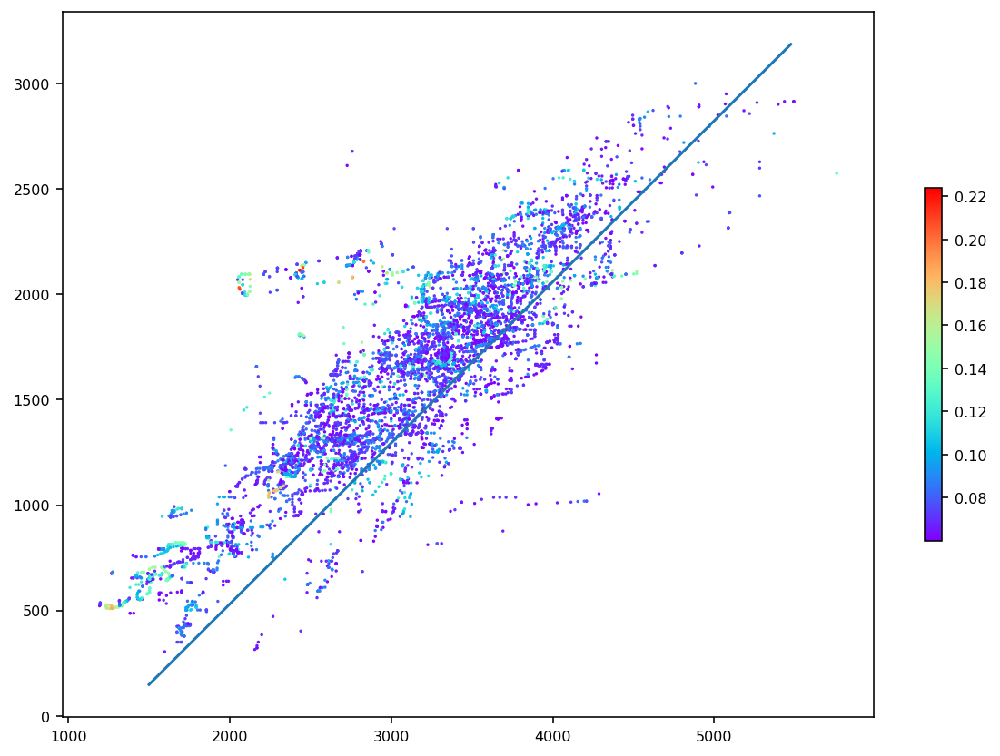

In [71]:
cutoff = 0.06
plt.scatter(data.Vp[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.FluidFactor >cutoff)],
            data.Vs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.FluidFactor >cutoff)],
            c=data.FluidFactor[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.FluidFactor >cutoff)],s=0.5,cmap='rainbow')
plt.plot(lineVp,lineVs)
plt.colorbar(shrink=0.5)

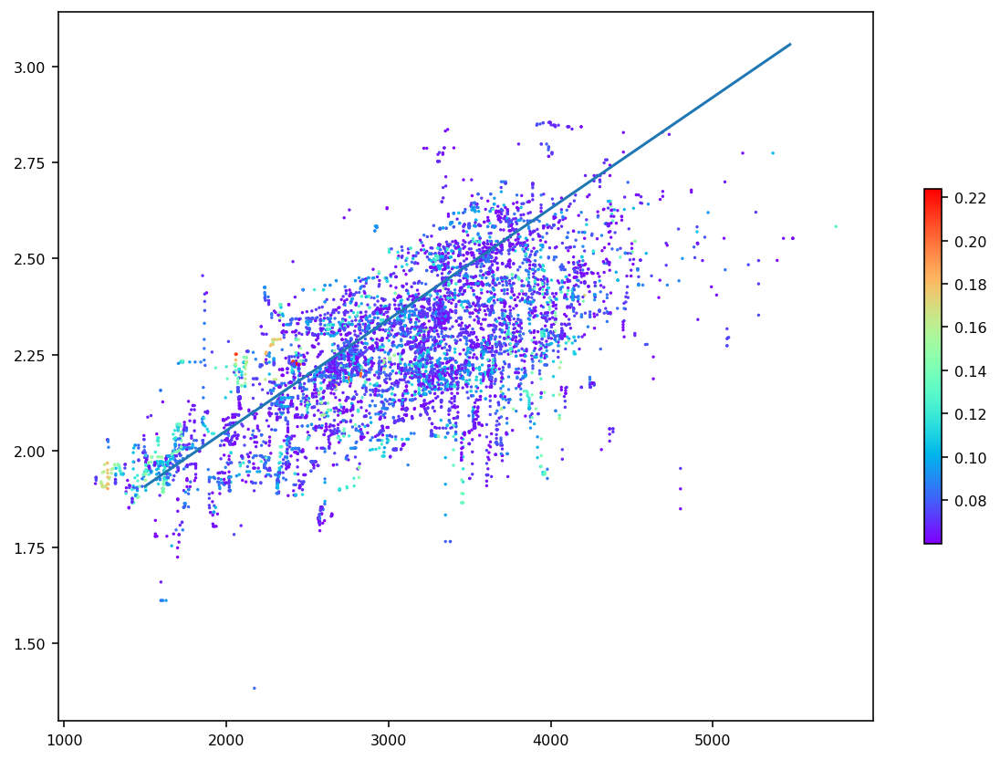

In [72]:
plt.scatter(data.Vp[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.FluidFactor >cutoff)],
            data.RHOB[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.FluidFactor >cutoff)],
            c=data.FluidFactor[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2) & (data.FluidFactor >cutoff)],s=0.5,cmap='rainbow')
plt.plot(lineVp,lineRHOB)
plt.colorbar(shrink=0.5)

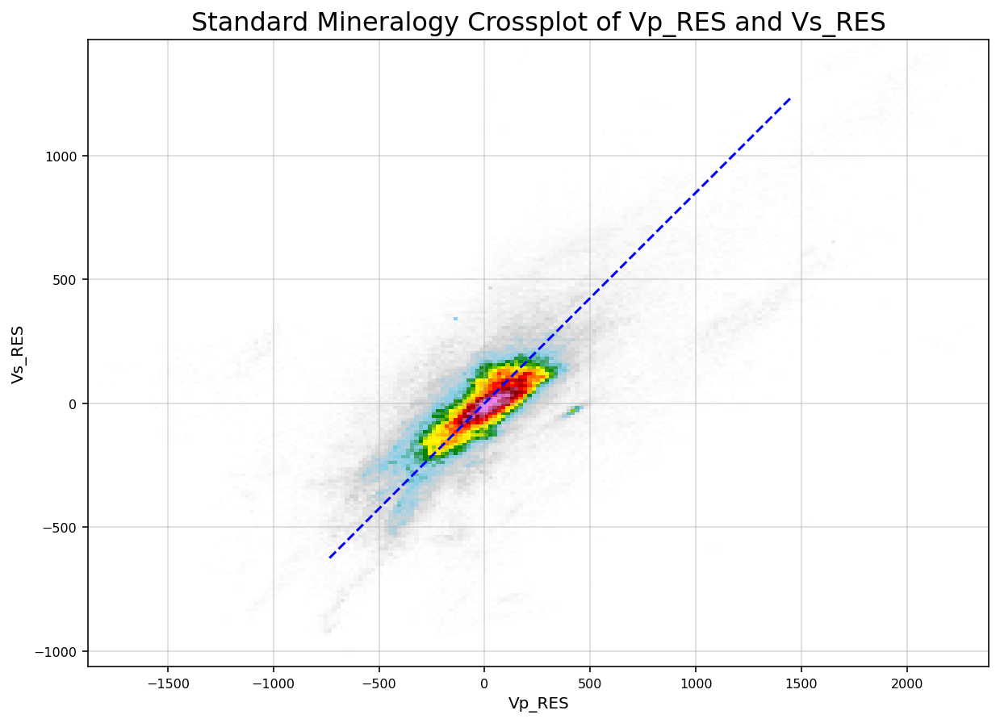

In [73]:
nameX = 'Vp_RES'
nameY = 'Vs_RES'
pInt = 0
pSlope = 1700/2000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header)

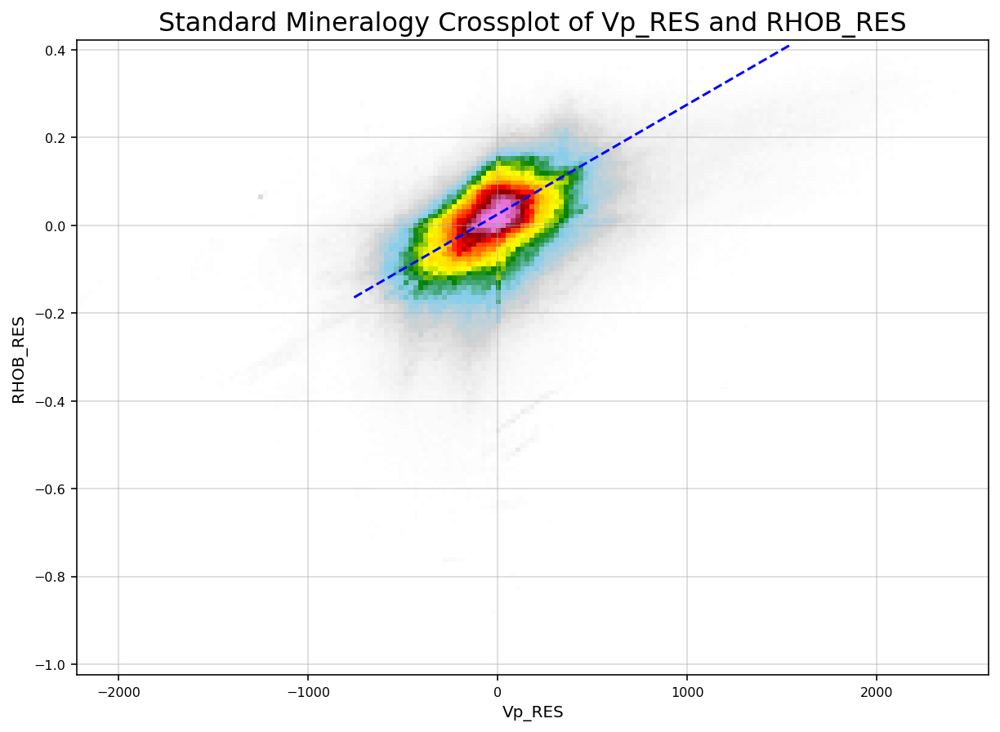

In [74]:
nameX = 'Vp_RES'
nameY = 'RHOB_RES'
pInt = 0.025
pSlope = .125/500
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header)

## Engineering crossplots

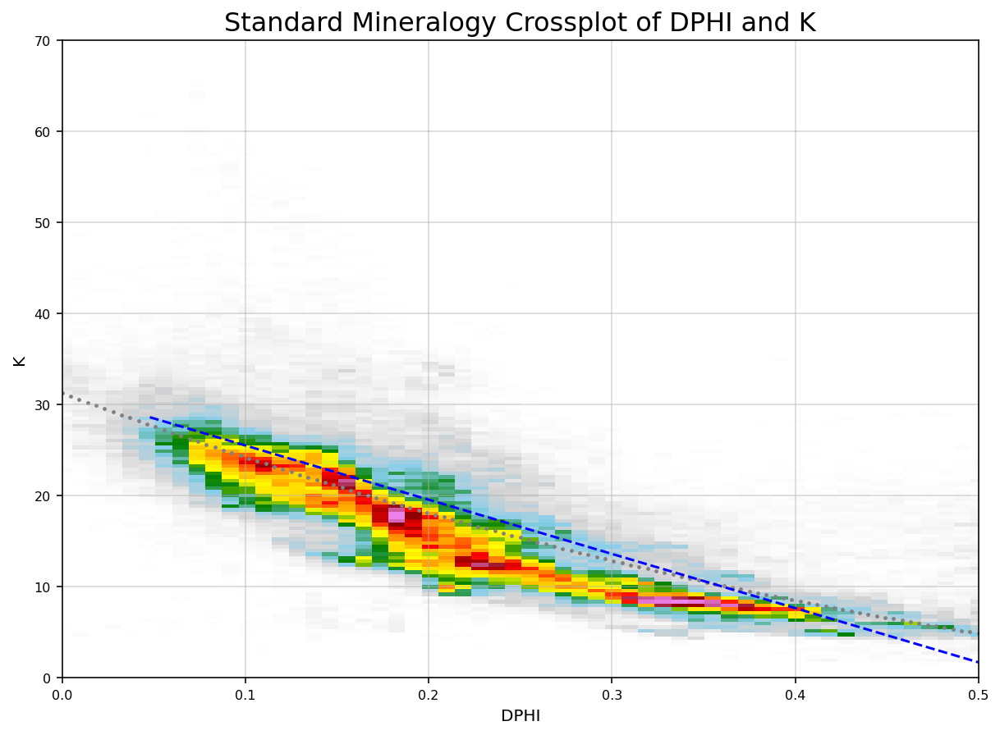

In [75]:
nameX = 'DPHI'
nameY = 'K'
pInt = Kmineral
pSlope = (Kfluid-Kmineral)/CriticalPorosity
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=linePOR,lyaxis=lineK)

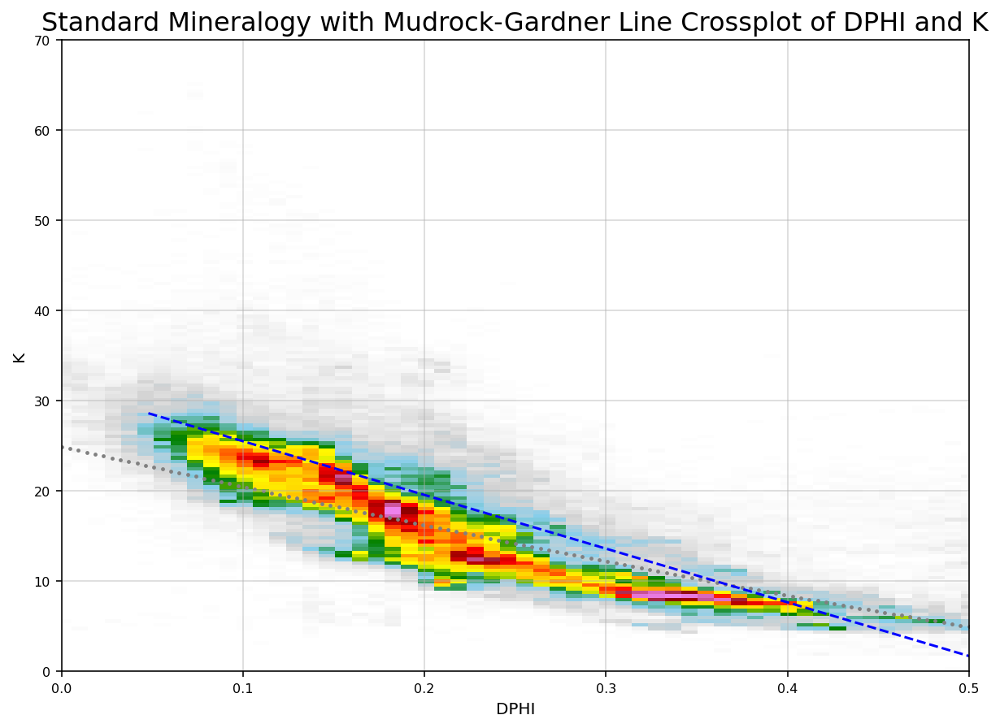

In [76]:
nameX = 'DPHI'
nameY = 'K'
pInt = Kmineral
pSlope = (Kfluid-Kmineral)/CriticalPorosity
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header + 'with Mudrock-Gardner Line ',
                  pline=True,lxaxis=linePOR,lyaxis=lineK_MG)

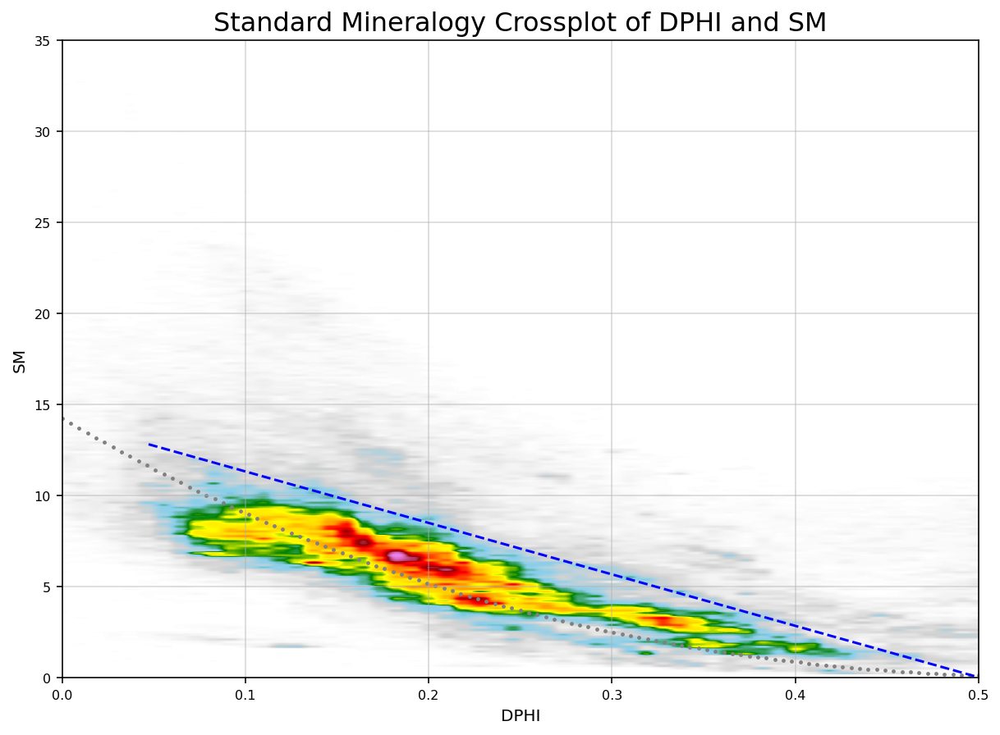

In [77]:
nameX = 'DPHI'
nameY = 'SM'
pInt = ShearModulus
pSlope = -ShearModulus/CriticalPorosity
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,\
                  pline=True,lxaxis=linePOR,lyaxis=lineSM)

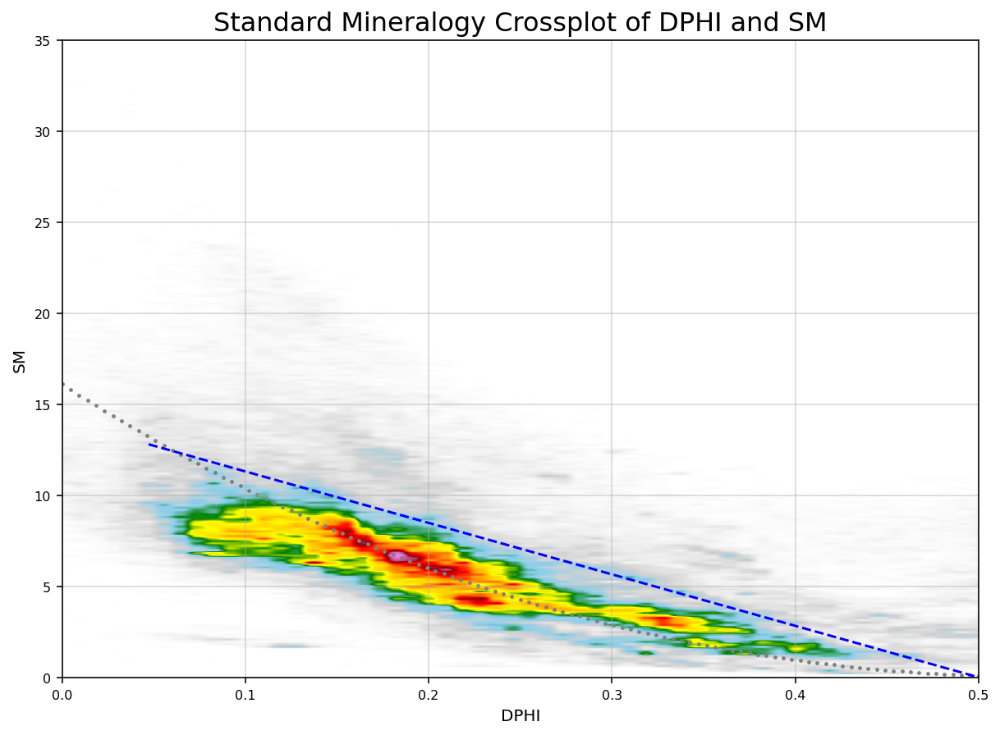

In [78]:
nameX = 'DPHI'
nameY = 'SM'
pInt = ShearModulus
pSlope = -ShearModulus/CriticalPorosity
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,\
                  pline=True,lxaxis=linePOR,lyaxis=lineSM_MG)

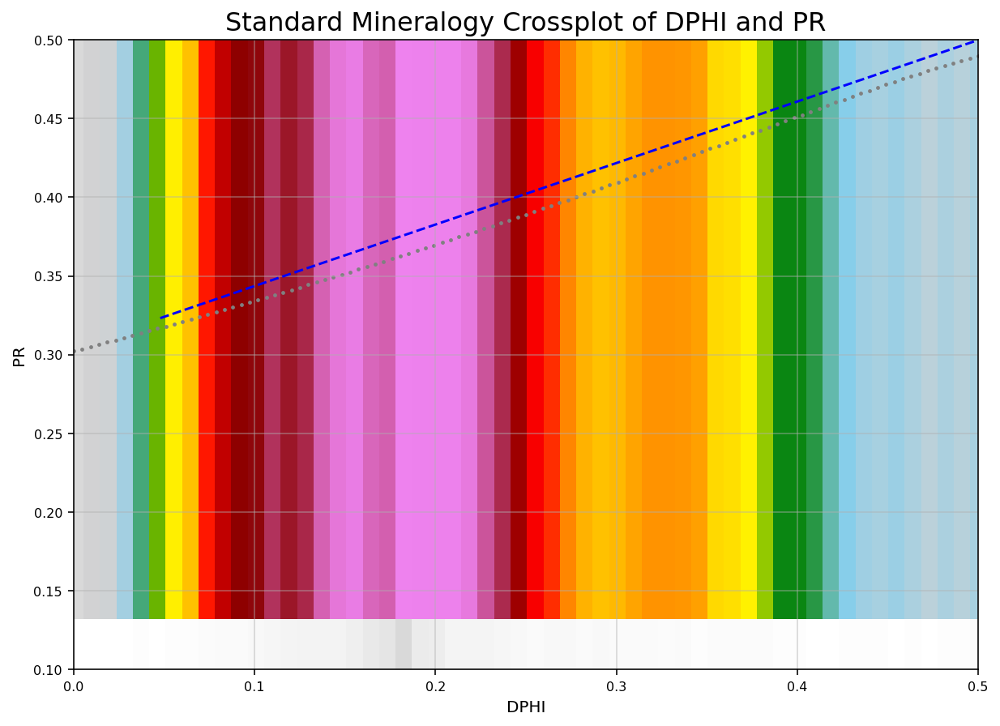

In [79]:
nameX = 'DPHI'
nameY = 'PR'
pInt = PoissonRatio
pSlope = (0.5-PoissonRatio)/CriticalPorosity
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=linePOR,lyaxis=linePR)

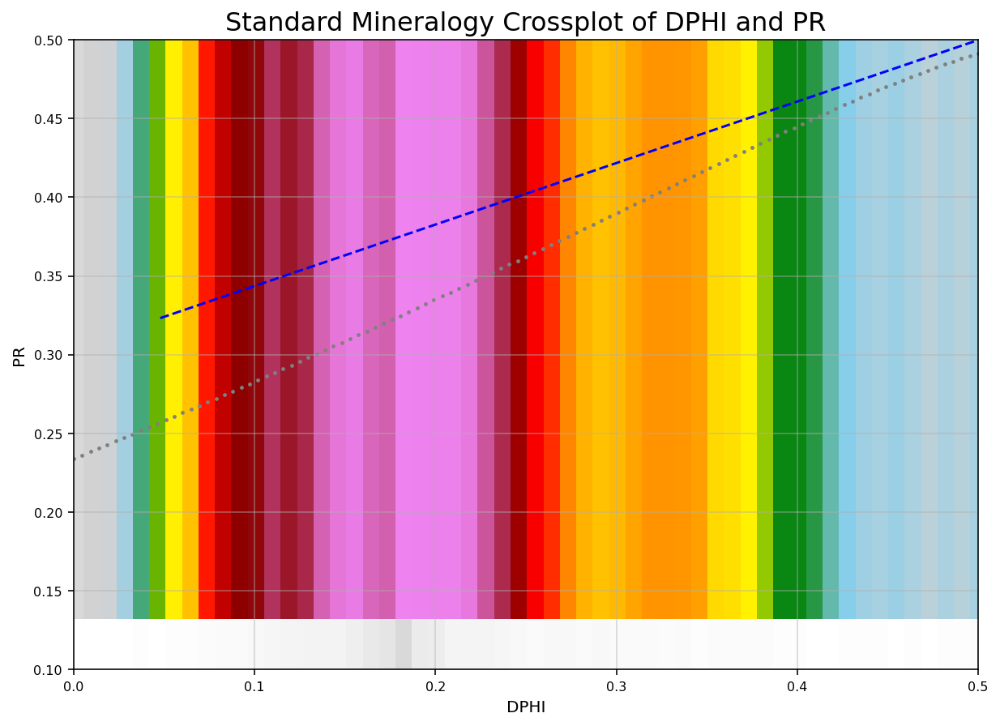

In [80]:
nameX = 'DPHI'
nameY = 'PR'
pInt = PoissonRatio
pSlope = (0.5-PoissonRatio)/CriticalPorosity
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=linePOR,lyaxis=linePR_MG)

## Input against Emperical Relationship

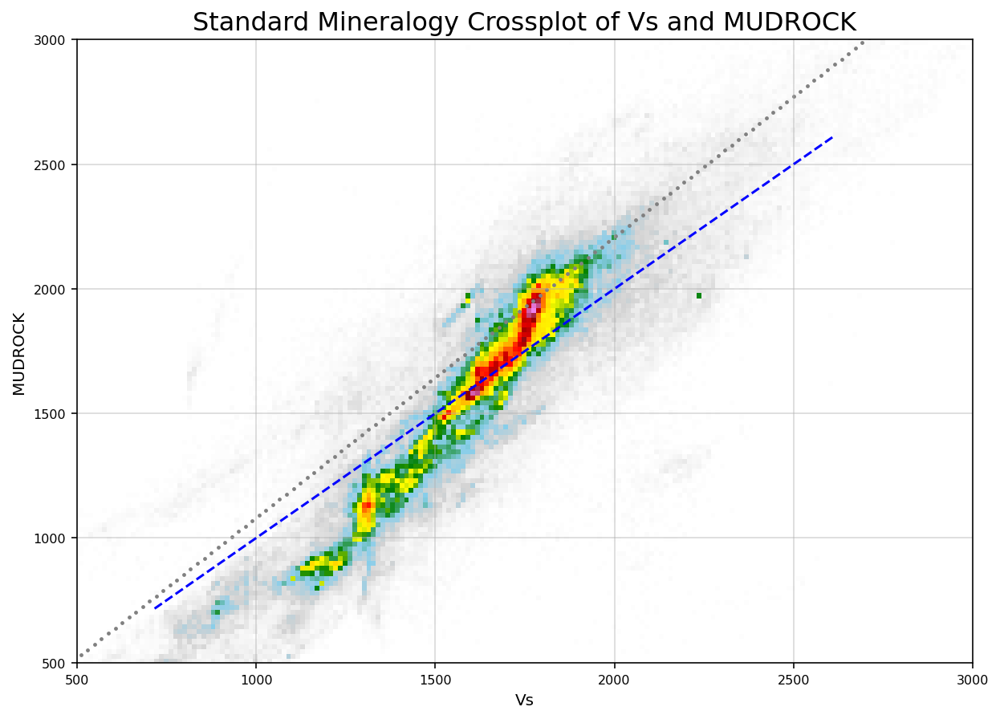

In [81]:
nameX = 'Vs'
nameY = 'MUDROCK'
pInt = 0
pSlope = 1000/1000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineVs,lyaxis=lineMUDROCK)

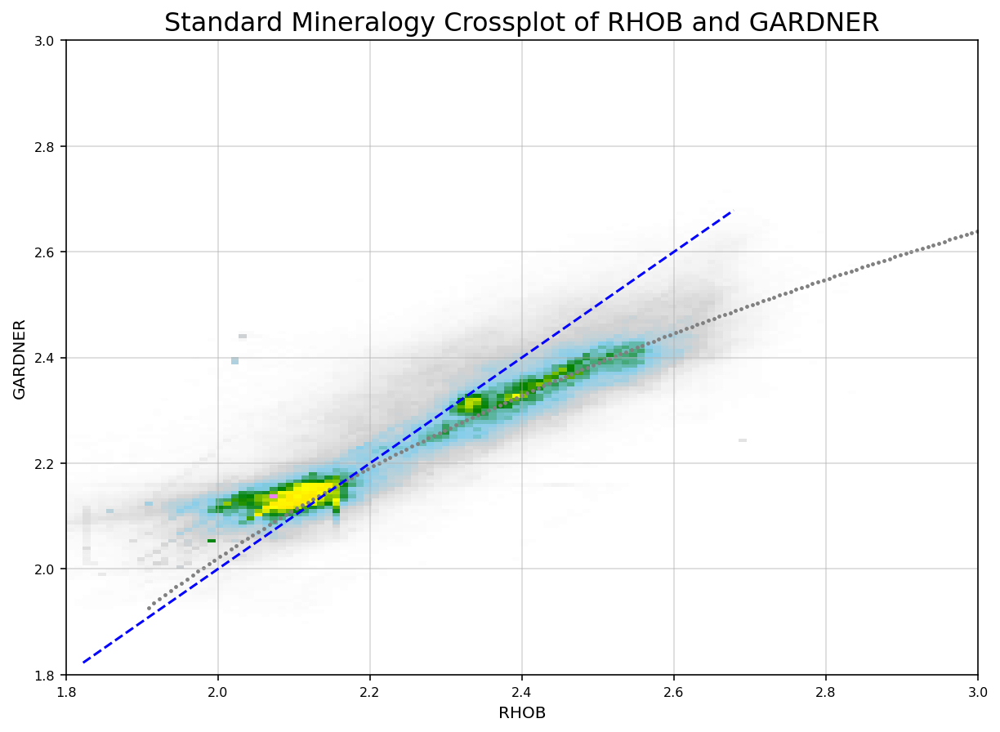

In [82]:
nameX = 'RHOB'
nameY = 'GARDNER'
pInt = 0
pSlope = 1000/1000
shift = 0
log_crossplot (data[nameX][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)]+shift,
                  data[nameY][(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
                  nameX,nameY,order=0,lplot=True,intercept=pInt, slope=pSlope, pow=1, scaler=1, Title=Header,
                  pline=True,lxaxis=lineRHOB,lyaxis=lineGARDNER) 

## Rock Physic crossplots with GR

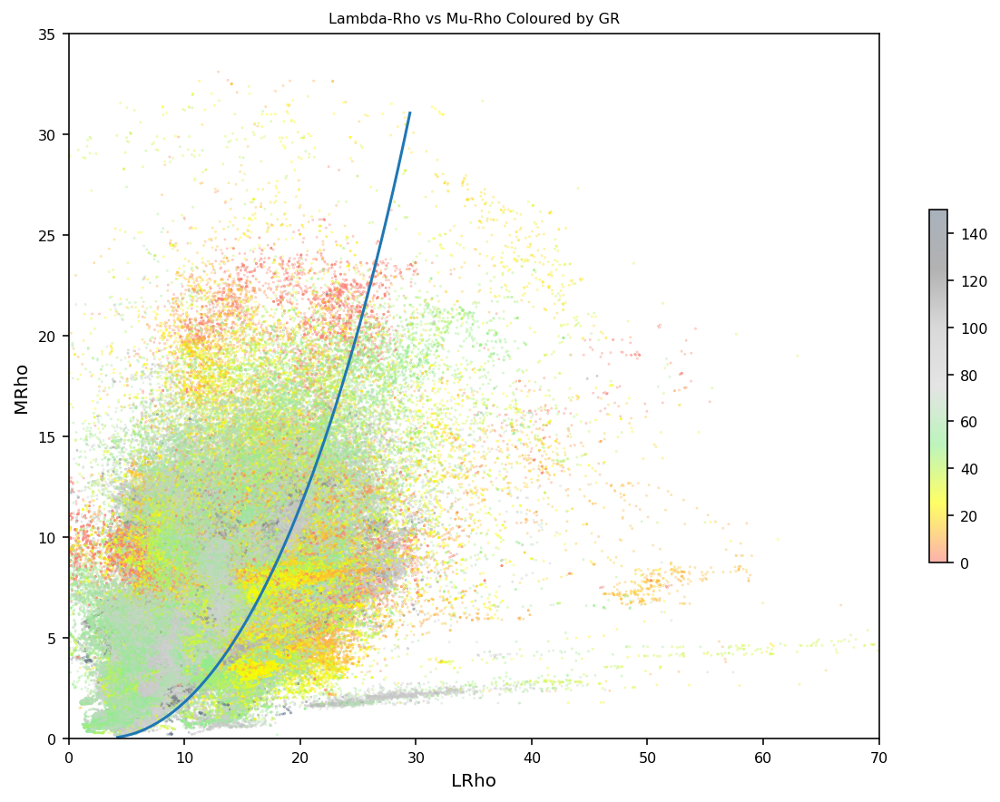

In [83]:
#data['MuRho'] = np.power(data['Vs']/1000,2)*data['RHOB']
#data['LRho'] = np.power(data['Vp']/1000,2)*data['RHOB']-2*np.power(data['Vs']/1000,2)*data['RHOB']
plt.scatter(data.LRho[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.MuRho[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.6, vmin=0, vmax=150)
plt.xlim(0,70)
plt.ylim(0,35)
plt.xlabel('LRho')
plt.ylabel('MRho')
plt.colorbar(shrink=0.5)
plt.plot(lineLrho,lineMrho)
plt.title('Lambda-Rho vs Mu-Rho Coloured by GR');

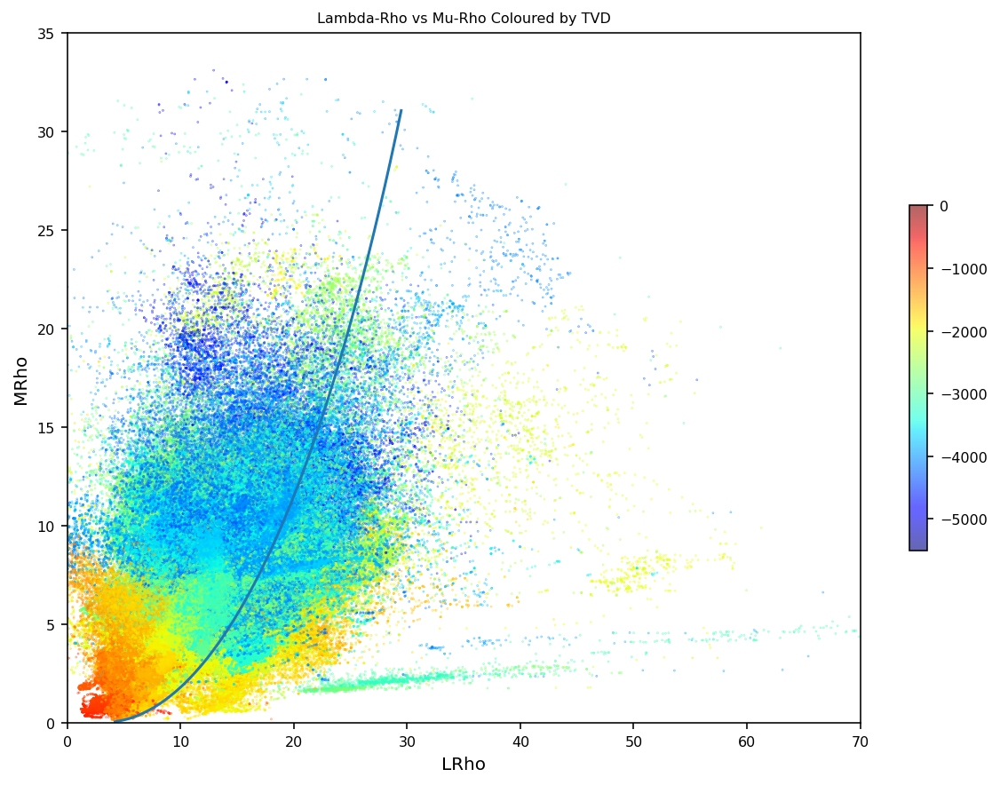

In [84]:
plt.scatter(data.LRho[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.MuRho[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.TVD[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='jet',s=0.1, alpha=0.6, vmin=DPmin, vmax=DPmax)
plt.xlim(0,70)
plt.ylim(0,35)
plt.xlabel('LRho')
plt.ylabel('MRho')
plt.colorbar(shrink=0.5)
plt.plot(lineLrho,lineMrho)
plt.title('Lambda-Rho vs Mu-Rho Coloured by TVD');

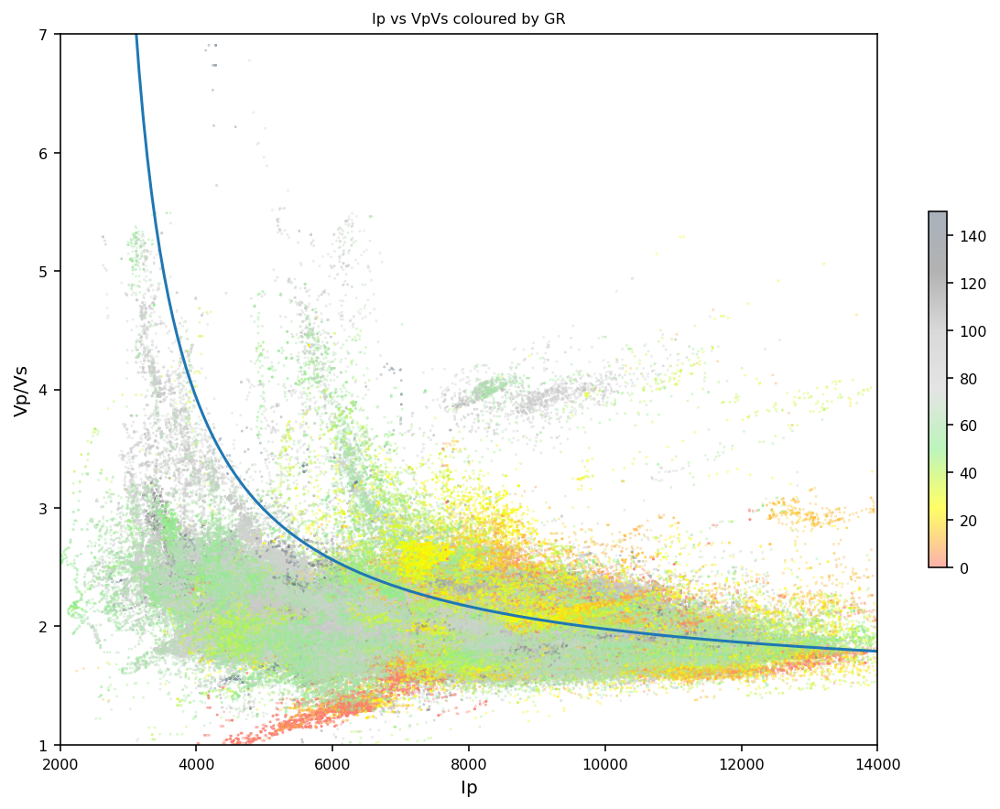

In [85]:
plt.scatter(data.Ip[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.VpVs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.6, vmin=0, vmax=150)
plt.xlim(2000,14000)
plt.ylim(1,7)
plt.xlabel('Ip')
plt.ylabel('Vp/Vs')
plt.colorbar(shrink=0.5)
plt.plot(lineVp*lineRHOB,lineVpVs)
plt.title('Ip vs VpVs coloured by GR');

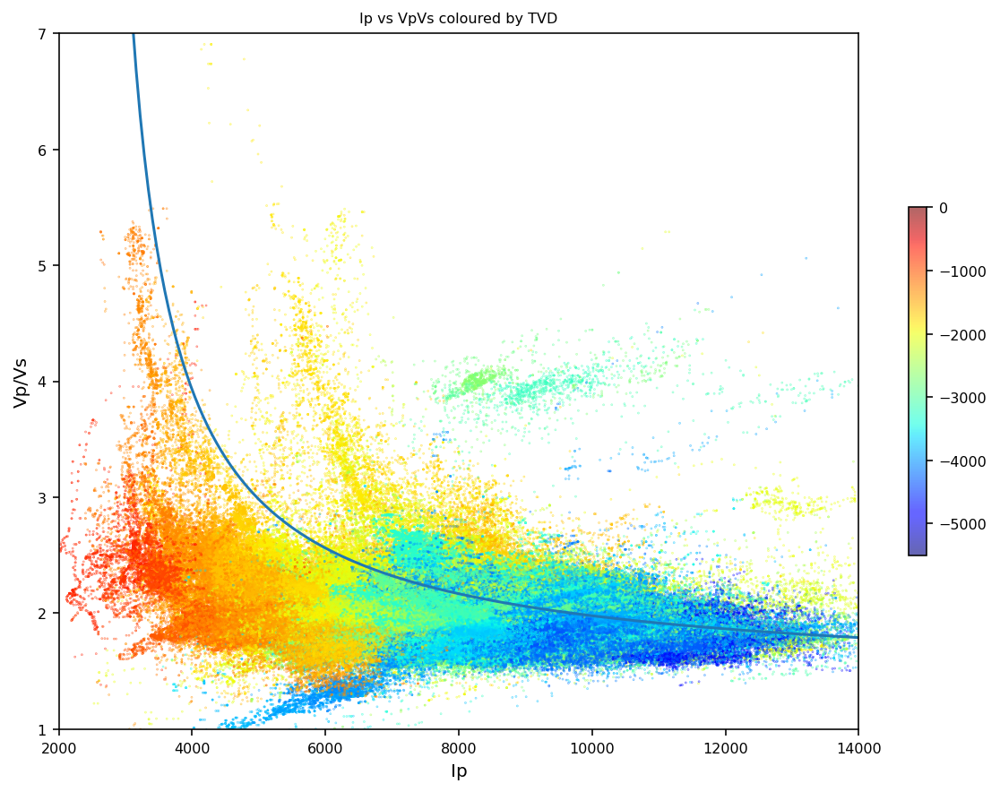

In [86]:
plt.scatter(data.Ip[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.VpVs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.TVD[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='jet',s=0.1, alpha=0.6, vmin=DPmin, vmax=DPmax)
plt.xlim(2000,14000)
plt.ylim(1,7)
plt.xlabel('Ip')
plt.ylabel('Vp/Vs')
plt.colorbar(shrink=0.5)
plt.plot(lineVp*lineRHOB,lineVpVs)
plt.title('Ip vs VpVs coloured by TVD');

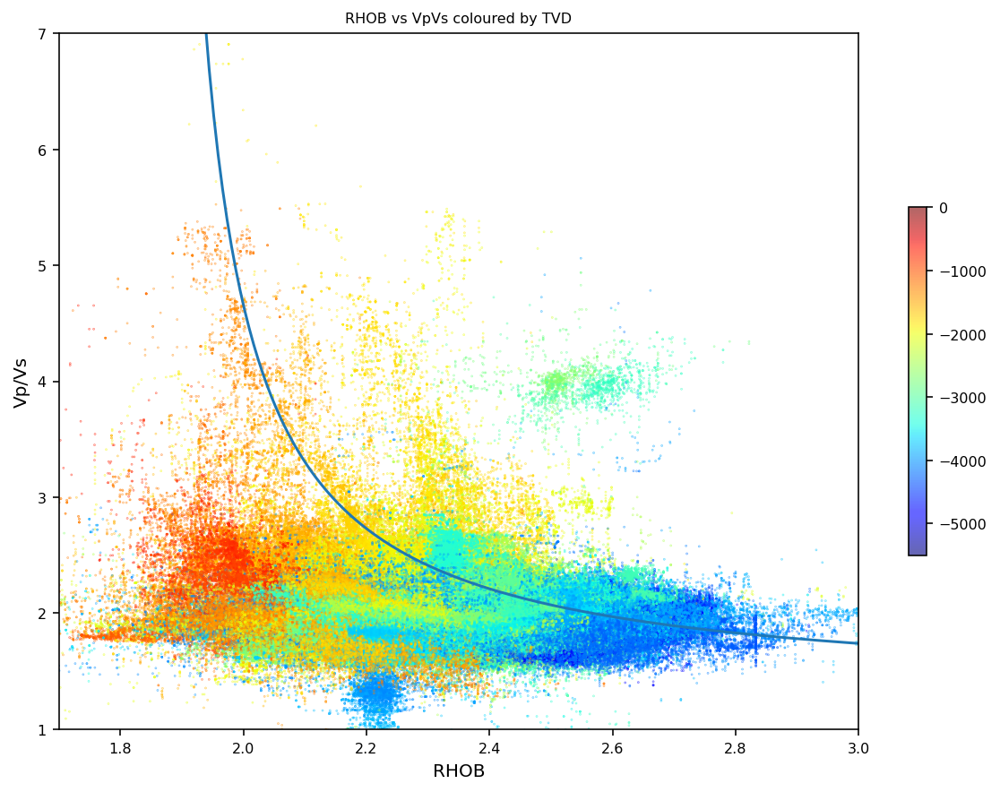

In [87]:
plt.scatter(data.RHOB[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.VpVs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.TVD[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='jet',s=0.1, alpha=0.6, vmin=DPmin, vmax=DPmax)
plt.xlim(1.7,3)
plt.ylim(1,7)
plt.xlabel('RHOB')
plt.ylabel('Vp/Vs')
plt.colorbar(shrink=0.5)
plt.plot(lineRHOB,lineVpVs)
plt.title('RHOB vs VpVs coloured by TVD');

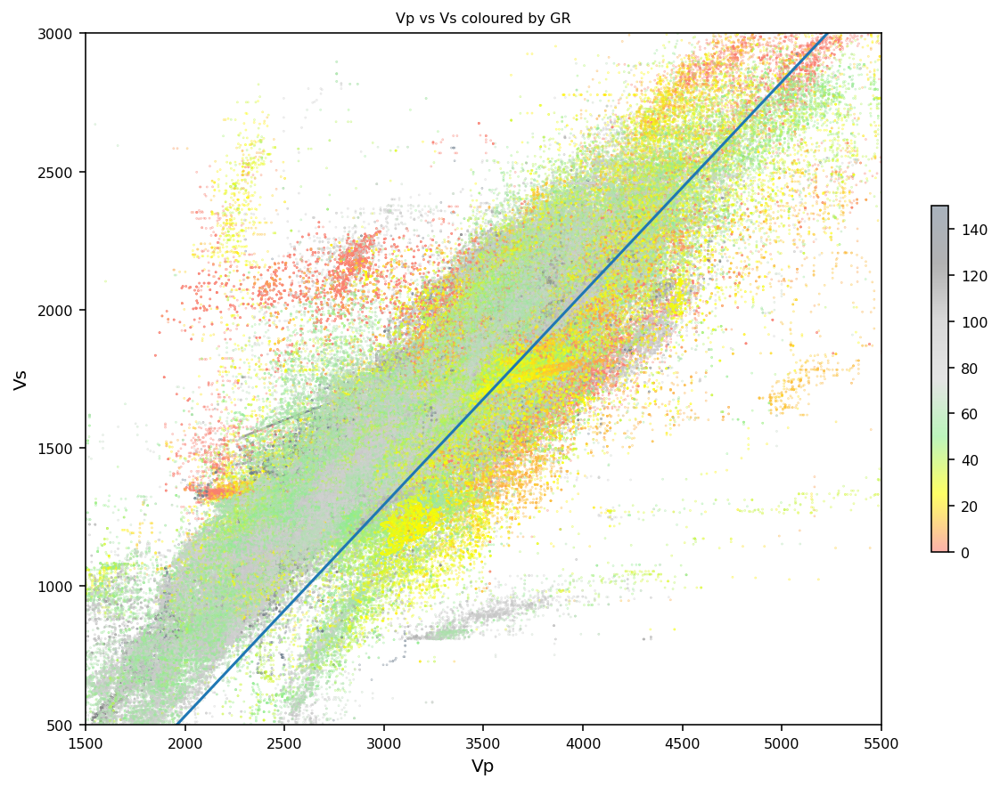

In [88]:
plt.scatter(data.Vp[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.Vs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.6, vmin=0, vmax=150)
plt.xlim(1500,5500)
plt.ylim(500,3000)
plt.xlabel('Vp')
plt.ylabel('Vs')
plt.colorbar(shrink=0.5)
plt.plot(lineVp,lineVs)
plt.title('Vp vs Vs coloured by GR');

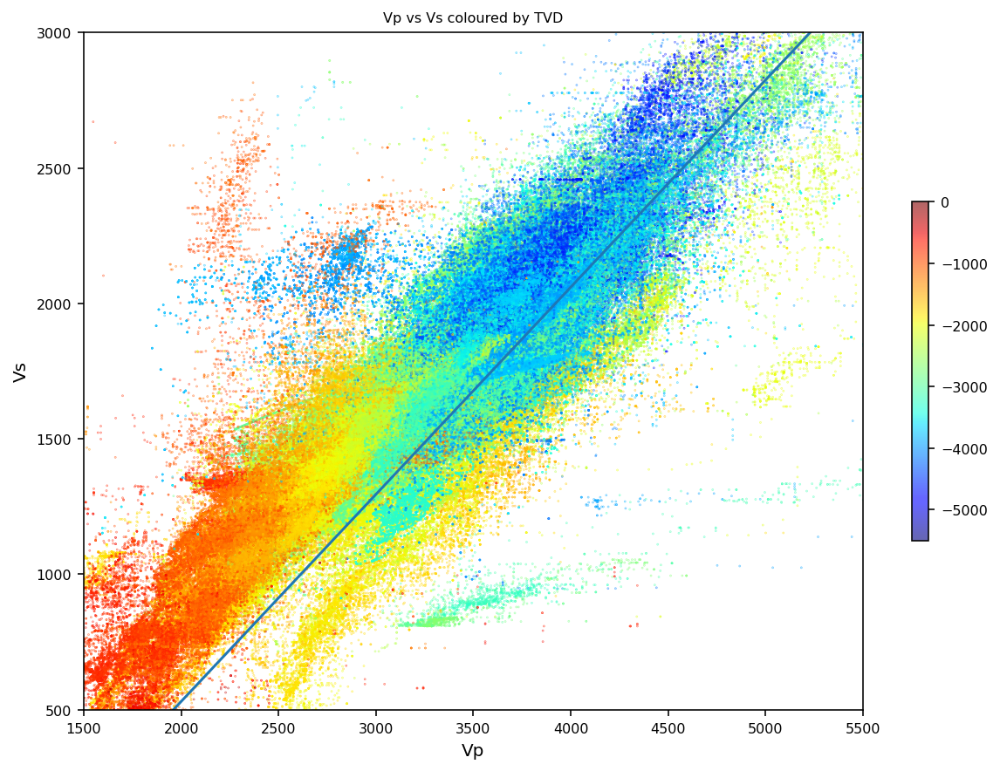

In [89]:
plt.scatter(data.Vp[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.Vs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.TVD[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='jet',s=0.1, alpha=0.6, vmin=DPmin, vmax=DPmax)
plt.xlim(1500,5500)
plt.ylim(500,3000)
plt.xlabel('Vp')
plt.ylabel('Vs')
plt.colorbar(shrink=0.5)
plt.plot(lineVp,lineVs)
plt.title('Vp vs Vs coloured by TVD');

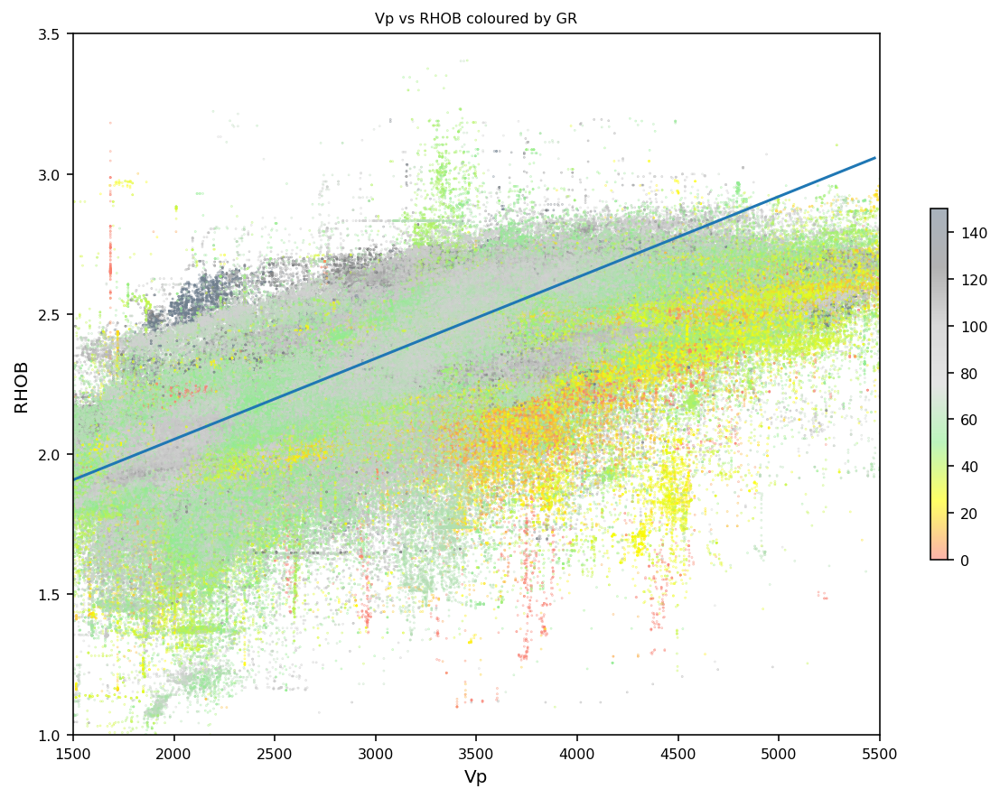

In [90]:
plt.scatter(data.Vp[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.RHOB[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.6, vmin=0, vmax=150)
plt.xlim(1500,5500)
plt.ylim(1,3.5)
plt.xlabel('Vp')
plt.ylabel('RHOB')
plt.colorbar(shrink=0.5)
plt.plot(lineVp,lineRHOB)
plt.title('Vp vs RHOB coloured by GR');

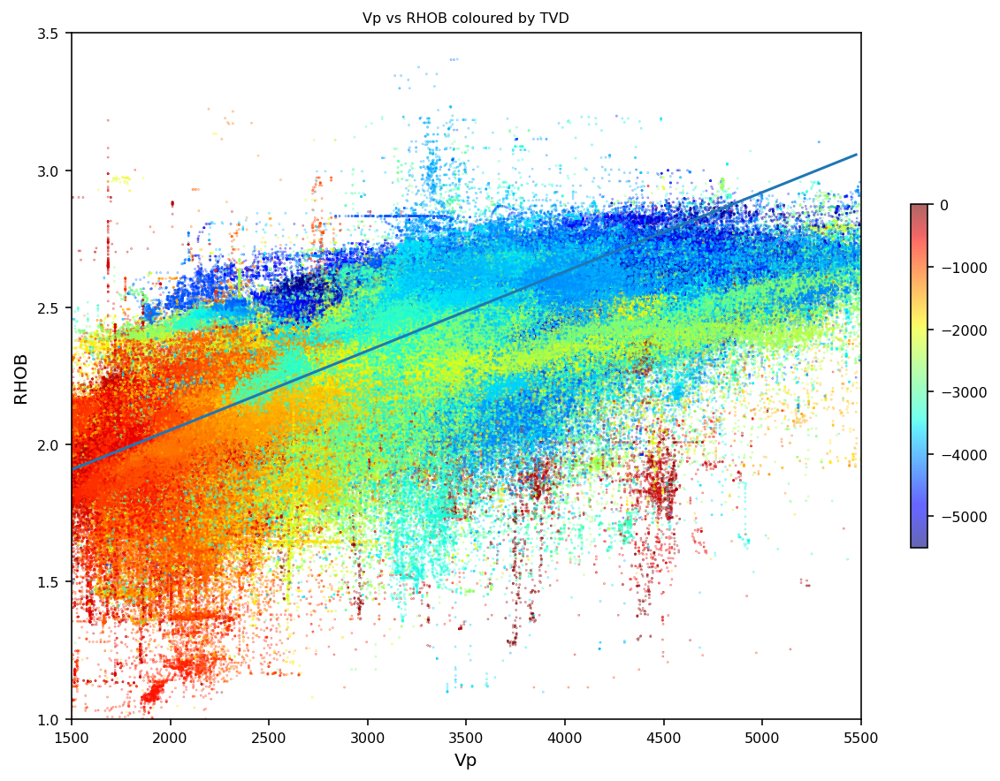

In [91]:
plt.scatter(data.Vp[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.RHOB[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.TVD[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='jet',s=0.1, alpha=0.6, vmin=DPmin, vmax=DPmax)
plt.xlim(1500,5500)
plt.ylim(1,3.5)
plt.xlabel('Vp')
plt.ylabel('RHOB')
plt.colorbar(shrink=0.5)
plt.plot(lineVp,lineRHOB)
plt.title('Vp vs RHOB coloured by TVD');

Determine the Bulk Modules (K) for porosity from 0-0.5

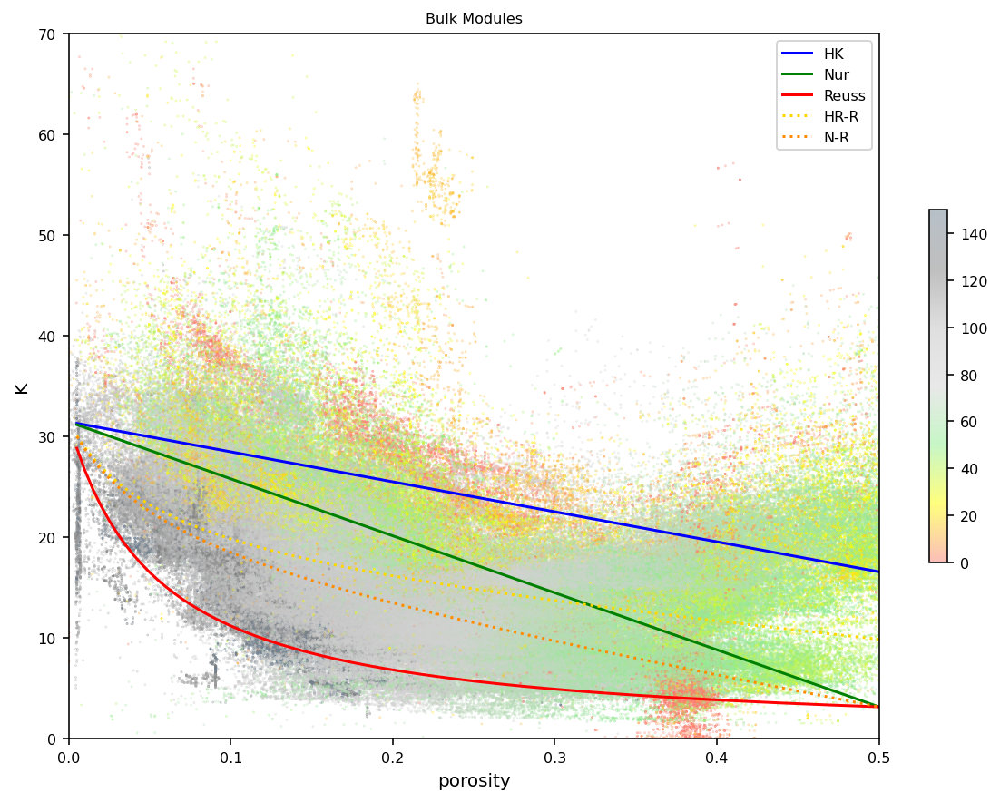

In [92]:
Kdry = Kmineral * ((1 - porosity)/1)
Knur = Kmineral * ((CriticalPorosity - porosity)/CriticalPorosity)
M = (Kdry)/(Kmineral-Kdry)+Kfluid/(porosity*(Kmineral-Kfluid))
Mnur = (Knur)/(Kmineral-Knur)+Kfluid/(porosity*(Kmineral-Kfluid))
Kwet = Kmineral*M/(1+M)
Knur = Kmineral*Mnur/(1+Mnur)
Kreuss = 1/(porosity/Kfluid+(1-porosity)/Kmineral)
Vfactor = 0.5

Kvernik = Kwet*Vfactor + Kreuss*(1-Vfactor)
KverNur = Knur*Vfactor + Kreuss*(1-Vfactor)
plt.title('Bulk Modules')
plt.xlabel('porosity')
plt.ylabel('K')
plt.xlim(0,0.5)
plt.ylim(0,70)

plt.scatter(data.EPOR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.K[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)

plt.plot(porosity,Kwet,c='blue', label='HK')
plt.plot(porosity,Knur,c='green', label='Nur')
plt.plot(porosity,Kreuss,c='red', label= 'Reuss');
plt.plot(porosity,Kvernik,c='gold', label='HR-R',linestyle='dotted')
plt.plot(porosity,KverNur,c='darkorange', label='N-R',linestyle='dotted')
#plt.plot(linePOR,lineK,c='purple', label='Linear')
plt.colorbar(shrink=0.5)
plt.legend();

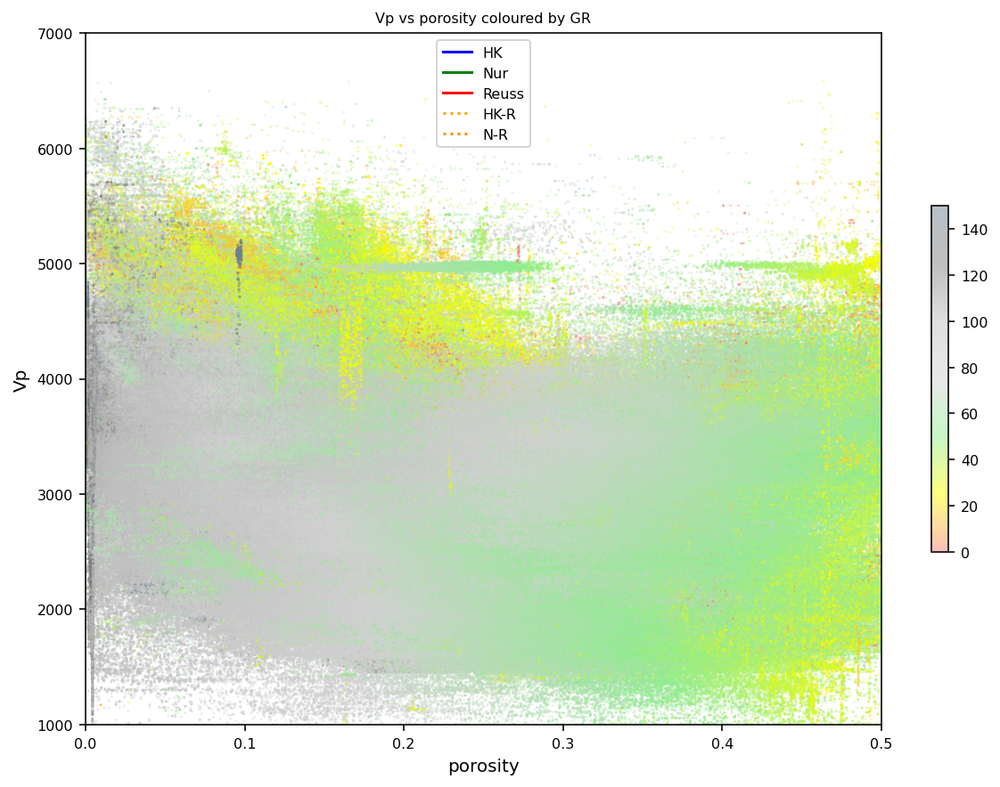

In [93]:
PoissonPFluid = 0.5
Poisson = PoissonRatio*((CriticalPorosity-porosity)/CriticalPorosity)+PoissonPFluid*porosity/CriticalPorosity
Plist = [max(min(x, 0.5), 0) for x in Poisson]
Poisson = np.array(Plist)

Mu =3*Kdry/2*(1-2*Poisson)/(1+Poisson)
Vp_HK = np.sqrt((Kwet+4/3*Mu)/Rdensity)*1000
Vp_nur = np.sqrt((Knur+4/3*Mu)/Rdensity)*1000
Vp_vernik = np.sqrt((Kvernik+4/3*Mu)/Rdensity)*1000
Vp_verNur = np.sqrt((KverNur+4/3*Mu)/Rdensity)*1000
Vp_reuss = np.sqrt((Kreuss+4/3*Mu)/Rdensity)*1000

plt.scatter(data.EPOR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.Vp[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)
plt.title('Vp vs porosity coloured by GR')
plt.xlabel('porosity')
plt.ylabel('Vp')
plt.xlim(0,0.5)
plt.ylim(1000,7000)
plt.plot(porosity,Vp_HK,c='blue',label='HK')
plt.plot(porosity,Vp_nur,c='green',label='Nur')
plt.plot(porosity,Vp_reuss,c='red',label='Reuss')
plt.plot(porosity,Vp_vernik,c='orange',label='HK-R',linestyle='dotted')
plt.plot(porosity,Vp_verNur,c='darkorange',label='N-R',linestyle='dotted')
plt.colorbar(shrink=0.5)
plt.legend();

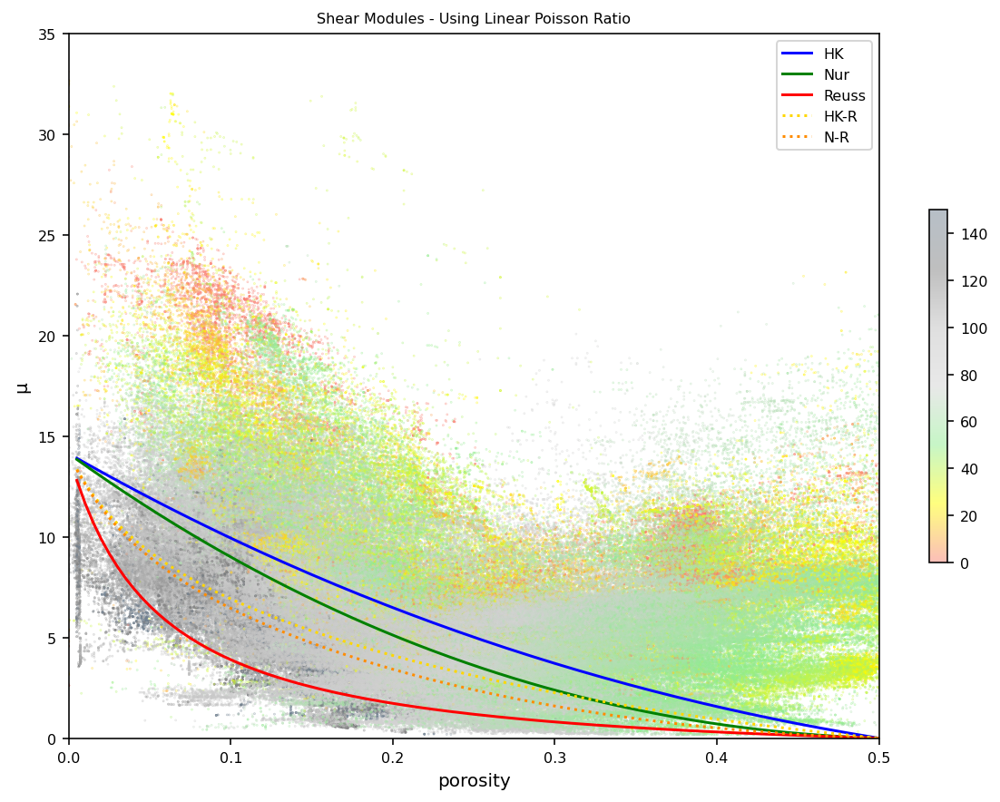

In [94]:
Smodules_wet =3*Kwet/2*(1-2*Poisson)/(1+Poisson)
Smodules_nur =3*Knur/2*(1-2*Poisson)/(1+Poisson)
Smodules_vernik =3*Kvernik/2*(1-2*Poisson)/(1+Poisson)
Smodules_verNur =3*KverNur/2*(1-2*Poisson)/(1+Poisson)
Smodules_reuss =3*Kreuss/2*(1-2*Poisson)/(1+Poisson)

plt.scatter(data.EPOR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.SM[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)
plt.title('Shear Modules - Using Linear Poisson Ratio')
plt.xlabel('porosity')
plt.ylabel('\u03BC')
plt.xlim(0,0.5)
plt.ylim(0,35)
plt.plot(porosity,Smodules_wet,c='blue',label='HK')
plt.plot(porosity,Smodules_nur,c='green',label='Nur')
plt.plot(porosity,Smodules_reuss,c='red',label='Reuss')
plt.plot(porosity,Smodules_vernik,c='gold',label='HK-R',linestyle='dotted')
plt.plot(porosity,Smodules_verNur,c='darkorange',label='N-R',linestyle='dotted')
plt.colorbar(shrink=0.5)
plt.legend();

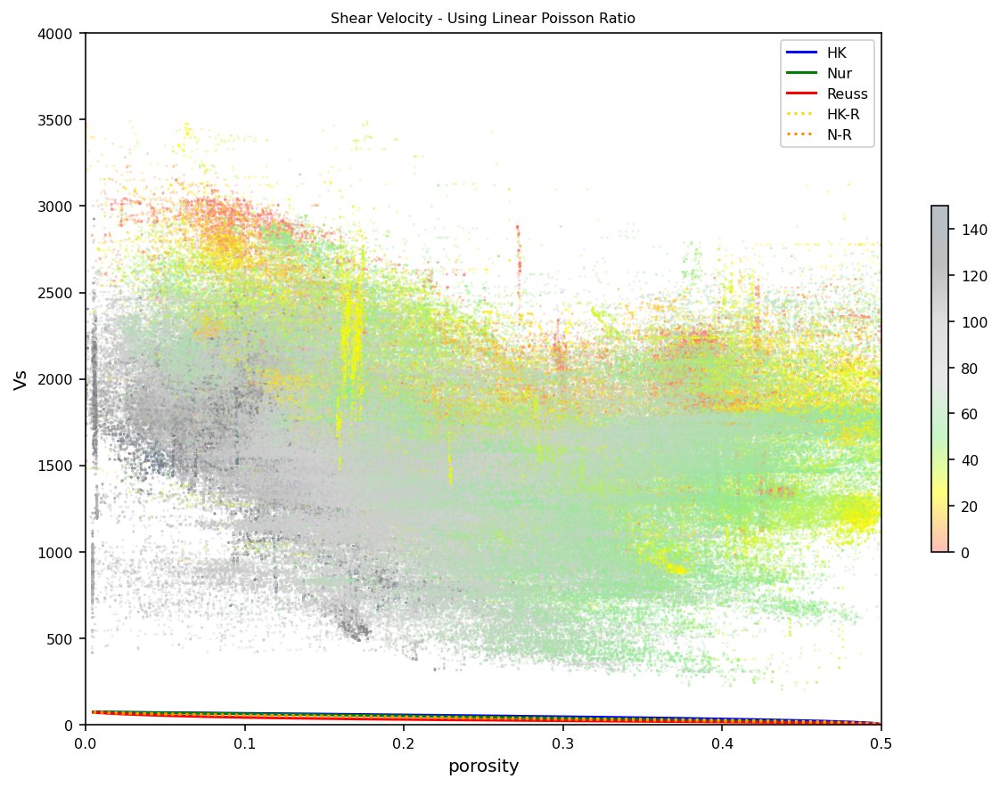

In [95]:
Vs_HK = 1000*np.sqrt(Smodules_wet/Rdensity)
Vs_nur = 1000*np.sqrt(Smodules_nur/Rdensity)
Vs_vernik = 1000*np.sqrt(Smodules_vernik/Rdensity)
Vs_verNur = 1000*np.sqrt(Smodules_verNur/Rdensity)
Vs_reuss =1000*np.sqrt(Smodules_reuss/Rdensity)

plt.scatter(data.EPOR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.Vs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)

plt.title('Shear Velocity - Using Linear Poisson Ratio')
plt.xlabel('porosity')
plt.ylabel('Vs')
plt.xlim(0,0.5)
plt.ylim(0,4000)
plt.plot(porosity,Vs_HK,c='blue', label='HK')
plt.plot(porosity,Vs_nur,c='green', label='Nur')
plt.plot(porosity,Vs_reuss,c='red',label='Reuss')
plt.plot(porosity,Vs_vernik,c='gold', label='HK-R',linestyle='dotted')
plt.plot(porosity,Vs_verNur,c='darkorange',label='N-R',linestyle='dotted')
plt.colorbar(shrink=0.5)
plt.legend();

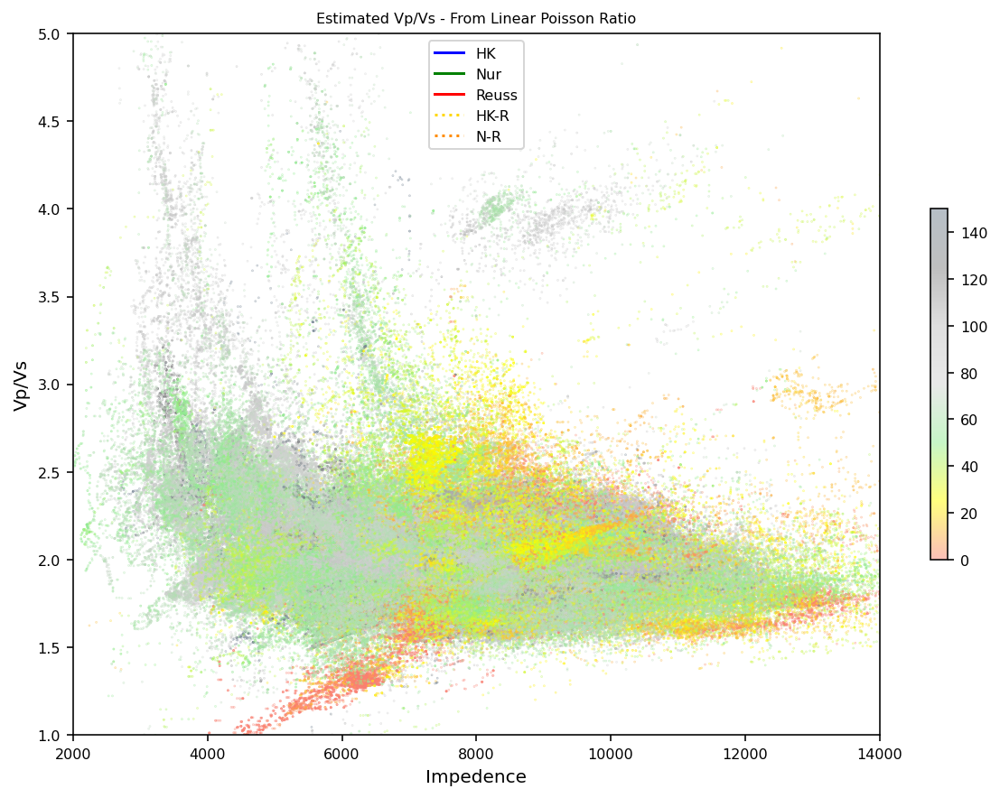

In [96]:
from typing_extensions import NoReturn
VpVs_HK = Vp_HK/Vs_HK
Ip_HK = Vp_HK*Rdensity
VpVs_nur = Vp_nur/Vs_nur
Ip_nur = Vp_nur*Rdensity
VpVs_vernik = Vp_vernik/Vs_vernik
Ip_vernik = Vp_vernik*Rdensity
VpVs_verNur = Vp_verNur/Vs_verNur
Ip_verNur = Vp_verNur*Rdensity
VpVs_reuss = Vp_reuss/Vs_reuss
Ip_reuss = Vp_reuss*Rdensity

plt.scatter(data.Ip[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.VpVs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)

plt.title('Estimated Vp/Vs - From Linear Poisson Ratio')
plt.xlabel('Impedence')
plt.ylabel('Vp/Vs')
plt.xlim(2000,14000)
plt.ylim(1,5)
plt.plot(Ip_HK,VpVs_HK,c='blue',label="HK")
plt.plot(Ip_nur,VpVs_nur,c='green',label='Nur')
plt.plot(Ip_reuss,VpVs_reuss,c='red',label='Reuss')
plt.plot(Ip_vernik,VpVs_vernik,c='gold',label='HK-R',linestyle='dotted')
plt.plot(Ip_verNur,VpVs_verNur,c='darkorange',label='N-R',linestyle='dotted')
plt.colorbar(shrink=0.5)
plt.legend();

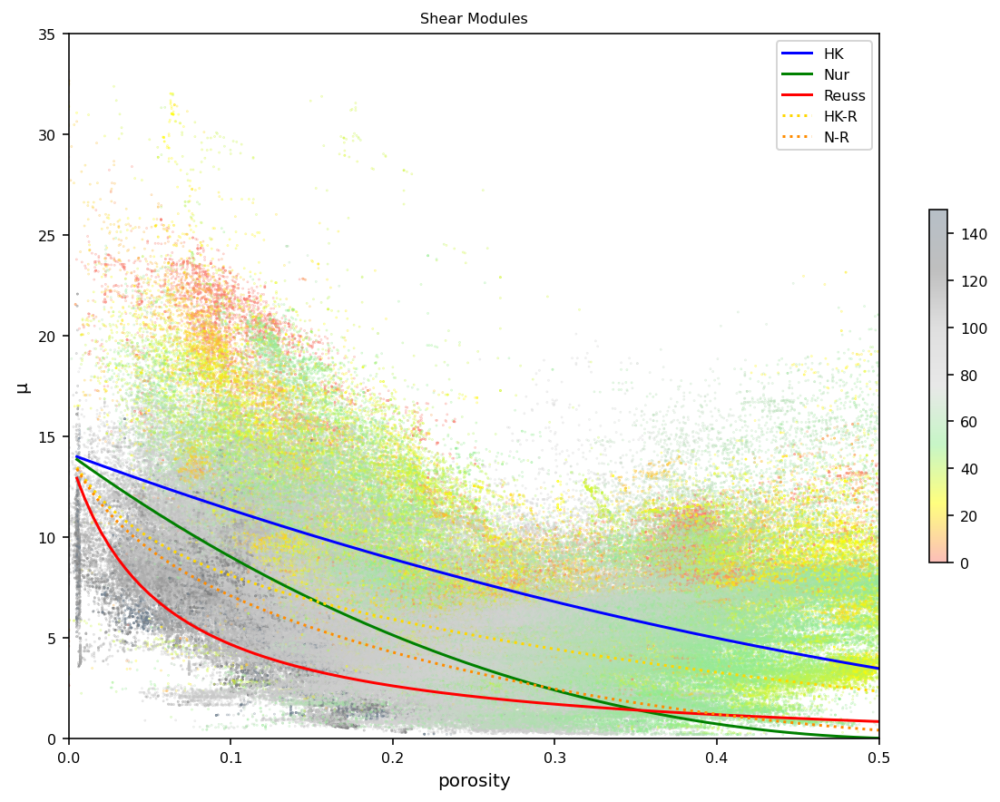

In [97]:
PoissonPFluid = 0.5
CPorosity = CriticalPorosity
Poisson1 = PoissonRatio*((CPorosity-porosity)/CPorosity)+PoissonPFluid*porosity/CPorosity
Plist = [max(min(x, 0.5), 0) for x in Poisson1]
Poisson1 = np.array(Plist)

Smodules_nur = 3*Knur/2*(1-2*Poisson1)/(1+Poisson1)

PoissonPFluid = 0.5
CPorosity = 1.0
Poisson2 = PoissonRatio*((CPorosity-porosity)/CPorosity)+PoissonPFluid*porosity/CPorosity
Plist = [max(min(x, 0.5), 0) for x in Poisson2]
Poisson2 = np.array(Plist)
Smodules_wet =3*Kwet/2*(1-2*Poisson2)/(1+Poisson2)

Poisson3 = 1/(porosity/PoissonPFluid+(1-porosity)/PoissonRatio)
Plist = [max(min(x, 0.5), 0) for x in Poisson3]
Poisson3 = np.array(Plist)
Smodules_reuss =3*Kreuss/2*(1-2*Poisson3)/(1+Poisson3)


Poisson4 = (Poisson1 + Poisson3)/2
Plist = [max(min(x, 0.5), 0) for x in Poisson4]
Poisson4 = np.array(Plist)
Smodules_verNur =3*KverNur/2*(1-2*Poisson4)/(1+Poisson4)

Poisson5 = (Poisson2 + Poisson3)/2
Plist = [max(min(x, 0.5), 0) for x in Poisson5]
Poisson5 = np.array(Plist)
Smodules_vernik =3*Kvernik/2*(1-2*Poisson5)/(1+Poisson5)

plt.scatter(data.EPOR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.SM[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)

plt.title('Shear Modules')
plt.xlabel('porosity')
plt.ylabel('\u03BC')
plt.xlim(0,0.5)
plt.ylim(0,35)
plt.plot(porosity,Smodules_wet,c='blue',label="HK")
plt.plot(porosity,Smodules_nur,c='green',label='Nur')
plt.plot(porosity,Smodules_reuss,c='red',label='Reuss')
plt.plot(porosity,Smodules_vernik,c='gold',label='HK-R',linestyle='dotted')
plt.plot(porosity,Smodules_verNur,c='darkorange',label='N-R',linestyle='dotted')
plt.colorbar(shrink=0.5)
plt.legend();

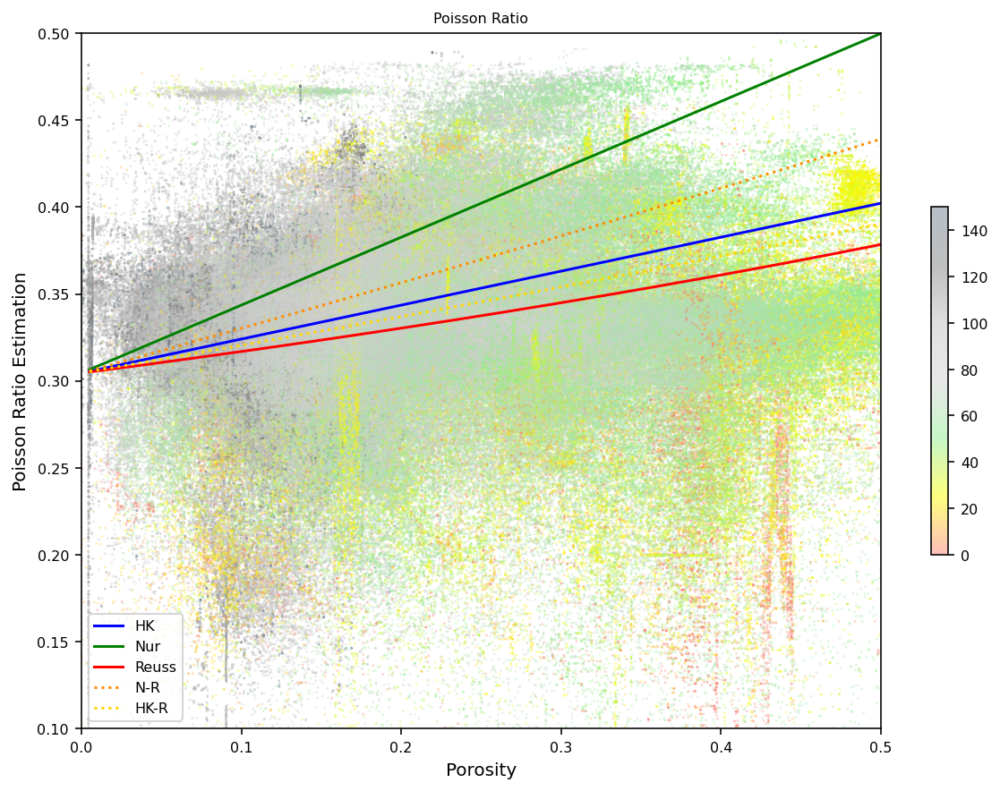

In [98]:
plt.scatter(data.EPOR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.PR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)

plt.title('Poisson Ratio')
plt.xlabel('Porosity')
plt.ylabel('Poisson Ratio Estimation')
plt.xlim(0,0.5)
plt.ylim(0.1,0.5)
plt.plot(porosity,Poisson2,c='blue',label='HK')
plt.plot(porosity,Poisson1,c='green',label='Nur')
plt.plot(porosity,Poisson3,c='red',label='Reuss')
plt.plot(porosity,Poisson4,c='darkorange',label='N-R',linestyle='dotted')
plt.plot(porosity,Poisson5,c='gold',label='HK-R',linestyle='dotted')
plt.colorbar(shrink=0.5)
plt.legend();

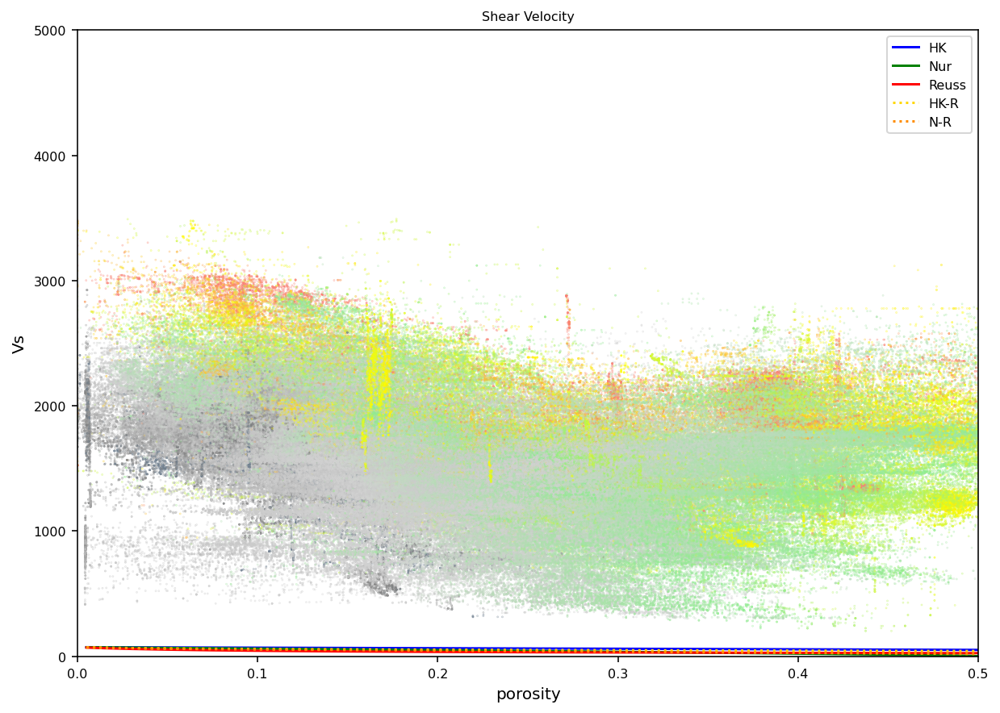

In [99]:
Vs_HK = 1000*np.sqrt(Smodules_wet/Rdensity)
Vs_nur = 1000*np.sqrt(Smodules_nur/Rdensity)
Vs_vernik = 1000*np.sqrt(Smodules_vernik/Rdensity)
Vs_verNur = 1000*np.sqrt(Smodules_verNur/Rdensity)
Vs_reuss =1000*np.sqrt(Smodules_reuss/Rdensity)

plt.scatter(data.EPOR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.Vs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)

plt.title('Shear Velocity')
plt.xlabel('porosity')
plt.ylabel('Vs')
plt.xlim(0,0.5)
plt.ylim(0,5000)

plt.plot(porosity,Vs_HK,c='blue',label="HK")
plt.plot(porosity,Vs_nur,c='green',label='Nur')
plt.plot(porosity,Vs_reuss,c='red',label='Reuss')
plt.plot(porosity,Vs_vernik,c='gold',label='HK-R',linestyle='dotted')
plt.plot(porosity,Vs_verNur,c='darkorange',label='N-R',linestyle='dotted')

plt.legend();

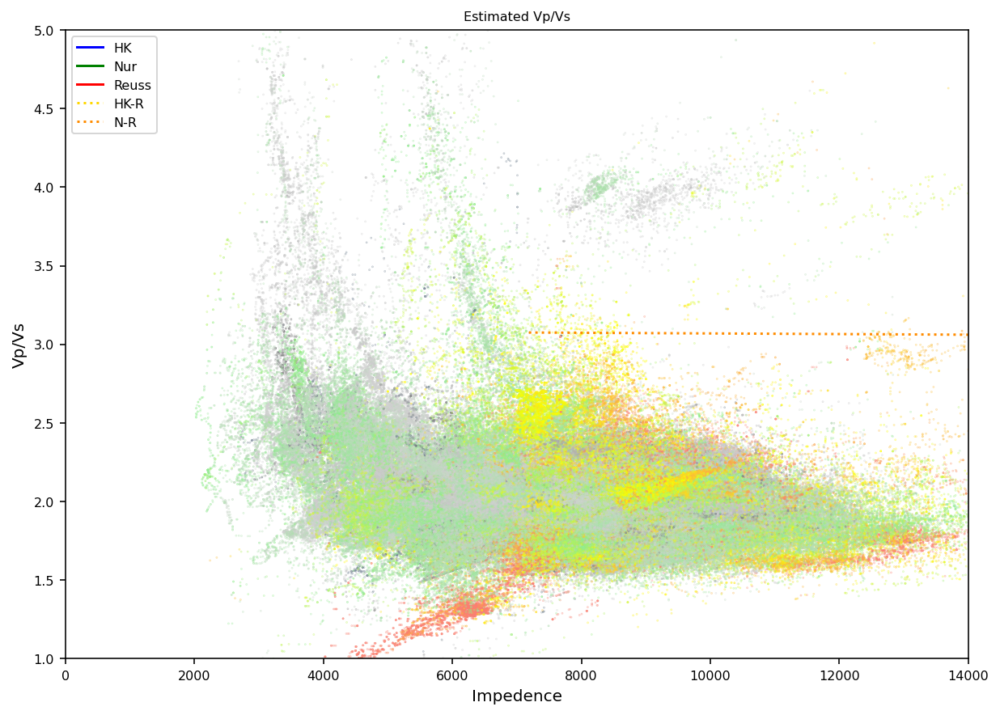

In [100]:

VpVs_HK = Vp_HK/Vs_HK
Ip_HK = Vp_HK*Rdensity
VpVs_nur = Vp_nur/Vs_nur
Ip_nur = Vp_nur*Rdensity
VpVs_vernik = Vp_vernik/Vs_vernik
Ip_vernik = Vp_vernik*Rdensity
VpVs_verNur = Vp_verNur/Vs_verNur
Ip_verNur = Vp_verNur*Rdensity
VpVs_reuss = Vp_reuss/Vs_reuss
Ip_reuss = Vp_reuss*Rdensity

plt.scatter(data.Ip[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            data.VpVs[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            c=data.GR[(data['MINERAL_PRED'] >= Lith1) & (data['MINERAL_PRED'] <= Lith2)& (data.TVD >= DPmin)& (data.TVD <= DPmax)],
            cmap='gr_color',s=0.1, alpha=0.5, vmin=0, vmax=150)

plt.title('Estimated Vp/Vs')
plt.xlabel('Impedence')
plt.ylabel('Vp/Vs')
plt.xlim(00,14000)
plt.ylim(1,5)

plt.plot(Ip_HK,VpVs_HK,c='blue',label='HK')
plt.plot(Ip_nur,VpVs_nur,c='green',label='Nur')
plt.plot(Ip_reuss,VpVs_reuss,c='red',label='Reuss')
plt.plot(Ip_vernik,VpVs_vernik,c='gold',label='HK-R',linestyle="dotted")
plt.plot(Ip_verNur,VpVs_verNur,c='darkorange',label='N-R',linestyle="dotted")

plt.legend();